# Image classification with a Quantized MLP


------------------------------------------------------
*Jacob Carulli jacob.carulli@tufts.edu*

*Drew Cohen acohen24@tufts.edu*

------------------------------------------------------


In this notebook, we will implement an image classifier using MLPs. We will use the MNIST dataset, which consists of greyscale handwritten digits. Each image is 28x28 pixels, you can see a sample below

In [2]:
from IPython.display import Image
from IPython.core.display import HTML

Image(url= "https://upload.wikimedia.org/wikipedia/commons/2/27/MnistExamples.png", width=400, height=200)

Our goal is to build a neural network that can take one of these images and predict the digit in the image.

Note: a big part of the following material is a personal wrap-up of [Facebook's Deep Learning Course in Udacity](https://www.udacity.com/course/deep-learning-pytorch--ud188). So all credit goes for them!!

In [3]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'  #To get figures with high quality!

import numpy as np
import torch
from torch import nn
from torch import optim
import matplotlib.pyplot as plt

## Part I. Download MNIST with `torchvision`

First up, we need to get our dataset. This is provided through the `torchvision` package. The [torchvision package](https://pytorch.org/docs/stable/torchvision/index.html) consists of popular datasets, model architectures, and common image transformations for computer vision.


The code below will download the MNIST dataset, then create training and test datasets for us. Don't worry too much about the details here, you'll learn more about this later.

In [16]:
import torch
from torchvision import datasets, transforms
from torch.utils.data import random_split, DataLoader

# Define a thresholding function
def binarize(image, threshold=0.5):
    return (image > threshold).float()  # Convert to 1 if above threshold, else 0

# Define a function to invert image pixels
def invert(image):
    return 1 - image  # Invert pixel values

# Define a transform to normalize the data
transform = transforms.Compose([
    transforms.Resize((18, 24)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
    transforms.Lambda(invert)  # Invert all pixel values to match scheme of .bmp images
])

# Download and load the full training dataset
full_trainset = datasets.MNIST('~/.pytorch/MNIST_data/', download=True, train=True, transform=transform)

# Split the training data into a smaller training set (80%) and a validation set (20%)
train_size = int(0.8 * len(full_trainset))  # 80% for training
val_size = len(full_trainset) - train_size  # 20% for validation
trainset, valset = random_split(full_trainset, [train_size, val_size])

# Create data loaders
trainloader = DataLoader(trainset, batch_size=64, shuffle=True)
valloader = DataLoader(valset, batch_size=64, shuffle=True)

# Download and load the test dataset
testset = datasets.MNIST('~/.pytorch/MNIST_data/', download=True, train=False, transform=transform)
testloader = DataLoader(testset, batch_size=64, shuffle=True)

# Print dataset sizes to verify
print(f"Training Set: {len(trainset)} samples")
print(f"Validation Set: {len(valset)} samples")
print(f"Test Set: {len(testset)} samples")


Training Set: 48000 samples
Validation Set: 12000 samples
Test Set: 10000 samples


We have the training data loaded into `trainloader` and we make that an iterator with `iter(trainloader)`. Later, we'll use this to loop through the dataset for training, like

```python
for image, label in trainloader:
    ## do things with images and labels
```

You'll notice I created the `trainloader` with a batch size of 64, and `shuffle=True`. The batch size is the number of images we get in one iteration from the data loader and pass through our network, often called a *batch*. And `shuffle=True` tells it to **shuffle the dataset every time we start going through the data loader again**. But here I'm just grabbing the first batch so we can check out the data. We can see below that `images` is just a tensor with size `(64, 1, 28, 28)`. So, 64 images per batch, **1 color channel**, and 28x28 images.

In [17]:
dataiter = iter(trainloader)   #To iterate through the dataset

images, labels = next(dataiter)
print(type(images))
print(images.shape)
print(labels.shape)


<class 'torch.Tensor'>
torch.Size([64, 1, 18, 24])
torch.Size([64])


This is what one of the images looks like.

tensor(2)


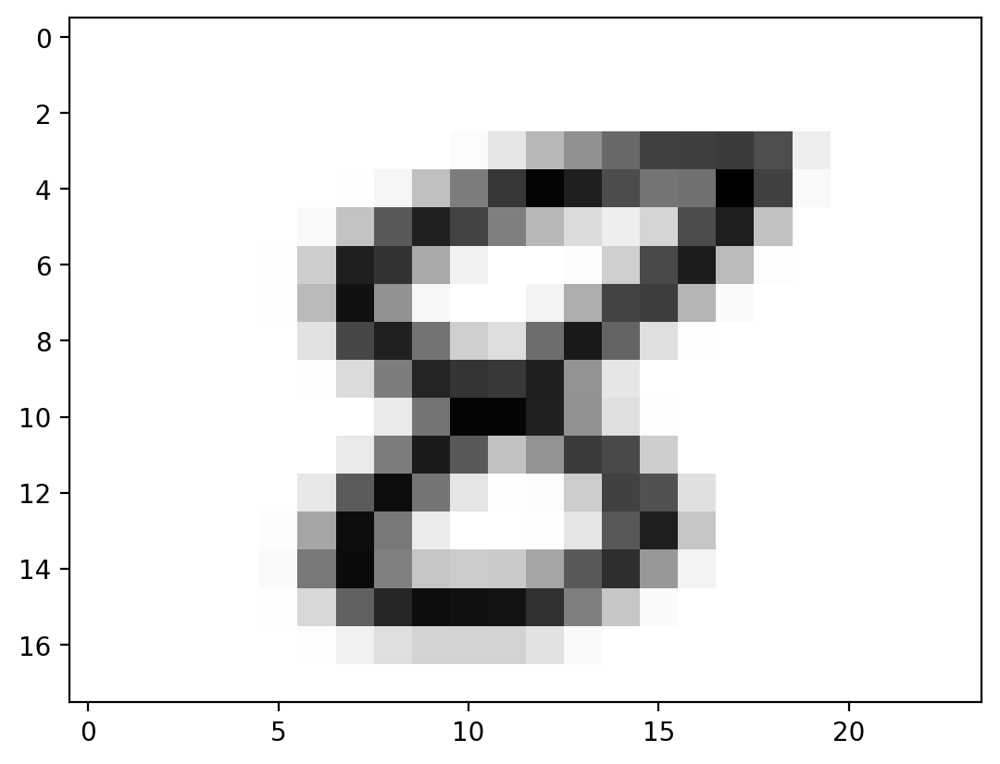

In [18]:
plt.imshow(images[36].numpy().reshape([18,24]), cmap='grey')
print(labels[0])

## Part II. Train a MLP for Image Classification

In [7]:
Image(url= "https://pytorch.org/docs/stable/_images/ReLU.png", width=300, height=100)

Here, we create a small class defining the model and then a larger class than inherites from it to incorporate methods to perform both training and model evaluation.

In [19]:
class MLP(nn.Module):
    def __init__(self,dimx,hidden1,hidden2,nlabels): #Nlabels will be 10 in our case
        super().__init__()

        self.output1 = nn.Linear(dimx,hidden1)

        self.output2 = nn.Linear(hidden1,hidden2)

        self.output3 = nn.Linear(hidden2,nlabels)

        self.relu = nn.ReLU()

        self.logsoftmax = nn.LogSoftmax(dim=1)

    def forward(self, x):
        # Pass the input tensor through each of our operations
        x = self.output1(x)
        x = self.relu(x)
        x = self.output2(x)
        x = self.relu(x)
        x = self.output3(x)
        x = self.logsoftmax(x) #YOUR CODE HERE
        return x

Now, we create a class `MLP_extended` that incorporates two methods to the former class. One to perform training and one to perform model evaluation.

In [86]:
''' This class inherits from the `Multi_LR` class. So it has the same atributes
and methods, and some others that we will add.
'''
class MLP_extended(MLP):

    #Your code here

    def __init__(self,dimx,hidden1,hidden2,nlabels,epochs=100,lr=0.001):

        super().__init__(dimx,hidden1,hidden2,nlabels)  #To initialize `MLP`!

        self.lr = lr #Learning Rate

        self.optim = optim.Adam(self.parameters(), self.lr)

        self.epochs = epochs

        self.criterion = nn.NLLLoss()

        # A list to store the loss evolution along training

        self.loss_during_training = []

    def train(self,trainloader):

        # Optimization Loop

        for e in range(int(self.epochs)):

            # Random data permutation at each epoch

            running_loss = 0.

            for images, labels in trainloader:              # NEW w.r.t Lab 1

                self.optim.zero_grad()  #TO RESET GRADIENTS!


                out = self.forward(images.view(images.shape[0], -1))

                #Your code here
                loss = self.criterion(out,labels)

                running_loss += loss.item()

                #Your code here
                loss.backward()

                #Your code here
                self.optim.step()


            self.loss_during_training.append(running_loss/len(trainloader))

            if(e % 1 == 0): # Every 10 epochs

                print("Training loss after %d epochs: %f"
                      %(e,self.loss_during_training[-1]))


    def eval_performance(self,dataloader):

        loss = 0
        accuracy = 0

        # Turn off gradients for validation, saves memory and computations
        with torch.no_grad():

            for images,labels in dataloader:

                logprobs = self.forward(images.view(images.shape[0], -1))

                top_p, top_class = logprobs.topk(1, dim=1)
                equals = (top_class == labels.view(images.shape[0], 1))
                accuracy += torch.mean(equals.type(torch.FloatTensor))

            return accuracy/len(dataloader)

In [87]:
# NEW FOR HALVING MODEL -- not great bc we see numerical instability with float16

''' This class inherits from the `Multi_LR` class. So it has the same atributes
and methods, and some others that we will add.
'''
class MLP_extended(MLP):

    #Your code here

    def __init__(self,dimx,hidden1,hidden2,nlabels,epochs=100,lr=0.001):

        super().__init__(dimx,hidden1,hidden2,nlabels)  #To initialize `MLP`!

        self.lr = lr #Learning Rate

        self.optim = optim.Adam(self.parameters(), self.lr)

        self.epochs = epochs

        self.criterion = nn.NLLLoss()

        # A list to store the loss evolution along training

        self.loss_during_training = []

    def train(self, trainloader):
        self = self.half()  # Convert model weights to float16

        for e in range(int(self.epochs)):
            running_loss = 0.

            for images, labels in trainloader:
                images = images.half()  # Convert inputs to float16
                labels = labels.long()  # Ensure labels are int64 for loss function

                self.optim.zero_grad()

                out = self.forward(images.view(images.shape[0], -1))
                loss = self.criterion(out, labels)

                if torch.isnan(loss):  # Debugging: Check for NaN loss
                    print("NaN detected in loss! Skipping step...")
                    continue  # Skip this batch

                running_loss += loss.item()

                loss.backward()

                # 🔹 Clip gradients to prevent instability
                torch.nn.utils.clip_grad_norm_(self.parameters(), max_norm=1.0)

                self.optim.step()

            self.loss_during_training.append(running_loss / len(trainloader))

            print(f"Training loss after {e} epochs: {self.loss_during_training[-1]:.6f}")


    def eval_performance(self, dataloader):
        loss = 0
        accuracy = 0

        # Turn off gradients for validation, saves memory and computations
        with torch.no_grad():
            for images, labels in dataloader:
                images = images.half()  # Convert input images to float16
                labels = labels.long()  # Ensure labels are int64

                logprobs = self.forward(images.view(images.shape[0], -1))

                top_p, top_class = logprobs.topk(1, dim=1)
                equals = (top_class == labels.view(images.shape[0], 1))

                accuracy += torch.mean(equals.type(torch.FloatTensor))

        return accuracy / len(dataloader)


In [16]:
# SECOND ATTEMPT AT HALVING MODEL -- using bfloat16 instead of float16

''' This class inherits from the `Multi_LR` class. So it has the same atributes
and methods, and some others that we will add.
'''
class MLP_extended(MLP):

    #Your code here

    def __init__(self,dimx,hidden1,hidden2,nlabels,epochs=100,lr=0.001):

        super().__init__(dimx,hidden1,hidden2,nlabels)  #To initialize `MLP`!

        self.lr = lr #Learning Rate

        self.optim = optim.Adam(self.parameters(), self.lr)

        self.epochs = epochs

        self.criterion = nn.NLLLoss()

        # A list to store the loss evolution along training

        self.loss_during_training = []

    def train(self, trainloader):
        self = self.to(dtype=torch.bfloat16)  # Convert model weights to bfloat16

        for e in range(int(self.epochs)):
            running_loss = 0.

            for images, labels in trainloader:
                images = images.to(dtype=torch.bfloat16)  # Convert inputs to bfloat16
                labels = labels.long()  # Ensure labels are int64 for loss function

                self.optim.zero_grad()

                out = self.forward(images.view(images.shape[0], -1))
                loss = self.criterion(out, labels)

                if torch.isnan(loss):  # Debugging: Check for NaN loss
                    print("NaN detected in loss! Skipping step...")
                    continue  # Skip this batch

                running_loss += loss.item()

                loss.backward()

                # 🔹 Clip gradients to prevent instability
                torch.nn.utils.clip_grad_norm_(self.parameters(), max_norm=1.0)

                self.optim.step()

            self.loss_during_training.append(running_loss / len(trainloader))

            print(f"Training loss after {e} epochs: {self.loss_during_training[-1]:.6f}")



    def eval_performance(self, dataloader):
        accuracy = 0

        # Convert model to bfloat16
        self = self.to(dtype=torch.bfloat16)  # Convert model weights to bfloat16

        # Turn off gradients for validation, saves memory and computations
        with torch.no_grad():
            for images, labels in dataloader:
                images = images.to(dtype=torch.bfloat16)  # Convert input images to bfloat16
                labels = labels.long()  # Ensure labels are int64 for loss function

                logprobs = self.forward(images.view(images.shape[0], -1))

                top_p, top_class = logprobs.topk(1, dim=1)
                equals = (top_class == labels.view(images.shape[0], 1))

                accuracy += torch.mean(equals.type(torch.FloatTensor))

        return accuracy / len(dataloader)


In [ ]:
# Now initialize the model, prepare for quantization and train
my_MLP = MLP_extended(dimx=3072, hidden1=16, hidden2=8, nlabels=10, epochs=2, lr=1e-3)

# Train the model
quantized_model = my_MLP.train(trainloader)

# Evaluate the performance on train and test data
train_performance = my_MLP.eval_performance(trainloader)
test_performance = my_MLP.eval_performance(testloader)

print(f"Train Accuracy: {train_performance}")
print(f"Test Accuracy: {test_performance}")

In [ ]:
my_MLP = MLP_extended(dimx=3072,hidden1=16,hidden2=8,nlabels=10,epochs=0,lr=1e-3)

my_MLP.train(trainloader)

train_performance = my_MLP.eval_performance(trainloader)

test_performance = my_MLP.eval_performance(testloader)

print("Train Accuracy %f" %(train_performance))

print("Test Accuracy %f" %(test_performance))



Train Accuracy 0.099147
Test Accuracy 0.100717


In [116]:
# Print weights of quantized model
for name, param in my_MLP.named_parameters():
    if 'weight' in name:
        print(f"Layer: {name}, Weights: {param}")

Layer: output1.weight, Weights: Parameter containing:
tensor([[-0.0121, -0.0055, -0.0120,  ...,  0.0033, -0.0129,  0.0024],
        [ 0.0042, -0.0109,  0.0029,  ..., -0.0042,  0.0057,  0.0096],
        [ 0.0036, -0.0112, -0.0084,  ..., -0.0084, -0.0063,  0.0165],
        ...,
        [ 0.0099,  0.0030,  0.0164,  ..., -0.0095,  0.0083, -0.0025],
        [-0.0040,  0.0162,  0.0043,  ..., -0.0078, -0.0050,  0.0041],
        [-0.0165, -0.0066, -0.0140,  ...,  0.0138, -0.0095,  0.0031]],
       dtype=torch.bfloat16, requires_grad=True)
Layer: output2.weight, Weights: Parameter containing:
tensor([[-0.1934,  0.0150, -0.2100, -0.2012, -0.1660,  0.1641,  0.1396,  0.1094,
          0.1387,  0.0150,  0.2314, -0.2266,  0.1543, -0.0588, -0.1270,  0.2061],
        [-0.0518, -0.2461, -0.1953,  0.0537,  0.1475, -0.1484,  0.0688, -0.0312,
          0.0359,  0.0142,  0.0435, -0.0374,  0.0869, -0.1455,  0.0093,  0.2334],
        [-0.1123,  0.0698,  0.2197,  0.1895, -0.1348,  0.1128, -0.1128,  0.1089,
  

In [29]:
# Quantization for 8 bit weights

import torch
import torch.nn as nn
import torch.optim as optim
import torch.quantization as quant

# Ensure CPU usage
device = torch.device("cpu")

class QuantizedMLP(nn.Module):
    def __init__(self, dimx, hidden1, hidden2, nlabels, dropout_rate=0.5):
        super().__init__()

        self.quant = torch.quantization.QuantStub()
        self.layer1 = nn.Sequential(nn.Linear(dimx, hidden1), nn.ReLU(), nn.Dropout(p=dropout_rate))  # Dropout after ReLU
        self.layer2 = nn.Sequential(nn.Linear(hidden1, hidden2), nn.ReLU(), nn.Dropout(p=dropout_rate))
        self.layer3 = nn.Linear(hidden2, nlabels)  # No LogSoftmax here
        self.dequant = torch.quantization.DeQuantStub()

        self.qconfig = torch.quantization.get_default_qconfig('fbgemm')

    def forward(self, x):
        x = x.view(x.shape[0], -1)  # Flatten input
        x = self.quant(x)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.dequant(x)
        return torch.nn.functional.log_softmax(x, dim=1)  # LogSoftmax in FP32

class MLP_extended(nn.Module):
    def __init__(self, dimx, hidden1, hidden2, nlabels, epochs=100, lr=0.001, dropout_rate=0.5):
        super().__init__()
        self.model = QuantizedMLP(dimx, hidden1, hidden2, nlabels, dropout_rate).to(device)

        self.lr = lr
        self.optim = optim.Adam(self.model.parameters(), self.lr, weight_decay=0.0001)
        self.epochs = epochs
        self.criterion = nn.NLLLoss()

        # Prepare quantized model
        self.model.qconfig = torch.quantization.get_default_qconfig('fbgemm')
        torch.quantization.prepare(self.model, inplace=True)

    def train_with_quantization(self, trainloader, valloader):
        """Train the model with quantization awareness and compute validation loss per epoch."""
        print("Starting training with quantization awareness...")

        self.model.train()
        for epoch in range(self.epochs):
            running_loss = 0.0
            for images, labels in trainloader:
                images, labels = images.to(device), labels.to(device)

                self.optim.zero_grad()
                out = self.model(images)
                loss = self.criterion(out, labels)
                running_loss += loss.item()
                loss.backward()
                self.optim.step()

            # Compute validation loss
            val_loss = self.compute_validation_loss(valloader)

            print(f"Epoch {epoch+1}: Training Loss = {running_loss / len(trainloader):.4f}, Validation Loss = {val_loss:.4f}")

    def compute_validation_loss(self, valloader):
        """Compute validation loss without updating model parameters."""
        self.model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for images, labels in valloader:
                images, labels = images.to(device), labels.to(device)
                outputs = self.model(images)
                loss = self.criterion(outputs, labels)
                val_loss += loss.item()

        return val_loss / len(valloader)

    def quantize_model(self):
        """Convert the model to a fully quantized version."""
        self.model.eval()
        torch.quantization.convert(self.model, inplace=True)
        return self.model

    def evaluate(self, dataloader):
        """Evaluate the quantized model on a dataset."""
        self.model.eval()
        correct, total = 0, 0
        with torch.no_grad():
            for images, labels in dataloader:
                images, labels = images.to(device), labels.to(device)
                outputs = self.model(images)
                _, predicted = torch.max(outputs, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()

        accuracy = 100 * correct / total
        print(f"Accuracy: {accuracy:.2f}%")
        return accuracy

def train_and_evaluate_quantized_model(model, train_loader, val_loader, test_loader):
    """Train and evaluate model with 8-bit quantization."""
    model.train_with_quantization(train_loader, val_loader)

    print("\nConverting to quantized model...")
    quantized_model = model.quantize_model()

    print("\nEvaluating Quantized Model on Training Set:")
    train_accuracy = model.evaluate(train_loader)

    print("\nEvaluating Quantized Model on Validation Set:")
    val_accuracy = model.evaluate(val_loader)

    print("\nEvaluating Quantized Model on Test Set:")
    test_accuracy = model.evaluate(test_loader)

    return quantized_model, train_accuracy, val_accuracy, test_accuracy

In [30]:
# Instantiate the model
my_MLP = MLP_extended(dimx=432, hidden1=30, hidden2=16, nlabels=10, epochs=10, lr=1e-3, dropout_rate=0.1).to(device)

# Train and evaluate the quantized model, including validation set
quantized_model, train_acc, val_acc, test_acc = train_and_evaluate_quantized_model(
    model=my_MLP,
    train_loader=trainloader,
    val_loader=valloader,  # Pass validation loader
    test_loader=testloader
)

# Print final accuracies
print(f"\nFinal Training Accuracy: {train_acc:.2f}%")
print(f"Final Validation Accuracy: {val_acc:.2f}%")
print(f"Final Test Accuracy: {test_acc:.2f}%")


Starting training with quantization awareness...
Epoch 1: Training Loss = 1.1083, Validation Loss = 0.5572
Epoch 2: Training Loss = 0.4605, Validation Loss = 0.4064
Epoch 3: Training Loss = 0.3846, Validation Loss = 0.3502
Epoch 4: Training Loss = 0.3251, Validation Loss = 0.3752
Epoch 5: Training Loss = 0.2943, Validation Loss = 0.3303
Epoch 6: Training Loss = 0.2736, Validation Loss = 0.2531
Epoch 7: Training Loss = 0.2586, Validation Loss = 0.2582
Epoch 8: Training Loss = 0.2453, Validation Loss = 0.2335
Epoch 9: Training Loss = 0.2375, Validation Loss = 0.2296
Epoch 10: Training Loss = 0.2276, Validation Loss = 0.2184

Converting to quantized model...

Evaluating Quantized Model on Training Set:
Accuracy: 93.48%

Evaluating Quantized Model on Validation Set:
Accuracy: 93.28%

Evaluating Quantized Model on Test Set:
Accuracy: 93.50%

Final Training Accuracy: 93.48%
Final Validation Accuracy: 93.28%
Final Test Accuracy: 93.50%


In [ ]:
# run Gridsearch

import torch
import torch.nn as nn
import torch.optim as optim
import torch.quantization as quant
import itertools
from torch.utils.data import DataLoader, TensorDataset

device = torch.device("cpu")

class QuantizedMLP(nn.Module):
    def __init__(self, dimx, hidden1, hidden2, nlabels, dropout_rate=0.5):
        super().__init__()
        self.quant = quant.QuantStub()
        self.layer1 = nn.Sequential(nn.Linear(dimx, hidden1), nn.ReLU(), nn.Dropout(p=dropout_rate))
        self.layer2 = nn.Sequential(nn.Linear(hidden1, hidden2), nn.ReLU(), nn.Dropout(p=dropout_rate))
        self.layer3 = nn.Linear(hidden2, nlabels)
        self.dequant = quant.DeQuantStub()
        self.qconfig = quant.get_default_qconfig('fbgemm')

    def forward(self, x):
        x = x.view(x.shape[0], -1)
        x = self.quant(x)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.dequant(x)
        return torch.nn.functional.log_softmax(x, dim=1)

class MLP_extended(nn.Module):
    def __init__(self, dimx, hidden1, hidden2, nlabels, epochs=10, lr=0.001, dropout_rate=0.5, weight_decay=1e-4):
        super().__init__()
        self.model = QuantizedMLP(dimx, hidden1, hidden2, nlabels, dropout_rate).to(device)
        self.epochs = epochs
        self.lr = lr
        self.criterion = nn.NLLLoss()
        self.optim = optim.Adam(self.model.parameters(), lr=self.lr, weight_decay=weight_decay)
        self.model.qconfig = quant.get_default_qconfig('fbgemm')
        quant.prepare(self.model, inplace=True)

    def train_with_quantization(self, trainloader, valloader):
        self.model.train()
        for epoch in range(self.epochs):
            running_loss = 0.0
            for images, labels in trainloader:
                images, labels = images.to(device), labels.to(device)
                self.optim.zero_grad()
                outputs = self.model(images)
                loss = self.criterion(outputs, labels)
                running_loss += loss.item()
                loss.backward()
                self.optim.step()
            train_loss = running_loss / len(trainloader)
            val_loss = self.compute_validation_loss(valloader)
        return train_loss, val_loss

    def compute_validation_loss(self, valloader):
        self.model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for images, labels in valloader:
                outputs = self.model(images)
                loss = self.criterion(outputs, labels)
                val_loss += loss.item()
        return val_loss / len(valloader)

    def quantize_model(self):
        self.model.eval()
        quant.convert(self.model, inplace=True)
        return self.model

    def evaluate(self, dataloader):
        self.model.eval()
        correct, total = 0, 0
        with torch.no_grad():
            for images, labels in dataloader:
                outputs = self.model(images)
                _, predicted = torch.max(outputs, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()
        return 100 * correct / total

# --- Grid Search Params ---
hidden_configs = [(30, 16)]
dropouts = [0.0, 0.1, 0.2, 0.3]
weight_decays = [0.0, 1e-6, 1e-5, 1e-4, 1e-3]

# --- Grid Search Loop ---
with open("gridsearch2.txt", "w") as f:
    for (h1, h2), dr, wd in itertools.product(hidden_configs, dropouts, weight_decays):
        print(f"Training config: Hidden1={h1}, Hidden2={h2}, Dropout={dr}, WeightDecay={wd}")
        model = MLP_extended(dimx=432, hidden1=h1, hidden2=h2, nlabels=10,
                             epochs=10, lr=1e-3, dropout_rate=dr, weight_decay=wd).to(device)
        train_loss, val_loss = model.train_with_quantization(trainloader, valloader)
        model.quantize_model()
        train_acc = model.evaluate(trainloader)
        val_acc = model.evaluate(valloader)
        test_acc = model.evaluate(testloader)

        f.write(f"Config: Hidden1={h1}, Hidden2={h2}, Dropout={dr}, Weight Decay={wd}\n")
        f.write(f"  Train Loss (Ep10): {train_loss:.4f}, Val Loss (Ep10): {val_loss:.4f}\n")
        f.write(f"  Final Train Acc: {train_acc:.2f}%, Val Acc: {val_acc:.2f}%, Test Acc: {test_acc:.2f}%\n\n")


Training config: Hidden1=30, Hidden2=16, Dropout=0.0, WeightDecay=0.0
Training config: Hidden1=30, Hidden2=16, Dropout=0.0, WeightDecay=1e-06
Training config: Hidden1=30, Hidden2=16, Dropout=0.0, WeightDecay=1e-05
Training config: Hidden1=30, Hidden2=16, Dropout=0.0, WeightDecay=0.0001
Training config: Hidden1=30, Hidden2=16, Dropout=0.0, WeightDecay=0.001
Training config: Hidden1=30, Hidden2=16, Dropout=0.1, WeightDecay=0.0
Training config: Hidden1=30, Hidden2=16, Dropout=0.1, WeightDecay=1e-06
Training config: Hidden1=30, Hidden2=16, Dropout=0.1, WeightDecay=1e-05
Training config: Hidden1=30, Hidden2=16, Dropout=0.1, WeightDecay=0.0001
Training config: Hidden1=30, Hidden2=16, Dropout=0.1, WeightDecay=0.001
Training config: Hidden1=30, Hidden2=16, Dropout=0.2, WeightDecay=0.0


KeyboardInterrupt: 

In [31]:
# Ensure the model is in quantized form
print("\nModel after quantization:")
for name, module in my_MLP.named_modules():
    print(f"{name}: {module}")


Model after quantization:
: MLP_extended(
  (model): QuantizedMLP(
    (quant): Quantize(scale=tensor([0.0157]), zero_point=tensor([0]), dtype=torch.quint8)
    (layer1): Sequential(
      (0): QuantizedLinear(in_features=432, out_features=30, scale=0.4198804199695587, zero_point=84, qscheme=torch.per_channel_affine)
      (1): ReLU()
      (2): QuantizedDropout(p=0.1, inplace=False)
    )
    (layer2): Sequential(
      (0): QuantizedLinear(in_features=30, out_features=16, scale=0.19873975217342377, zero_point=48, qscheme=torch.per_channel_affine)
      (1): ReLU()
      (2): QuantizedDropout(p=0.1, inplace=False)
    )
    (layer3): QuantizedLinear(in_features=16, out_features=10, scale=0.33080118894577026, zero_point=82, qscheme=torch.per_channel_affine)
    (dequant): DeQuantize()
  )
  (criterion): NLLLoss()
)
model: QuantizedMLP(
  (quant): Quantize(scale=tensor([0.0157]), zero_point=tensor([0]), dtype=torch.quint8)
  (layer1): Sequential(
    (0): QuantizedLinear(in_features=43

In [42]:
# Exports Model's Weights (in decimal) to .txt files

import torch
import numpy as np

# Function to extract and save weights from quantized layers
def save_quantized_weights(model):
    for name, module in model.named_modules():
        if isinstance(module, torch.nn.quantized.Linear):  # Check if it's a quantized linear layer
            try:
                # Extract weights using _weight_bias()
                weights, biases = module._weight_bias()

                if weights is not None:
                    filename = f"{name.replace('.', '_')}_weights2.txt"

                    # Convert tensor to NumPy for full output
                    weights_numpy = weights.int_repr().numpy()  # Extract integer representation
                    np.savetxt(filename, weights_numpy, fmt="%d")  # Save without truncation

                    print(f"Saved weights for {name} to {filename}")

                if biases is not None:
                    # Save biases
                    biases_filename = f"{name.replace('.', '_')}_biases.txt"

                    # Convert tensor to NumPy for full output
                    biases_numpy = biases.numpy()  # Extract integer representation
                    np.savetxt(biases_filename, biases_numpy, fmt="%.6f")  # Save without truncation

                    print(f"Saved biases for {name} to {biases_filename}")

            except AttributeError:
                print(f"Skipping {name}: No _weight_bias() method found")

# Apply function to your model
save_quantized_weights(my_MLP.model)


Saved weights for layer1.0 to layer1_0_weights2.txt


RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [37]:
# convert_weights_to_mem.py

# change the input and output files as you need

INPUT_FILE = "layer3_weights.txt"
OUTPUT_FILE = "layer3_weights.mem"
BIT_WIDTH = 8  # or 16 if needed

with open(INPUT_FILE, "r") as fin, open(OUTPUT_FILE, "w") as fout:
    for line in fin:
        weights = line.strip().split()
        for w in weights:
            val = int(w)
            # Convert to 2's complement binary string
            if val < 0:
                val = (1 << BIT_WIDTH) + val
            fout.write(f"{val:0{BIT_WIDTH//4}x}\n")  # For hex, use {val:0{BIT_WIDTH//4}x}
                                                     # For binary, use {val:0{BIT_WIDTH}b}


In [33]:
import numpy as np

def export_weights_to_mem(weights_file, mem_file):
    """Export weights to a .mem file with saturation to 8-bit two's complement format."""
    # Load weights and ensure they are within int8 range
    weights = np.loadtxt(weights_file, dtype=np.int32)  # Load with wider range first
    weights = np.clip(weights, -128, 127).astype(np.int8)  # Saturate to int8 range

    with open(mem_file, "w") as f:
        for row_idx, row in enumerate(weights):
            f.write(f"// Row {row_idx} (weights pointing to neuron {row_idx})\n")

            hex_values = []
            for value in row:
                # Convert signed int8 to unsigned hex using two's complement
                hex_value = format((value + 127) if value < 0 else value, '02X')
                hex_values.append(hex_value)

            # Write hex values in a row format
            f.write(" ".join(hex_values) + "\n")

    print(f"Formatted weights saved to {mem_file}")

# Example usage:
export_weights_to_mem("layer1_0_weights.txt", "layer1_weights.mem")


Formatted weights saved to layer1_weights.mem


In [62]:
# Data processing Testing

import numpy as np

def process_weights(weight_file, scaling_factors):
    # Load weights from file
    with open(weight_file, "r") as f:
        weights = np.array(eval(f.read()))  # Convert string representation to numpy array

    # Ensure weights and scaling factors have matching dimensions
    if len(weights) != len(scaling_factors):
        raise ValueError("Mismatch between number of weight rows and scaling factors")

    # Scale and round weights
    scaled_weights = np.round(weights / np.array(scaling_factors)[:, None]).astype(int)

    return scaled_weights

# Files containing the weights
weight_file1 = "layer1_weights.txt"
weight_file2 = "layer2_weights.txt"
weight_file3 = "layer3_weights.txt"

# Scaling factors
# Scaling factors
layer1_scaling_factors = [0.0043, 0.0045, 0.0003, 0.0048, 0.0003, 0.0003, 0.0003, 0.0003, 0.0066,
        0.0003, 0.0003, 0.0003, 0.0003, 0.0003, 0.0003, 0.0003]
layer2_scaling_factors = [0.0053, 0.0021, 0.0020, 0.0031, 0.0044, 0.0042, 0.0030, 0.0047]
layer3_scaling_factors = [0.0065, 0.0069, 0.0100, 0.0034, 0.0072, 0.0063, 0.0099, 0.0103, 0.0080,
        0.0092]

# Process weights
processed_weights1 = process_weights(weight_file1, layer1_scaling_factors)
processed_weights1 = np.clip(np.round(processed_weights1), -128, 127).astype(int)
processed_weights2 = process_weights(weight_file2, layer2_scaling_factors)
processed_weights2 = np.clip(np.round(processed_weights2), -128, 127).astype(int)
processed_weights3 = process_weights(weight_file3, layer3_scaling_factors)
processed_weights3 = np.clip(np.round(processed_weights3), -128, 127).astype(int)

# Send results to output files
outfile1 = "quant_layer1_weights.txt"
outfile2 = "quant_layer2_weights.txt"
outfile3 = "quant_layer3_weights.txt"

In [63]:
# Full Data Processing

import numpy as np
import os

def process_weights(weight_file, scaling_factors):
    # Load weights from file
    try:
        with open(weight_file, "r") as f:
            weights = np.array(eval(f.read()))  # Convert string representation to numpy array
    except FileNotFoundError:
        print(f"Error: Weight file {weight_file} not found.")
        return None
    except Exception as e:
        print(f"Error loading {weight_file}: {e}")
        return None

    # Ensure weights and scaling factors have matching dimensions
    if len(weights) != len(scaling_factors):
        raise ValueError(f"Mismatch between number of weight rows ({len(weights)}) and scaling factors ({len(scaling_factors)})")

    # Scale and round weights
    scaled_weights = np.round(weights / np.array(scaling_factors)[:, None]).astype(int)

    return scaled_weights

def process_bias(bias_values, scaling_factors):
    """Scale and quantize bias values"""
    # Ensure bias and scaling factors have matching dimensions
    if len(bias_values) != len(scaling_factors):
        raise ValueError(f"Mismatch between number of bias values ({len(bias_values)}) and scaling factors ({len(scaling_factors)})")

    # Scale bias values using the same scaling factors as weights
    scaled_bias = np.round(np.array(bias_values) / np.array(scaling_factors)).astype(int)

    # Clip to 8-bit range (-128 to 127)
    scaled_bias = np.clip(scaled_bias, -128, 127).astype(int)

    return scaled_bias

def save_weights_to_file(weights, output_file):
    """Save processed weights to an output file"""
    try:
        with open(output_file, "w") as f:
            f.write(str(weights.tolist()))
        print(f"Successfully saved processed weights to {output_file}")
        return True
    except Exception as e:
        print(f"Error saving to {output_file}: {e}")
        return False

def export_weights_to_hex(weights, output_file):
    """Export weights to hexadecimal format for memory initialization"""
    hex_output_file = output_file.replace(".txt", ".mem")

    try:
        with open(hex_output_file, "w") as f:
            for row_idx, row in enumerate(weights):
                f.write(f"// Row {row_idx} (weights pointing to neuron {row_idx})\n")
                for value in row:
                    # Convert to 8-bit two's complement hexadecimal
                    if value < 0:
                        hex_value = format((1 << 8) + value, '02X')  # Two's complement
                    else:
                        hex_value = format(value, '02X')
                    f.write(hex_value + "\n")  # Write each hex value on a new line
                f.write("\n")  # Separate rows with a blank line

        print(f"Successfully exported hex weights to {hex_output_file}")
        return True
    except Exception as e:
        print(f"Error exporting hex to {hex_output_file}: {e}")
        return False

def export_bias_to_hex(bias, output_file):
    """Export bias values to hexadecimal format for memory initialization"""
    try:
        with open(output_file, "w") as f:
            f.write(f"// Bias values\n")
            for idx, value in enumerate(bias):
                # Always use 8-bit two's complement
                if value < 0:
                    hex_value = format((1 << 8) + value, '02X')  # Two's complement
                else:
                    hex_value = format(value, '02X')

                f.write(f"// Neuron {idx}\n")
                f.write(hex_value + "\n")  # Write each hex value on a new line

        print(f"Successfully exported bias values to {output_file}")
        return True
    except Exception as e:
        print(f"Error exporting bias to {output_file}: {e}")
        return False

# Files containing the weights
weight_file1 = "layer1_weights.txt"
weight_file2 = "layer2_weights.txt"
weight_file3 = "layer3_weights.txt"

# Scaling factors
layer1_scaling_factors = [0.0043, 0.0045, 0.0003, 0.0048, 0.0003, 0.0003, 0.0003, 0.0003, 0.0066,
        0.0003, 0.0003, 0.0003, 0.0003, 0.0003, 0.0003, 0.0003]
layer2_scaling_factors = [0.0053, 0.0021, 0.0020, 0.0031, 0.0044, 0.0042, 0.0030, 0.0047]
layer3_scaling_factors = [0.0065, 0.0069, 0.0100, 0.0034, 0.0072, 0.0063, 0.0099, 0.0103, 0.0080,
        0.0092]

# Bias values
layer1_bias = [-0.0695,  0.0537,  0.0177,  0.0726,  0.0121,  0.0208, -0.0350, -0.0337,
         0.0609, -0.0292,  0.0166,  0.0078,  0.0143, -0.0311, -0.0224,  0.0037]
layer2_bias = [-0.8567,  2.2428,  2.4925, -0.3452,  0.1728, -0.3456,  0.2487, -0.3222]
layer3_bias = [-0.2194,  1.2790,  1.0407,  0.4272, -0.4803, -0.6196,  1.0372, -0.4714,
        -1.4704, -0.3123]

# Output files
outfile1 = "quant_layer1_weights.txt"
outfile2 = "quant_layer2_weights.txt"
outfile3 = "quant_layer3_weights.txt"

# Bias output files
bias_outfile1 = "layer1_bias.mem"
bias_outfile2 = "layer2_bias.mem"
bias_outfile3 = "layer3_bias.mem"

# Process and save each layer
layer_data = [
    {
        "weight_file": weight_file1,
        "scaling_factors": layer1_scaling_factors,
        "outfile": outfile1,
        "bias_values": layer1_bias,
        "bias_outfile": bias_outfile1,
        "layer_name": "Layer 1"
    },
    {
        "weight_file": weight_file2,
        "scaling_factors": layer2_scaling_factors,
        "outfile": outfile2,
        "bias_values": layer2_bias,
        "bias_outfile": bias_outfile2,
        "layer_name": "Layer 2"
    },
    {
        "weight_file": weight_file3,
        "scaling_factors": layer3_scaling_factors,
        "outfile": outfile3,
        "bias_values": layer3_bias,
        "bias_outfile": bias_outfile3,
        "layer_name": "Layer 3"
    }
]

# Process all layers
for layer in layer_data:
    print(f"\nProcessing {layer['layer_name']}...")

    # Process weights
    try:
        processed_weights = process_weights(layer['weight_file'], layer['scaling_factors'])

        if processed_weights is not None:
            # Clip values to 8-bit range (-128 to 127)
            processed_weights = np.clip(processed_weights, -128, 127).astype(int)

            # Print some stats about the processed weights
            print(f"- Shape: {processed_weights.shape}")
            print(f"- Min value: {np.min(processed_weights)}")
            print(f"- Max value: {np.max(processed_weights)}")

            # Save to text file
            save_weights_to_file(processed_weights, layer['outfile'])

            # Export to hex format
            export_weights_to_hex(processed_weights, layer['outfile'])
        else:
            print(f"- Skipping {layer['layer_name']} weights due to processing errors")

        # Process bias values
        try:
            processed_bias = process_bias(layer['bias_values'], layer['scaling_factors'])

            # Print bias statistics
            print(f"- Bias values: {len(processed_bias)}")
            print(f"- Min bias: {np.min(processed_bias)}")
            print(f"- Max bias: {np.max(processed_bias)}")

            # Export bias to hex format
            export_bias_to_hex(processed_bias, layer['bias_outfile'])

            # Save raw bias values to text file (optional)
            bias_txt_file = layer['bias_outfile'].replace(".mem", "_raw.txt")
            with open(bias_txt_file, "w") as f:
                f.write(str(processed_bias.tolist()))
            print(f"- Saved raw bias values to {bias_txt_file}")

        except Exception as e:
            print(f"- Error processing bias for {layer['layer_name']}: {e}")

    except Exception as e:
        print(f"Error processing {layer['layer_name']}: {e}")

print("\nProcessing complete!")


Processing Layer 1...
- Shape: (16, 784)
- Min value: -128
- Max value: 127
Successfully saved processed weights to quant_layer1_weights.txt
Successfully exported hex weights to quant_layer1_weights.mem
- Bias values: 16
- Min bias: -117
- Max bias: 69
Successfully exported bias values to layer1_bias.mem
- Saved raw bias values to layer1_bias_raw.txt

Processing Layer 2...
- Shape: (8, 16)
- Min value: -128
- Max value: 127
Successfully saved processed weights to quant_layer2_weights.txt
Successfully exported hex weights to quant_layer2_weights.mem
- Bias values: 8
- Min bias: -128
- Max bias: 127
Successfully exported bias values to layer2_bias.mem
- Saved raw bias values to layer2_bias_raw.txt

Processing Layer 3...
- Shape: (10, 8)
- Min value: -128
- Max value: 127
Successfully saved processed weights to quant_layer3_weights.txt
Successfully exported hex weights to quant_layer3_weights.mem
- Bias values: 10
- Min bias: -128
- Max bias: 127
Successfully exported bias values to laye

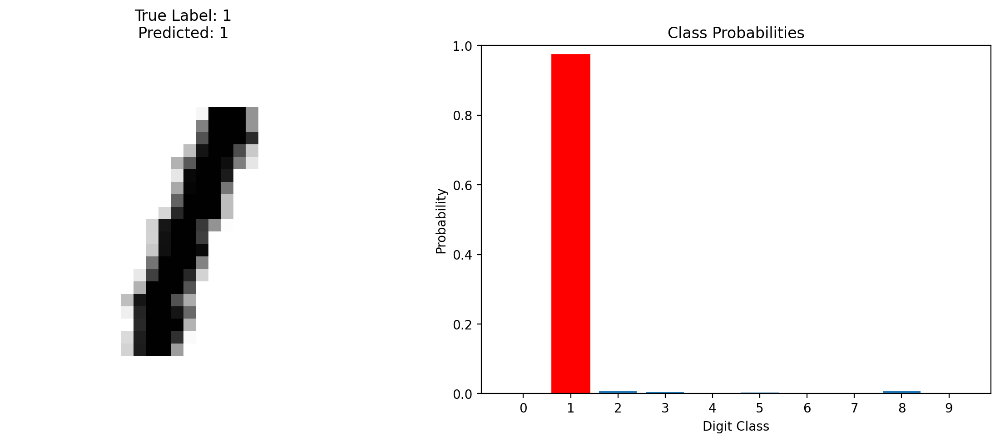


Test Image 1:
True label: 1
Predicted class: 1
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.9749
  Class 2: 0.0075
  Class 3: 0.0050
  Class 4: 0.0000
  Class 5: 0.0034
  Class 6: 0.0000
  Class 7: 0.0015
  Class 8: 0.0075
  Class 9: 0.0001


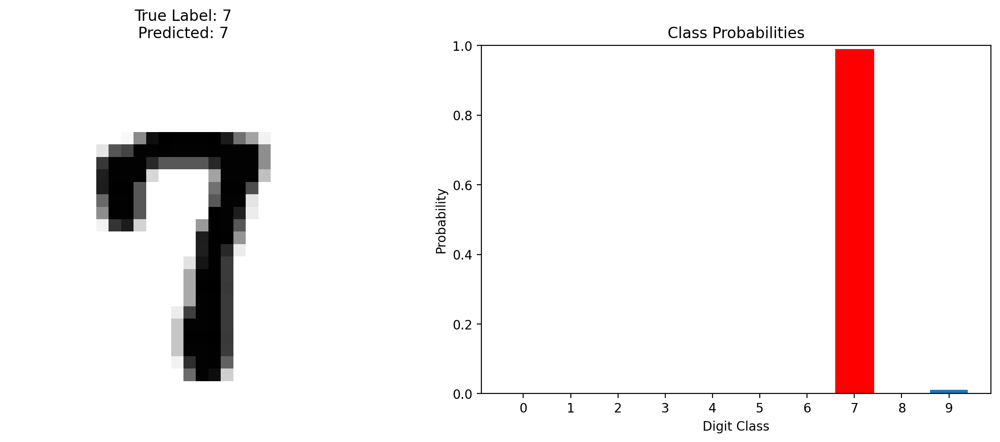


Test Image 2:
True label: 7
Predicted class: 7
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0000
  Class 4: 0.0000
  Class 5: 0.0000
  Class 6: 0.0000
  Class 7: 0.9885
  Class 8: 0.0000
  Class 9: 0.0115


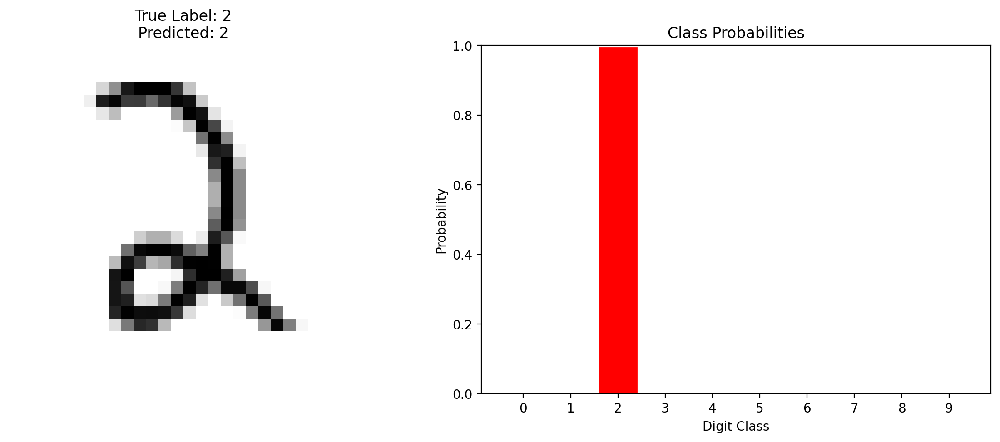


Test Image 3:
True label: 2
Predicted class: 2
Class probabilities:
  Class 0: 0.0001
  Class 1: 0.0000
  Class 2: 0.9934
  Class 3: 0.0034
  Class 4: 0.0000
  Class 5: 0.0007
  Class 6: 0.0023
  Class 7: 0.0000
  Class 8: 0.0001
  Class 9: 0.0000


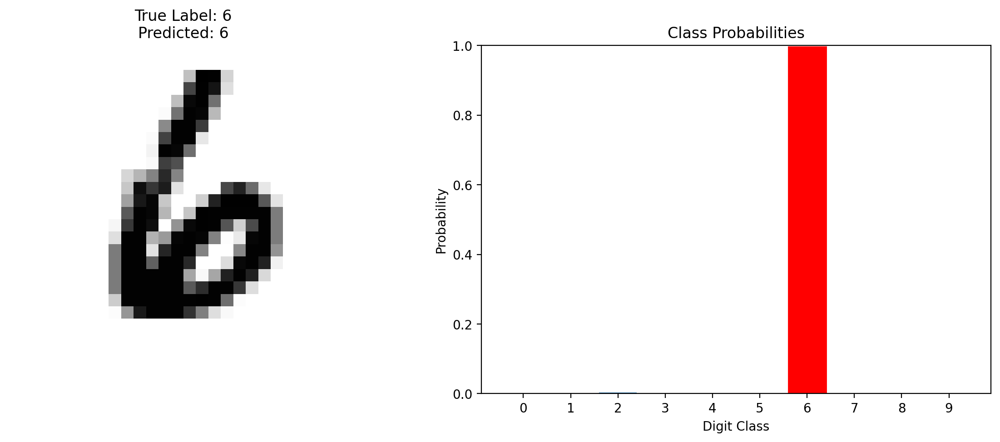


Test Image 4:
True label: 6
Predicted class: 6
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0034
  Class 3: 0.0000
  Class 4: 0.0000
  Class 5: 0.0000
  Class 6: 0.9966
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


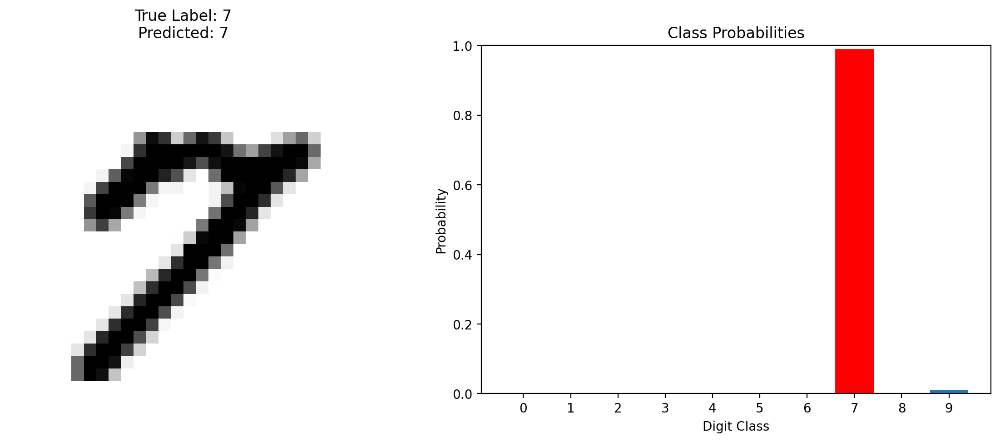


Test Image 5:
True label: 7
Predicted class: 7
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0000
  Class 4: 0.0000
  Class 5: 0.0000
  Class 6: 0.0000
  Class 7: 0.9885
  Class 8: 0.0000
  Class 9: 0.0115


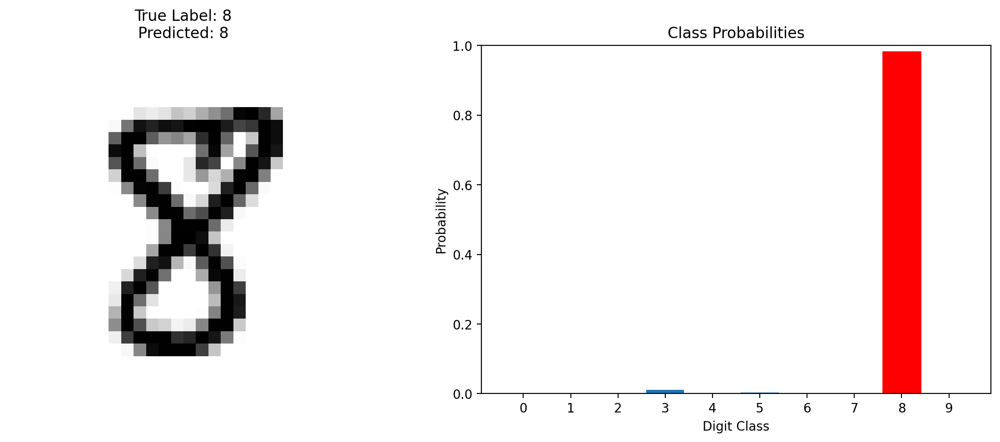


Test Image 6:
True label: 8
Predicted class: 8
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0023
  Class 3: 0.0114
  Class 4: 0.0000
  Class 5: 0.0034
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.9820
  Class 9: 0.0010


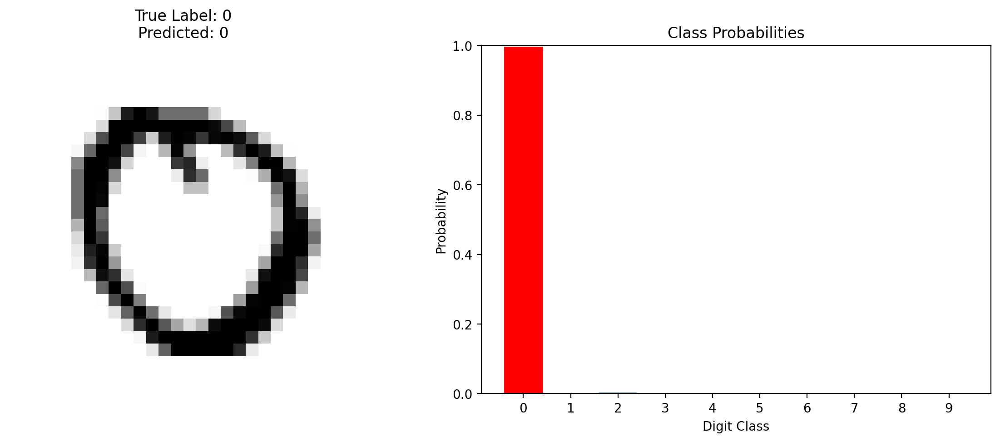


Test Image 7:
True label: 0
Predicted class: 0
Class probabilities:
  Class 0: 0.9957
  Class 1: 0.0000
  Class 2: 0.0034
  Class 3: 0.0001
  Class 4: 0.0000
  Class 5: 0.0007
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0001
  Class 9: 0.0000


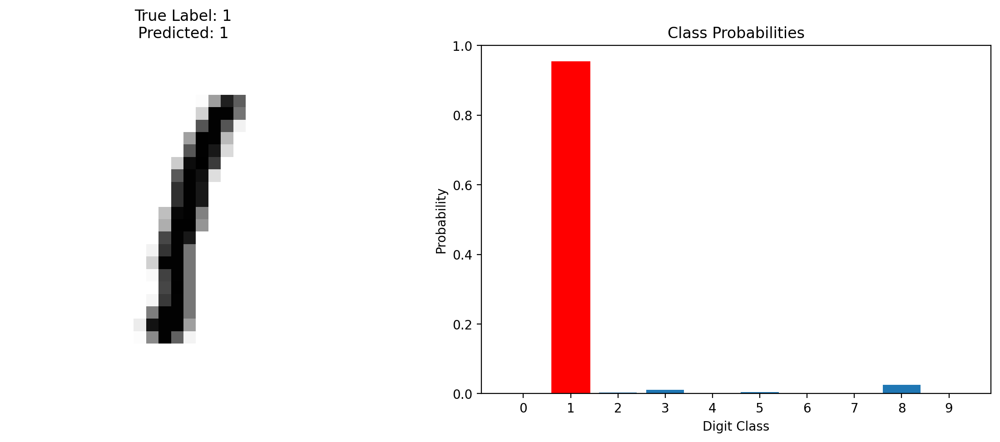


Test Image 8:
True label: 1
Predicted class: 1
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.9538
  Class 2: 0.0033
  Class 3: 0.0111
  Class 4: 0.0001
  Class 5: 0.0049
  Class 6: 0.0001
  Class 7: 0.0010
  Class 8: 0.0249
  Class 9: 0.0010


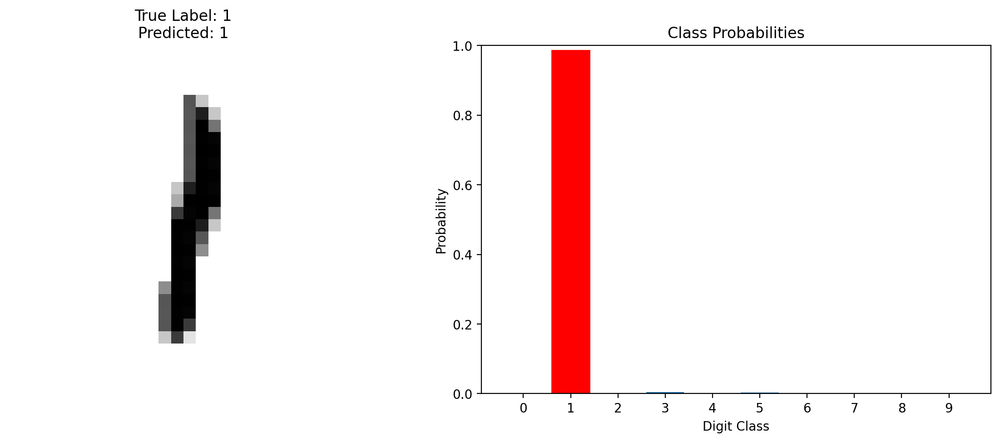


Test Image 9:
True label: 1
Predicted class: 1
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.9856
  Class 2: 0.0010
  Class 3: 0.0051
  Class 4: 0.0001
  Class 5: 0.0034
  Class 6: 0.0000
  Class 7: 0.0023
  Class 8: 0.0023
  Class 9: 0.0003


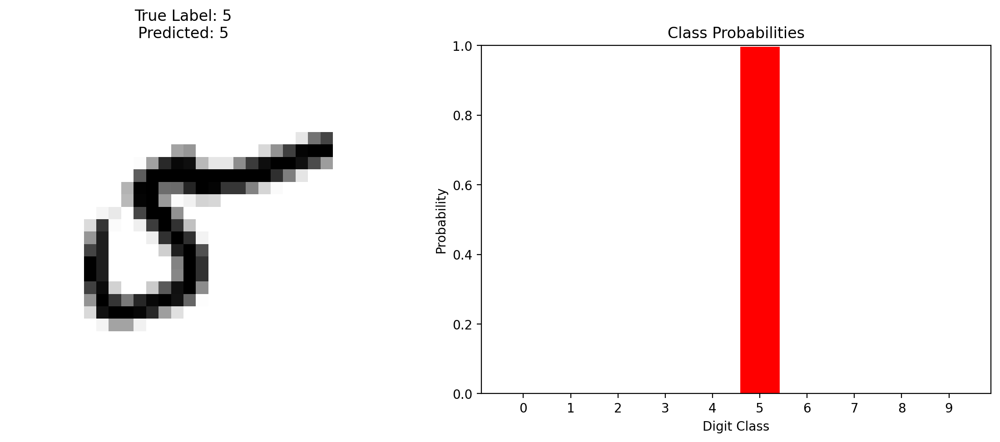


Test Image 10:
True label: 5
Predicted class: 5
Class probabilities:
  Class 0: 0.0005
  Class 1: 0.0010
  Class 2: 0.0005
  Class 3: 0.0005
  Class 4: 0.0010
  Class 5: 0.9950
  Class 6: 0.0010
  Class 7: 0.0003
  Class 8: 0.0003
  Class 9: 0.0000
Visualized 10 test images with their predictions


In [36]:
# Cell to visualize test set images with class probabilities

import numpy as np
import matplotlib.pyplot as plt
import torch

# Number of test images to visualize (set to None to visualize all)
num_samples_to_visualize = 10  # Change this to visualize more or fewer images

# Ensure model is in evaluation mode
model = quantized_model  # Or use model.model if you're working with the MLP_extended instance
model.eval()

# Get a batch of images from your test_loader
# Assuming test_loader is your DataLoader for test data
# If your test data is organized differently, modify accordingly
with torch.no_grad():
    # Counter for displayed images
    count = 0

    # Loop through batches in the test loader
    for images, labels in testloader:
        batch_size = images.size(0)

        # Process each image in the batch
        for i in range(10):
            # Check if we've reached the desired number of samples
            if num_samples_to_visualize is not None and count >= num_samples_to_visualize:
                break

            # Get single image and label
            image = images[i]
            true_label = labels[i].item()

            # Run inference
            input_tensor = image.unsqueeze(0)  # Add batch dimension
            outputs = model(input_tensor)
            log_probs = outputs
            probs = torch.exp(log_probs)
            _, predicted_class = torch.max(probs, 1)

            # Convert to numpy for visualization
            probabilities = probs.squeeze().numpy()

            # Get image for display (denormalize if needed)
            img_display = image.squeeze().numpy()

            # Display results
            plt.figure(figsize=(12, 5))

            # Display the image
            plt.subplot(1, 2, 1)
            plt.imshow(img_display, cmap='binary')
            plt.title(f"True Label: {true_label}\nPredicted: {predicted_class.item()}")
            plt.axis('off')

            # Display probability distribution
            plt.subplot(1, 2, 2)
            bars = plt.bar(range(10), probabilities)
            plt.title("Class Probabilities")
            plt.xlabel("Digit Class")
            plt.ylabel("Probability")
            plt.xticks(range(10))
            plt.ylim(0, 1.0)  # Set y-axis from 0 to 1 for probabilities

            # Highlight the predicted class
            bars[predicted_class.item()].set_color('red')

            # Highlight the true class with a different color if it's different
            if predicted_class.item() != true_label:
                bars[true_label].set_color('green')

            plt.tight_layout()
            plt.show()

            # Print probabilities
            print(f"\nTest Image {count+1}:")
            print(f"True label: {true_label}")
            print(f"Predicted class: {predicted_class.item()}")
            print("Class probabilities:")
            for j, prob in enumerate(probabilities):
                print(f"  Class {j}: {prob:.4f}")

            # Increment counter
            count += 1

        # Check if we've reached the desired number of samples
        if num_samples_to_visualize is not None and count >= num_samples_to_visualize:
            break

print(f"Visualized {count} test images with their predictions")

Found 18 images to process


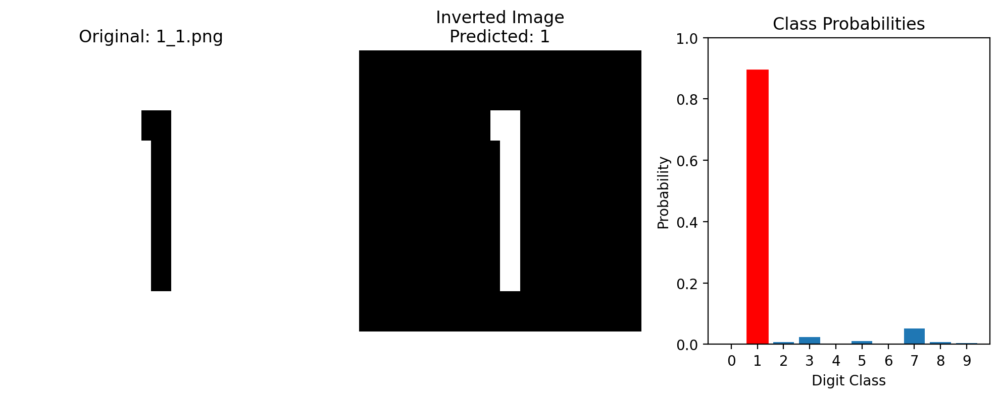


Results for 1_1.png:
Predicted class: 1
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.8948
  Class 2: 0.0069
  Class 3: 0.0233
  Class 4: 0.0006
  Class 5: 0.0104
  Class 6: 0.0000
  Class 7: 0.0525
  Class 8: 0.0069
  Class 9: 0.0046


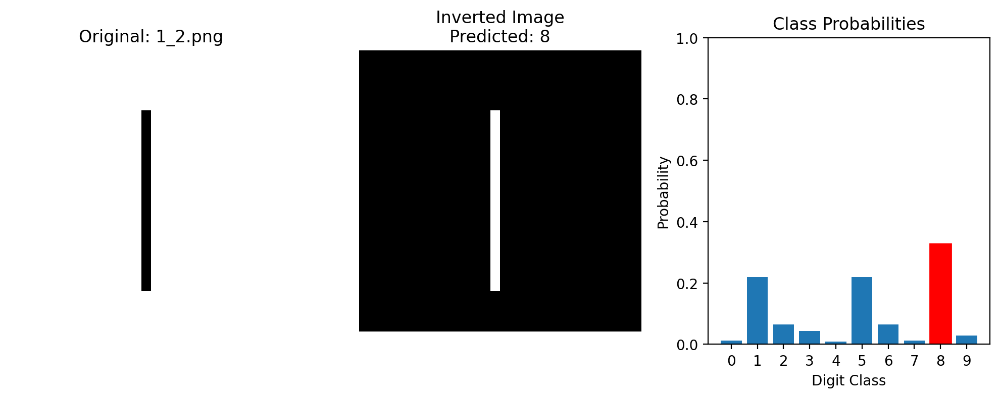


Results for 1_2.png:
Predicted class: 8
Class probabilities:
  Class 0: 0.0128
  Class 1: 0.2184
  Class 2: 0.0648
  Class 3: 0.0432
  Class 4: 0.0085
  Class 5: 0.2184
  Class 6: 0.0648
  Class 7: 0.0128
  Class 8: 0.3275
  Class 9: 0.0288


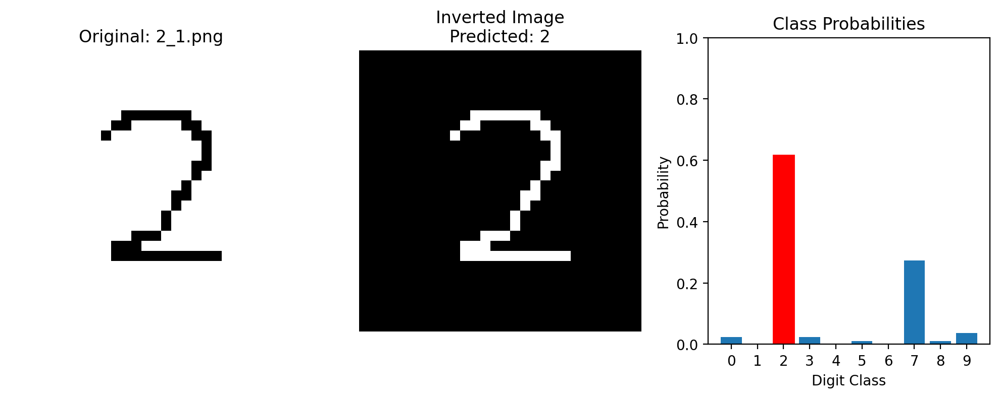


Results for 2_1.png:
Predicted class: 2
Class probabilities:
  Class 0: 0.0241
  Class 1: 0.0002
  Class 2: 0.6161
  Class 3: 0.0241
  Class 4: 0.0009
  Class 5: 0.0107
  Class 6: 0.0032
  Class 7: 0.2739
  Class 8: 0.0107
  Class 9: 0.0361


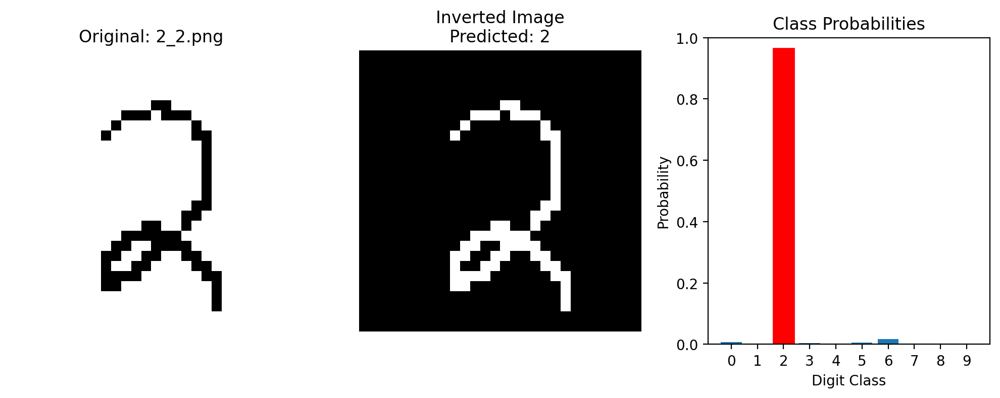


Results for 2_2.png:
Predicted class: 2
Class probabilities:
  Class 0: 0.0075
  Class 1: 0.0001
  Class 2: 0.9655
  Class 3: 0.0033
  Class 4: 0.0001
  Class 5: 0.0050
  Class 6: 0.0168
  Class 7: 0.0002
  Class 8: 0.0015
  Class 9: 0.0001


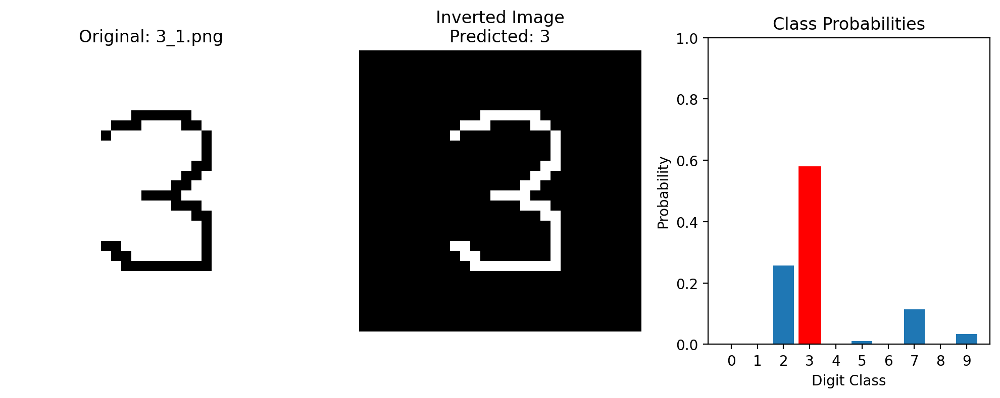


Results for 3_1.png:
Predicted class: 3
Class probabilities:
  Class 0: 0.0030
  Class 1: 0.0002
  Class 2: 0.2571
  Class 3: 0.5783
  Class 4: 0.0002
  Class 5: 0.0101
  Class 6: 0.0000
  Class 7: 0.1143
  Class 8: 0.0030
  Class 9: 0.0339


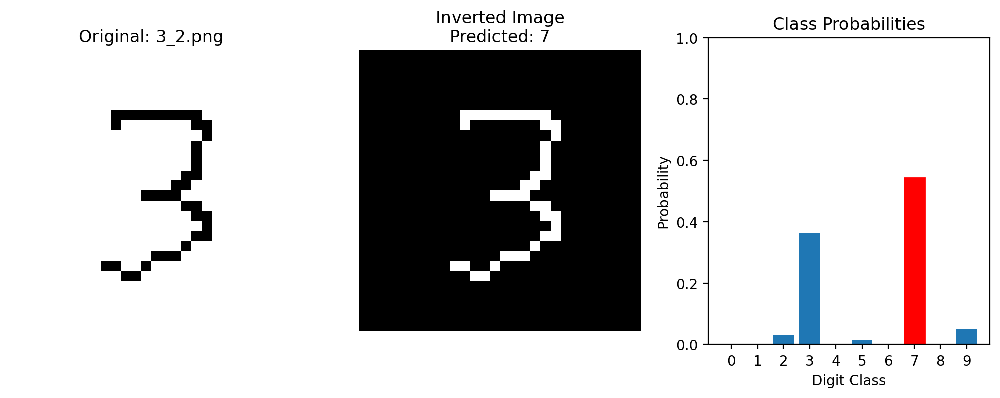


Results for 3_2.png:
Predicted class: 7
Class probabilities:
  Class 0: 0.0008
  Class 1: 0.0002
  Class 2: 0.0318
  Class 3: 0.3618
  Class 4: 0.0002
  Class 5: 0.0141
  Class 6: 0.0000
  Class 7: 0.5426
  Class 8: 0.0006
  Class 9: 0.0477


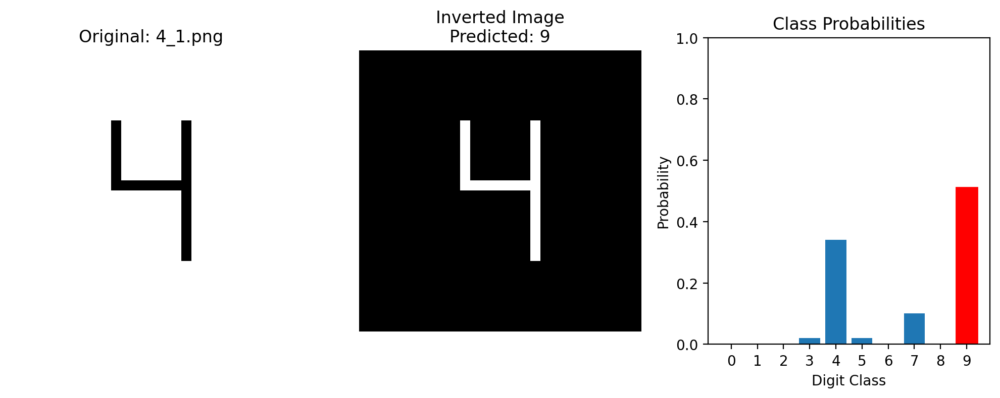


Results for 4_1.png:
Predicted class: 9
Class probabilities:
  Class 0: 0.0002
  Class 1: 0.0012
  Class 2: 0.0005
  Class 3: 0.0200
  Class 4: 0.3414
  Class 5: 0.0200
  Class 6: 0.0008
  Class 7: 0.1012
  Class 8: 0.0026
  Class 9: 0.5120


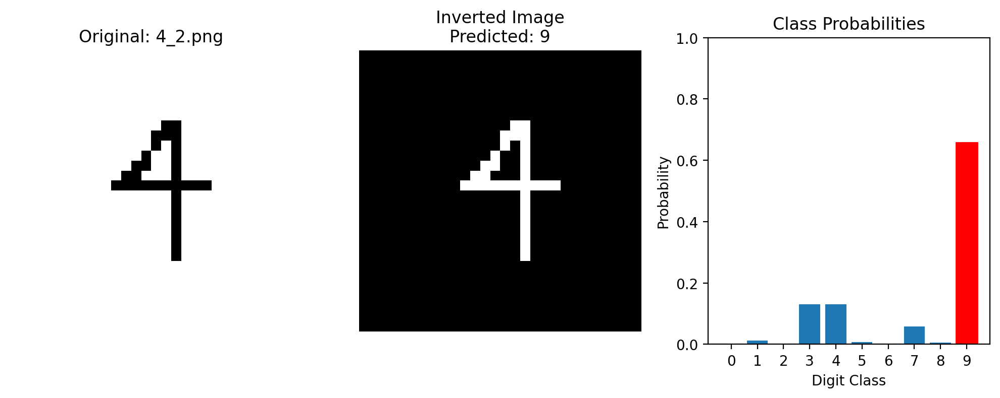


Results for 4_2.png:
Predicted class: 9
Class probabilities:
  Class 0: 0.0001
  Class 1: 0.0114
  Class 2: 0.0003
  Class 3: 0.1300
  Class 4: 0.1300
  Class 5: 0.0076
  Class 6: 0.0002
  Class 7: 0.0578
  Class 8: 0.0051
  Class 9: 0.6575


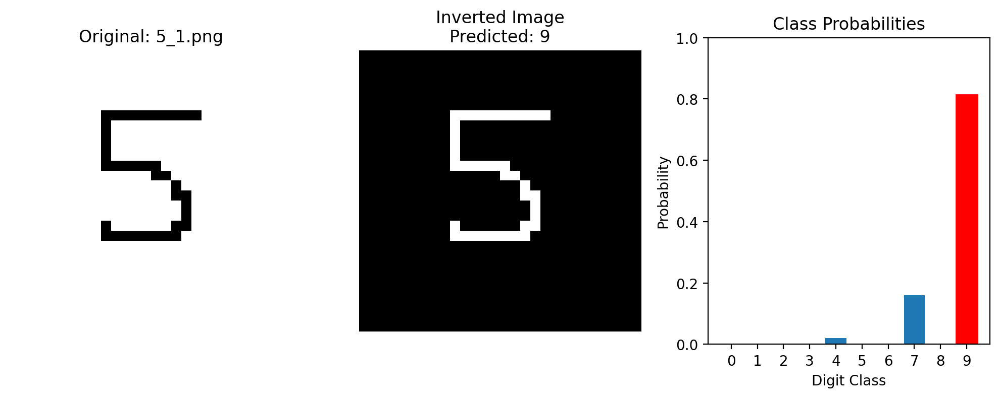


Results for 5_1.png:
Predicted class: 9
Class probabilities:
  Class 0: 0.0004
  Class 1: 0.0000
  Class 2: 0.0006
  Class 3: 0.0002
  Class 4: 0.0212
  Class 5: 0.0001
  Class 6: 0.0002
  Class 7: 0.1609
  Class 8: 0.0028
  Class 9: 0.8137


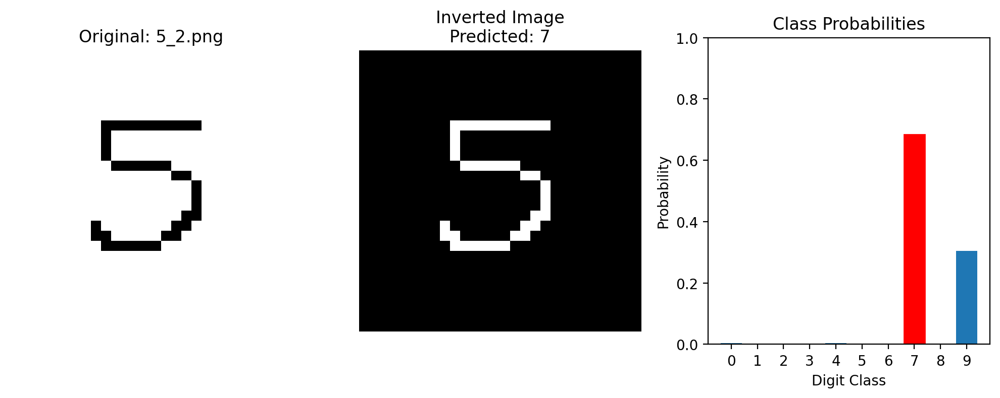


Results for 5_2.png:
Predicted class: 7
Class probabilities:
  Class 0: 0.0035
  Class 1: 0.0000
  Class 2: 0.0010
  Class 3: 0.0002
  Class 4: 0.0035
  Class 5: 0.0005
  Class 6: 0.0002
  Class 7: 0.6844
  Class 8: 0.0024
  Class 9: 0.3043


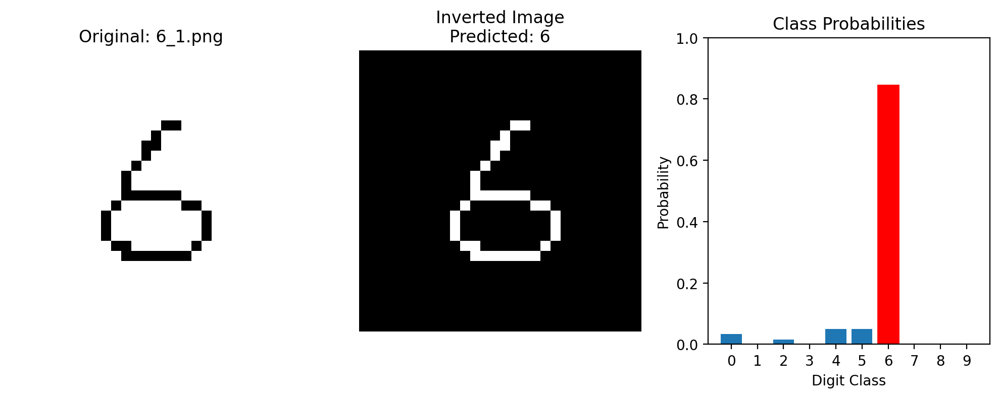


Results for 6_1.png:
Predicted class: 6
Class probabilities:
  Class 0: 0.0331
  Class 1: 0.0001
  Class 2: 0.0147
  Class 3: 0.0013
  Class 4: 0.0496
  Class 5: 0.0496
  Class 6: 0.8456
  Class 7: 0.0013
  Class 8: 0.0019
  Class 9: 0.0029


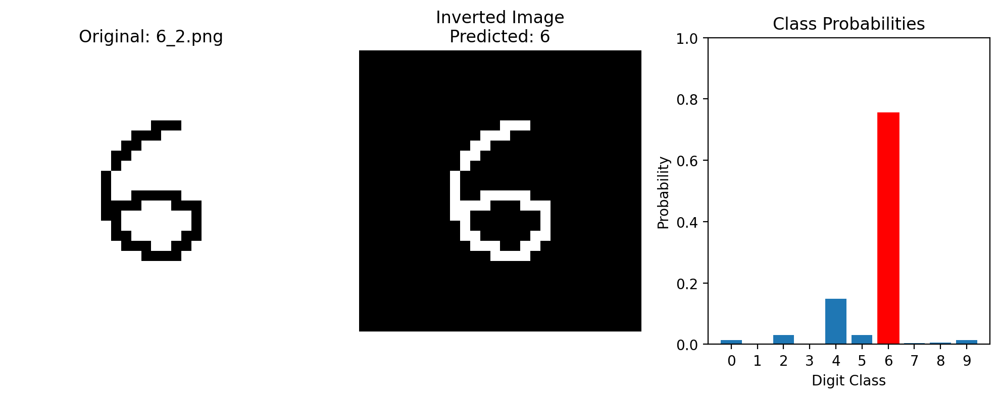


Results for 6_2.png:
Predicted class: 6
Class probabilities:
  Class 0: 0.0131
  Class 1: 0.0000
  Class 2: 0.0295
  Class 3: 0.0008
  Class 4: 0.1493
  Class 5: 0.0295
  Class 6: 0.7549
  Class 7: 0.0039
  Class 8: 0.0058
  Class 9: 0.0131


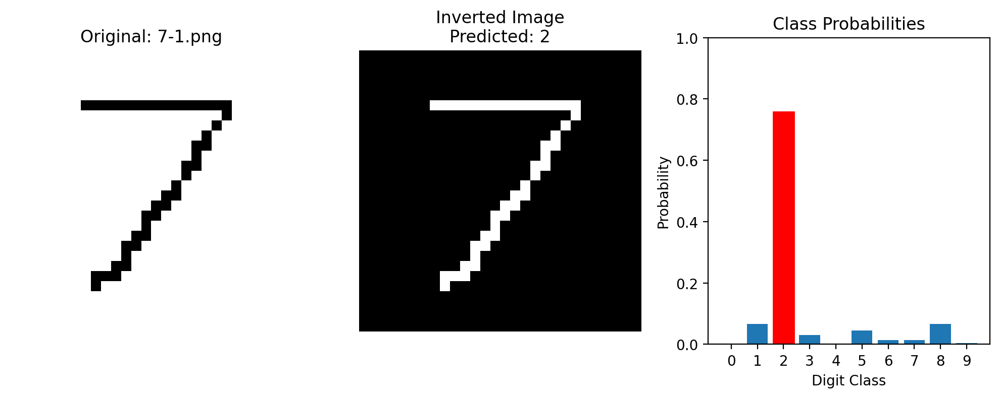


Results for 7-1.png:
Predicted class: 2
Class probabilities:
  Class 0: 0.0026
  Class 1: 0.0667
  Class 2: 0.7588
  Class 3: 0.0297
  Class 4: 0.0008
  Class 5: 0.0445
  Class 6: 0.0132
  Class 7: 0.0132
  Class 8: 0.0667
  Class 9: 0.0039


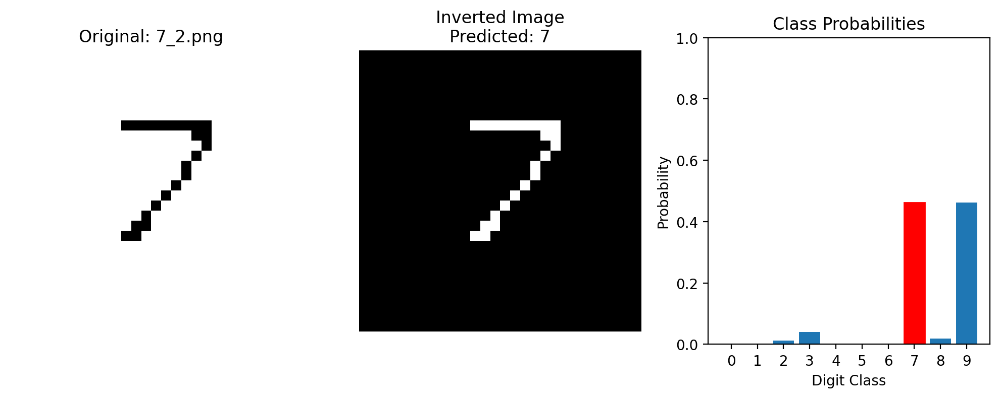


Results for 7_2.png:
Predicted class: 7
Class probabilities:
  Class 0: 0.0003
  Class 1: 0.0016
  Class 2: 0.0120
  Class 3: 0.0406
  Class 4: 0.0011
  Class 5: 0.0024
  Class 6: 0.0000
  Class 7: 0.4620
  Class 8: 0.0181
  Class 9: 0.4620


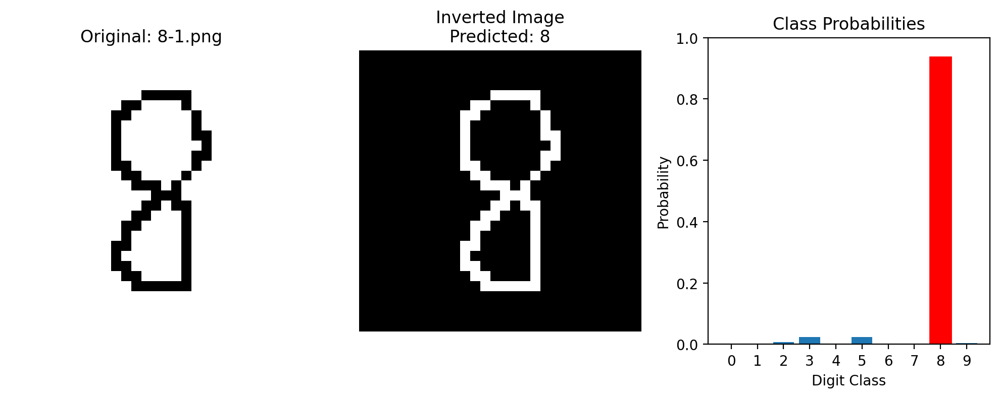


Results for 8-1.png:
Predicted class: 8
Class probabilities:
  Class 0: 0.0004
  Class 1: 0.0014
  Class 2: 0.0072
  Class 3: 0.0244
  Class 4: 0.0002
  Class 5: 0.0244
  Class 6: 0.0003
  Class 7: 0.0000
  Class 8: 0.9368
  Class 9: 0.0048


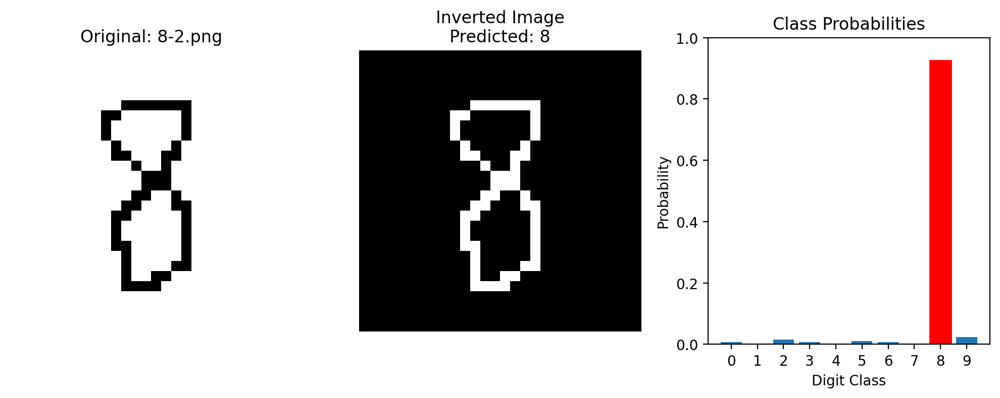


Results for 8-2.png:
Predicted class: 8
Class probabilities:
  Class 0: 0.0071
  Class 1: 0.0014
  Class 2: 0.0161
  Class 3: 0.0071
  Class 4: 0.0014
  Class 5: 0.0107
  Class 6: 0.0071
  Class 7: 0.0000
  Class 8: 0.9248
  Class 9: 0.0241


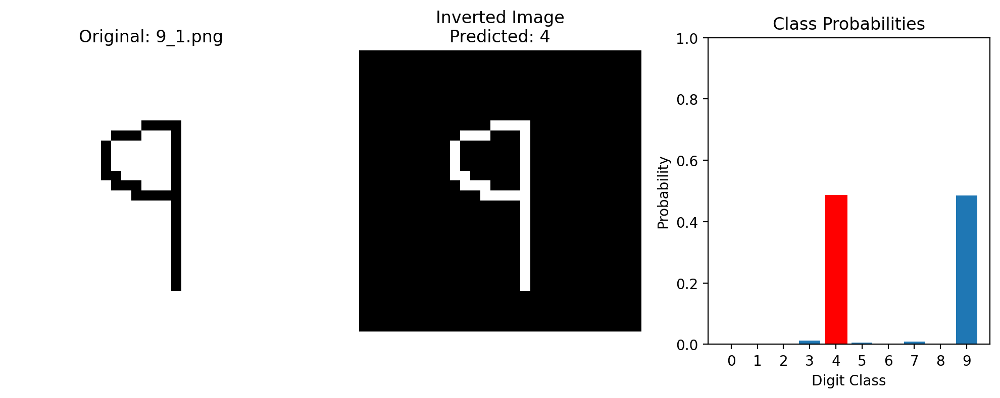


Results for 9_1.png:
Predicted class: 4
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0007
  Class 2: 0.0001
  Class 3: 0.0126
  Class 4: 0.4849
  Class 5: 0.0056
  Class 6: 0.0001
  Class 7: 0.0084
  Class 8: 0.0025
  Class 9: 0.4849


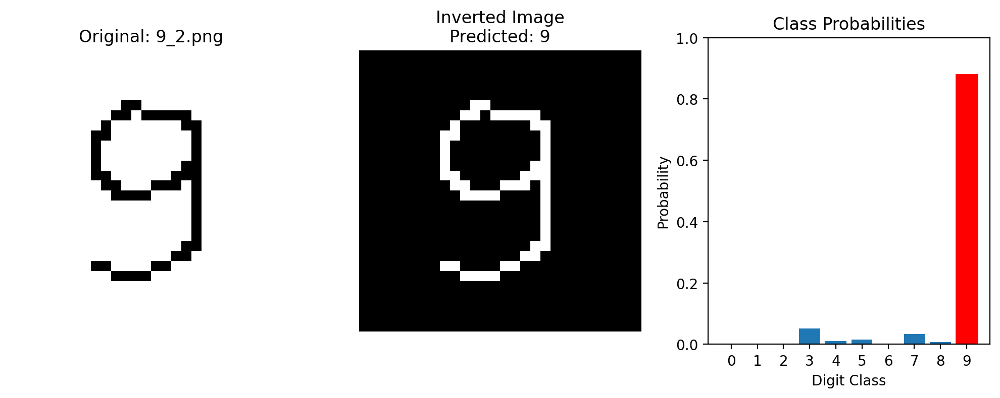


Results for 9_2.png:
Predicted class: 9
Class probabilities:
  Class 0: 0.0013
  Class 1: 0.0000
  Class 2: 0.0006
  Class 3: 0.0516
  Class 4: 0.0102
  Class 5: 0.0153
  Class 6: 0.0000
  Class 7: 0.0344
  Class 8: 0.0068
  Class 9: 0.8798


In [56]:
import os
import numpy as np
import torch
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms

# Set the path to your test images folder
test_image_folder = "Test_Images_2"

# Check if the path exists
if not os.path.exists(test_image_folder):
    print(f"Error: The path '{test_image_folder}' does not exist.")
else:
    # Get all PNG image files from the folder
    image_files = [f for f in os.listdir(test_image_folder) if f.lower().endswith('.png')]

    if not image_files:
        print(f"No image files found in {test_image_folder}")
    else:
        print(f"Found {len(image_files)} images to process")

        # Ensure the model is in evaluation mode
        model.eval()

        # Define transformation (Ensure 28x28 grayscale, invert pixels, & normalize)
        class InvertTransform:
            """ Custom transform to invert image pixels """
            def __call__(self, img):
                img_np = np.array(img)  # Convert to NumPy array
                img_np = 255 - img_np   # Invert pixel values (Black ↔ White)
                img = Image.fromarray(img_np)  # Convert back to PIL image
                return img

        transform = transforms.Compose([
            transforms.Grayscale(num_output_channels=1),  # Ensure grayscale
            InvertTransform(),  # Invert pixel values
            transforms.ToTensor(),
            transforms.Normalize((0.5,), (0.5,))  # Normalize to match training distribution
        ])

        # Process each image
        for img_file in image_files:
            img_path = os.path.join(test_image_folder, img_file)

            try:
                # Load the original image
                img = Image.open(img_path).convert('L')  # Convert to grayscale

                # Apply transformation (inversion + normalization)
                img_tensor = transform(img)

                # Add batch dimension for model input
                input_tensor = img_tensor.unsqueeze(0)

                # Run inference
                with torch.no_grad():
                    outputs = model(input_tensor)
                    log_probs = outputs
                    probs = torch.exp(log_probs)  # Convert log probabilities to normal probabilities
                    _, predicted_class = torch.max(probs, 1)

                # Convert probabilities to NumPy for visualization
                probabilities = probs.squeeze().numpy()

                # Display results
                plt.figure(figsize=(10, 4))

                # Display the original image
                plt.subplot(1, 3, 1)
                plt.imshow(img, cmap='gray')
                plt.title(f"Original: {img_file}")
                plt.axis('off')

                # Display the inverted image
                plt.subplot(1, 3, 2)
                plt.imshow(img_tensor.squeeze().numpy(), cmap='gray')
                plt.title(f"Inverted Image\nPredicted: {predicted_class.item()}")
                plt.axis('off')

                # Display probability distribution
                plt.subplot(1, 3, 3)
                bars = plt.bar(range(10), probabilities)
                plt.title("Class Probabilities")
                plt.xlabel("Digit Class")
                plt.ylabel("Probability")
                plt.xticks(range(10))
                plt.ylim(0, 1.0)  # Set y-axis from 0 to 1 for probabilities

                # Highlight the predicted class
                bars[predicted_class.item()].set_color('red')

                plt.tight_layout()
                plt.show()

                # Print probabilities
                print(f"\nResults for {img_file}:")
                print(f"Predicted class: {predicted_class.item()}")
                print("Class probabilities:")
                for i, prob in enumerate(probabilities):
                    print(f"  Class {i}: {prob:.4f}")

            except Exception as e:
                print(f"Error processing image {img_file}: {e}")
                continue


Found 9 images to process


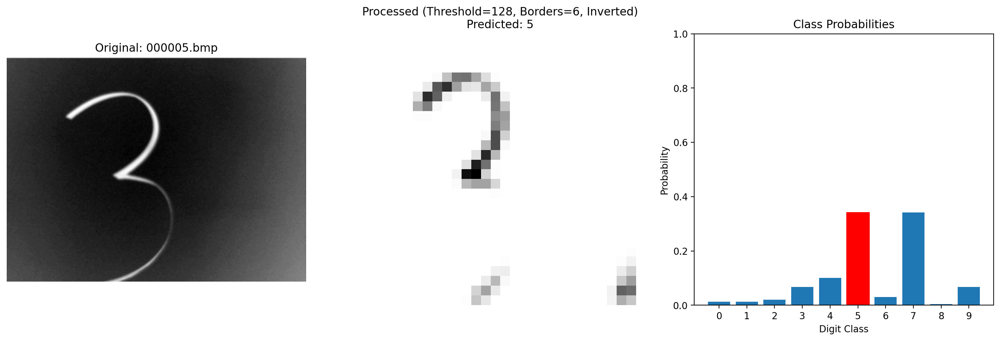


Results for 000005.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0133
  Class 1: 0.0133
  Class 2: 0.0200
  Class 3: 0.0675
  Class 4: 0.1013
  Class 5: 0.3415
  Class 6: 0.0300
  Class 7: 0.3415
  Class 8: 0.0040
  Class 9: 0.0675


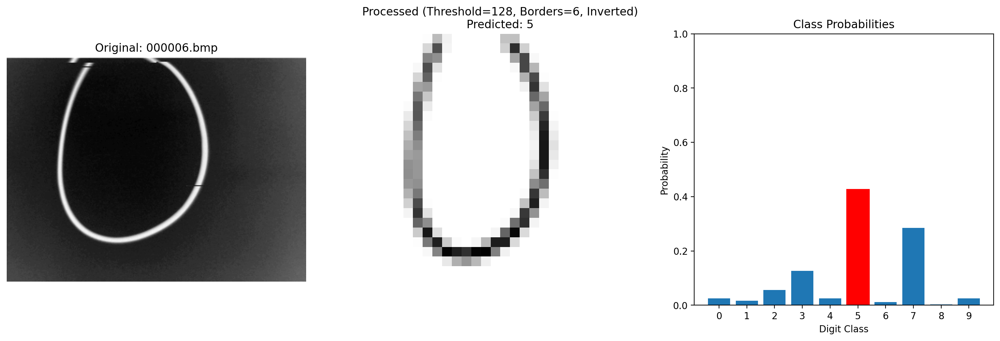


Results for 000006.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0250
  Class 1: 0.0167
  Class 2: 0.0562
  Class 3: 0.1265
  Class 4: 0.0250
  Class 5: 0.4266
  Class 6: 0.0111
  Class 7: 0.2845
  Class 8: 0.0033
  Class 9: 0.0250


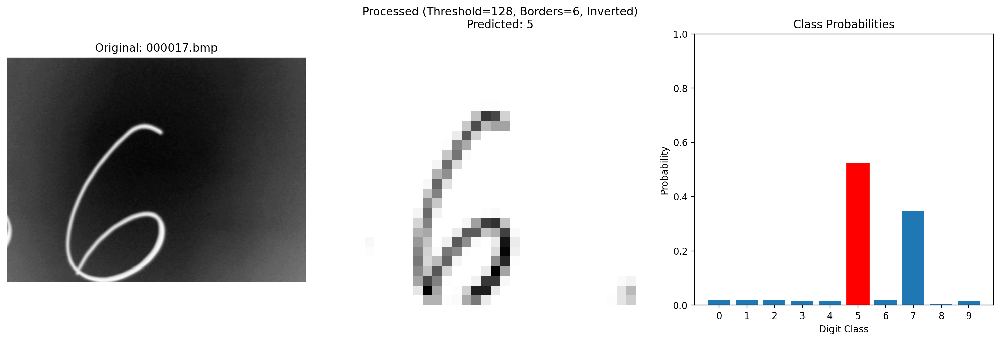


Results for 000017.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0204
  Class 1: 0.0204
  Class 2: 0.0204
  Class 3: 0.0136
  Class 4: 0.0136
  Class 5: 0.5228
  Class 6: 0.0204
  Class 7: 0.3486
  Class 8: 0.0061
  Class 9: 0.0136


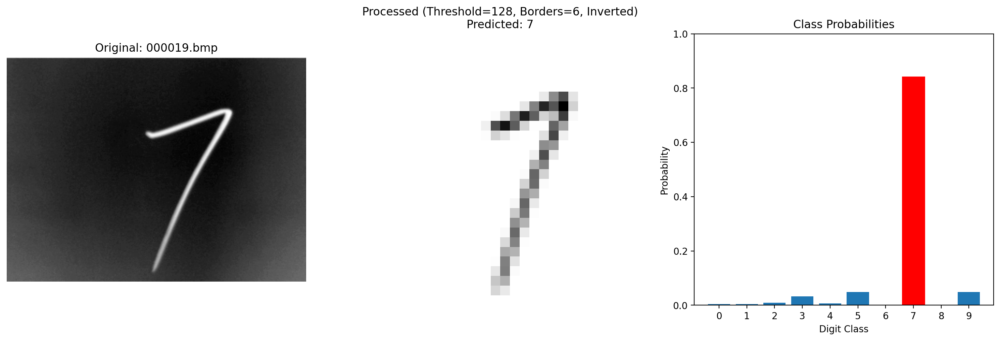


Results for 000019.bmp:
Predicted class: 7
Class probabilities:
  Class 0: 0.0043
  Class 1: 0.0043
  Class 2: 0.0097
  Class 3: 0.0329
  Class 4: 0.0065
  Class 5: 0.0493
  Class 6: 0.0009
  Class 7: 0.8409
  Class 8: 0.0019
  Class 9: 0.0493


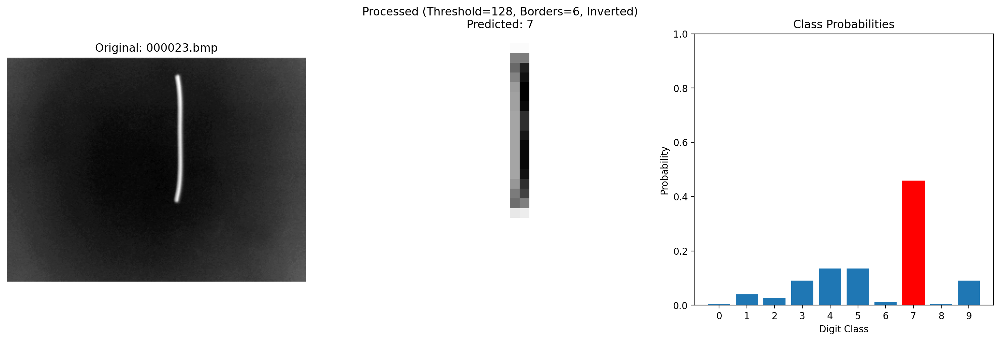


Results for 000023.bmp:
Predicted class: 7
Class probabilities:
  Class 0: 0.0053
  Class 1: 0.0402
  Class 2: 0.0268
  Class 3: 0.0905
  Class 4: 0.1357
  Class 5: 0.1357
  Class 6: 0.0119
  Class 7: 0.4578
  Class 8: 0.0053
  Class 9: 0.0905


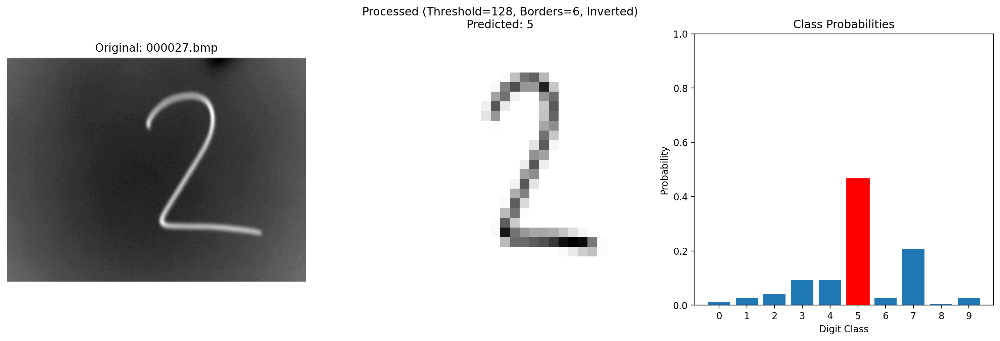


Results for 000027.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0122
  Class 1: 0.0274
  Class 2: 0.0411
  Class 3: 0.0923
  Class 4: 0.0923
  Class 5: 0.4670
  Class 6: 0.0274
  Class 7: 0.2076
  Class 8: 0.0054
  Class 9: 0.0274


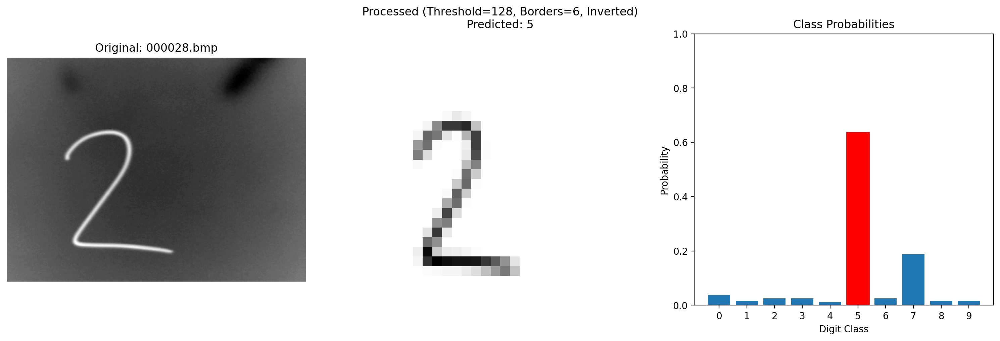


Results for 000028.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0374
  Class 1: 0.0166
  Class 2: 0.0249
  Class 3: 0.0249
  Class 4: 0.0111
  Class 5: 0.6378
  Class 6: 0.0249
  Class 7: 0.1891
  Class 8: 0.0166
  Class 9: 0.0166


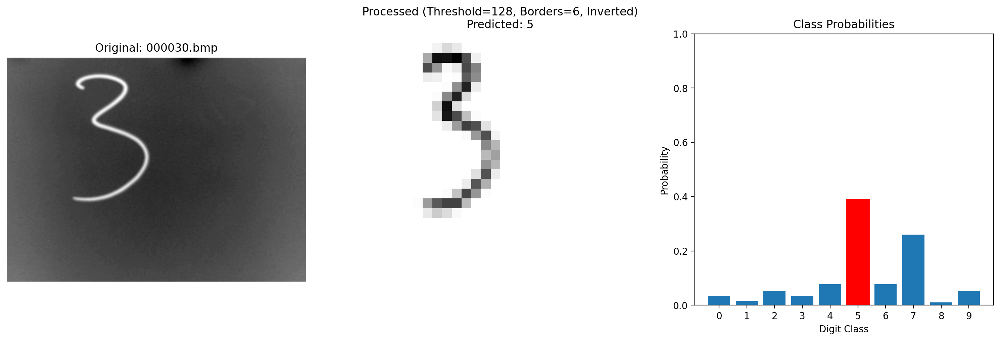


Results for 000030.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0342
  Class 1: 0.0152
  Class 2: 0.0514
  Class 3: 0.0342
  Class 4: 0.0770
  Class 5: 0.3896
  Class 6: 0.0770
  Class 7: 0.2598
  Class 8: 0.0102
  Class 9: 0.0514


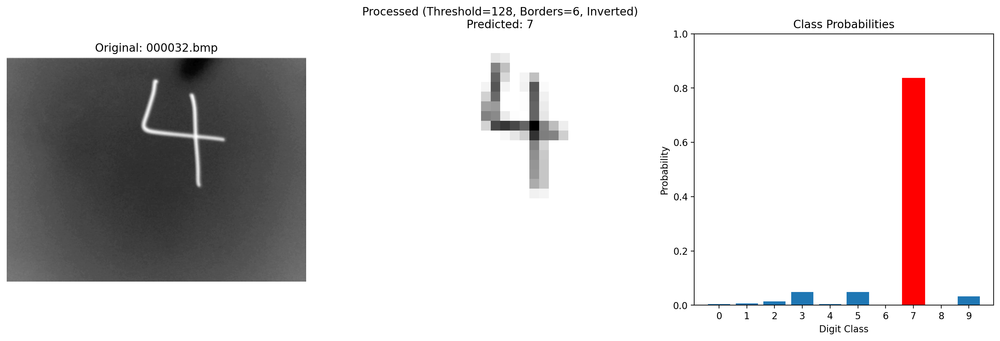


Results for 000032.bmp:
Predicted class: 7
Class probabilities:
  Class 0: 0.0043
  Class 1: 0.0065
  Class 2: 0.0145
  Class 3: 0.0491
  Class 4: 0.0043
  Class 5: 0.0491
  Class 6: 0.0009
  Class 7: 0.8368
  Class 8: 0.0019
  Class 9: 0.0327


In [ ]:
# Cell to test quantized MLP on individual images with fixed path
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms
import torch

# Set the fixed path to your image folder
image_folder = "../../select_digits"

# Define threshold (0-255 scale for grayscale images)
THRESHOLD = 128  # Adjust as needed

# Define border width for making edges completely white
BORDER_WIDTH = 6  # Number of pixels to make white around the image

# Check if the path exists
if not os.path.exists(image_folder):
    print(f"Error: The path '{image_folder}' does not exist.")
else:
    # Get all image files from the folder
    try:
        image_files = [f for f in os.listdir(image_folder)
                      if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp'))]

        if not image_files:
            print(f"No image files found in {image_folder}")
        else:
            print(f"Found {len(image_files)} images to process")

            # Use the quantized model
            try:
                # Assuming your quantized model is stored in a variable called 'quantized_model'
                model = quantized_model  # Or use model.model if using MLP_extended instance

                # Ensure model is in evaluation mode
                model.eval()

                # Define a custom transformation function
                class InvertThresholdTransform:
                    def __init__(self, threshold=THRESHOLD, border_width=BORDER_WIDTH):
                        self.threshold = threshold
                        self.border_width = border_width

                    def __call__(self, img):
                        """
                        Apply thresholding to make everything below the threshold white,
                        while keeping everything above it in grayscale.
                        Then invert the entire image before passing to the model.
                        """
                        img_np = np.array(img)  # Convert to NumPy array (0-255 grayscale)

                        # Apply threshold: set values below threshold to 255 (white)
                        img_np[img_np > self.threshold] = 255

                        # Apply a white border
                        img_np[:self.border_width, :] = 255  # Top border
                        img_np[-self.border_width:, :] = 255 # Bottom border
                        img_np[:, :self.border_width] = 255  # Left border
                        img_np[:, -self.border_width:] = 255 # Right border

                        # **Invert the Image (Flip Pixel Values)**
                        img_np = 255 - img_np  # Dark becomes light, light becomes dark

                        # Convert back to PIL Image
                        img = Image.fromarray(img_np)

                        # Resize to 28x28 and normalize
                        transform = transforms.Compose([
                            transforms.Resize((28, 28)),
                            transforms.ToTensor(),
                            transforms.Normalize((0.5,), (0.5,))  # Normalize to [-1,1]
                        ])
                        return transform(img)

                # Define transformation pipeline
                transform = InvertThresholdTransform(threshold=THRESHOLD, border_width=BORDER_WIDTH)

                # Process each image
                for img_file in image_files:
                    img_path = os.path.join(image_folder, img_file)

                    try:
                        # Load the original image
                        original_img = Image.open(img_path).convert('L')  # Convert to grayscale

                        # Apply transformation (thresholding + inversion)
                        img_tensor = transform(original_img)
                        processed_img_np = img_tensor.squeeze().numpy()

                        # Add batch dimension for model input
                        input_tensor = img_tensor.unsqueeze(0)

                        # Run inference
                        with torch.no_grad():
                            outputs = model(input_tensor)
                            log_probs = outputs
                            probs = torch.exp(log_probs)
                            _, predicted_class = torch.max(probs, 1)

                        # Convert to numpy for visualization
                        probabilities = probs.squeeze().numpy()

                        # Display results
                        plt.figure(figsize=(15, 5))

                        # Display the original image
                        plt.subplot(1, 3, 1)
                        plt.imshow(np.array(original_img), cmap='binary')
                        plt.title(f"Original: {img_file}")
                        plt.axis('off')

                        # Display the processed image (Threshold + White Borders + Inverted)
                        plt.subplot(1, 3, 2)
                        plt.imshow(processed_img_np, cmap='binary')
                        plt.title(f"Processed (Threshold={THRESHOLD}, Borders={BORDER_WIDTH}, Inverted)\nPredicted: {predicted_class.item()}")
                        plt.axis('off')

                        # Display probability distribution
                        plt.subplot(1, 3, 3)
                        bars = plt.bar(range(10), probabilities)
                        plt.title("Class Probabilities")
                        plt.xlabel("Digit Class")
                        plt.ylabel("Probability")
                        plt.xticks(range(10))
                        plt.ylim(0, 1.0)  # Set y-axis from 0 to 1 for probabilities

                        # Highlight the predicted class
                        bars[predicted_class.item()].set_color('red')

                        plt.tight_layout()
                        plt.show()

                        # Print probabilities
                        print(f"\nResults for {img_file}:")
                        print(f"Predicted class: {predicted_class.item()}")
                        print("Class probabilities:")
                        for i, prob in enumerate(probabilities):
                            print(f"  Class {i}: {prob:.4f}")

                    except Exception as e:
                        print(f"Error processing image {img_file}: {e}")
                        continue

            except NameError:
                print("Error: 'quantized_model' not found. Please ensure your model is available.")
                print("If your model has a different name, modify line 'model = quantized_model'")

    except Exception as e:
        print(f"Error accessing image folder: {e}")


Found 9 images to process


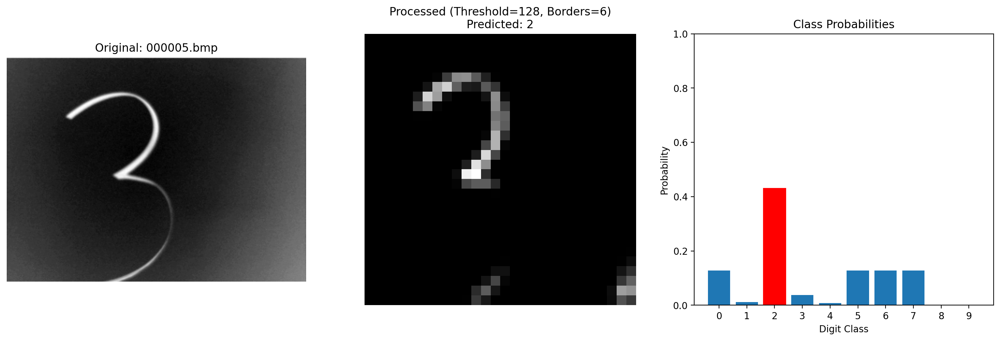


Results for 000005.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1276
  Class 1: 0.0112
  Class 2: 0.4303
  Class 3: 0.0378
  Class 4: 0.0075
  Class 5: 0.1276
  Class 6: 0.1276
  Class 7: 0.1276
  Class 8: 0.0015
  Class 9: 0.0015


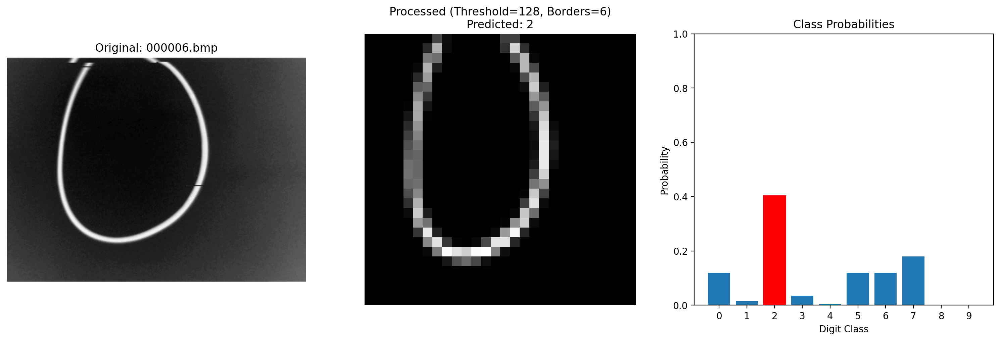


Results for 000006.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


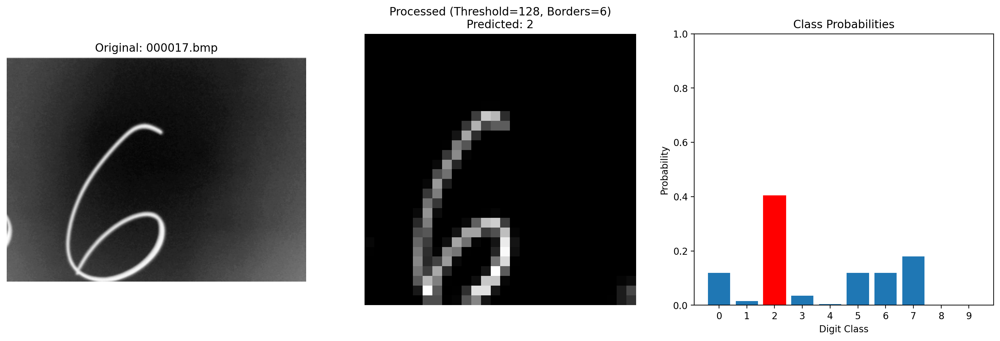


Results for 000017.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


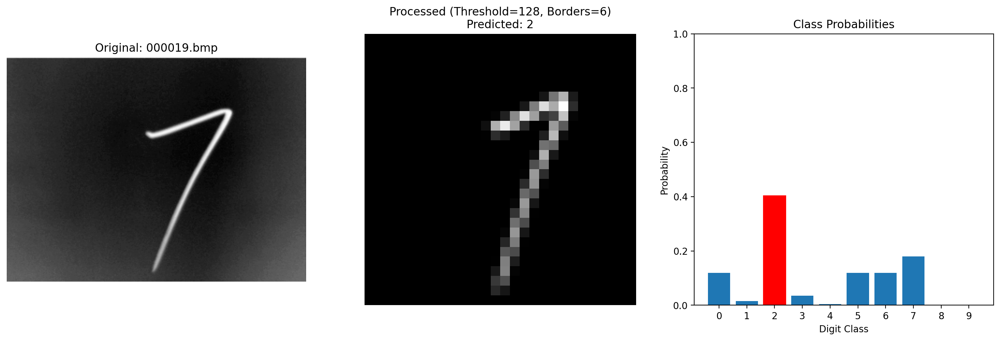


Results for 000019.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


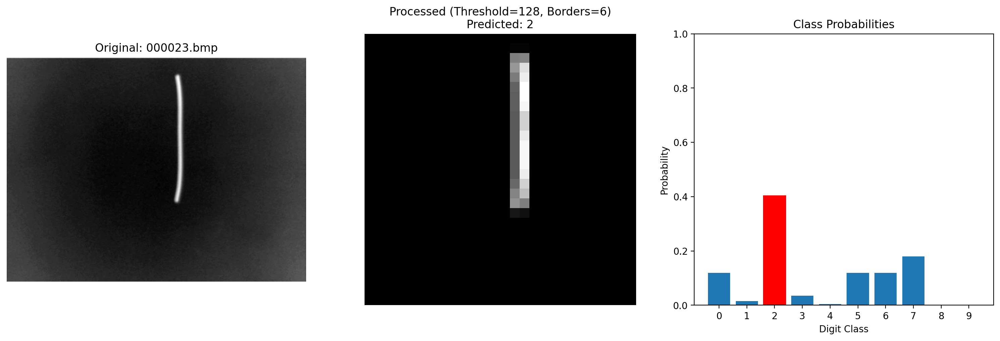


Results for 000023.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


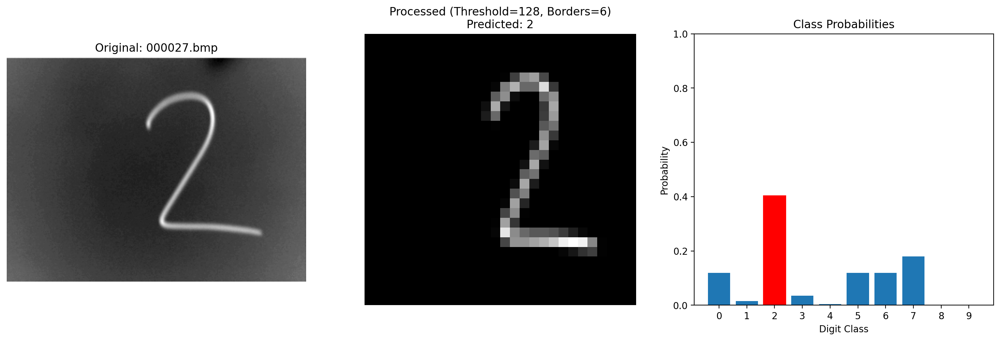


Results for 000027.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


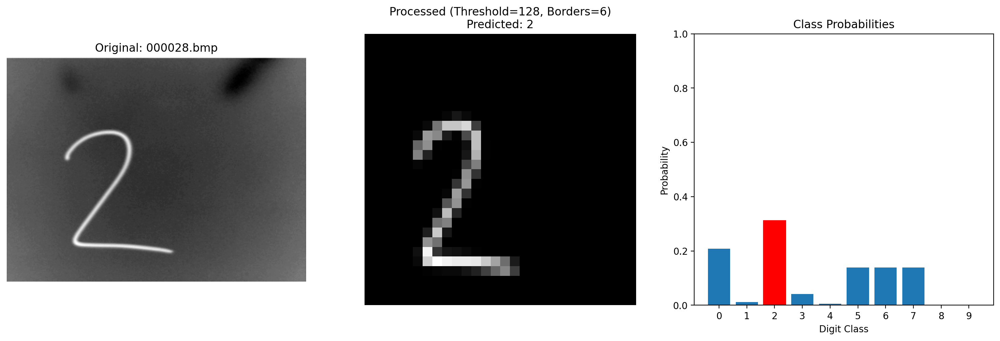


Results for 000028.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.2085
  Class 1: 0.0122
  Class 2: 0.3127
  Class 3: 0.0412
  Class 4: 0.0054
  Class 5: 0.1391
  Class 6: 0.1391
  Class 7: 0.1391
  Class 8: 0.0011
  Class 9: 0.0016


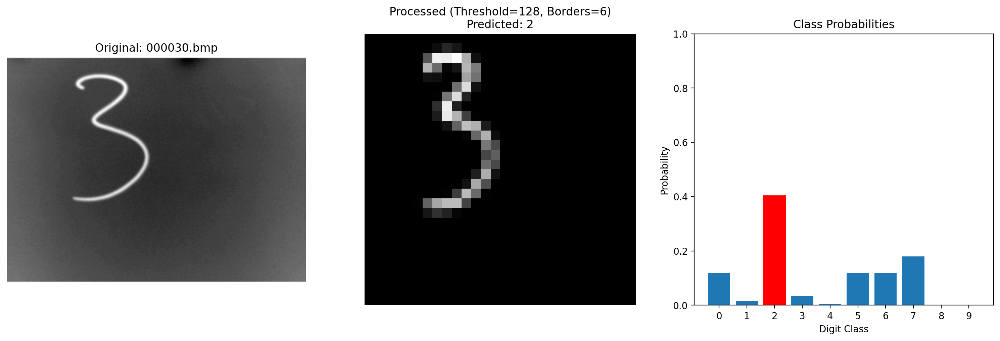


Results for 000030.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


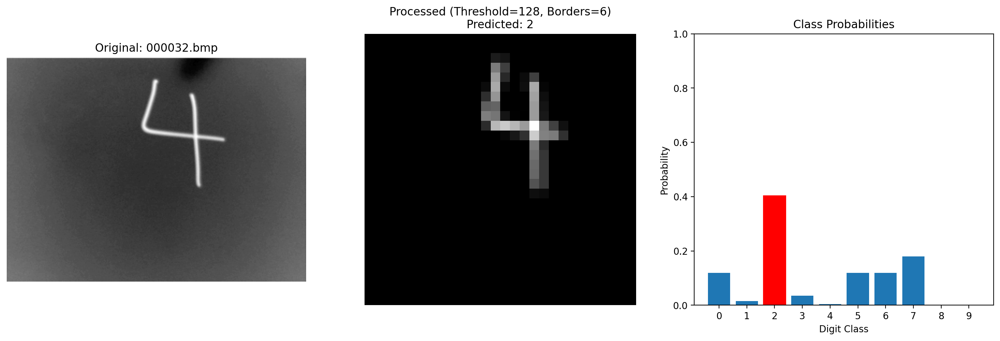


Results for 000032.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


In [48]:
# Cell to test quantized MLP on individual images with fixed path
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms
import torch

# Set the fixed path to your image folder
image_folder = "../../select_digits"

# Define threshold (0-255 scale for grayscale images)
THRESHOLD = 128  # Adjust as needed

# Define border width for making edges completely white
BORDER_WIDTH = 6  # Number of pixels to make white around the image

# Check if the path exists
if not os.path.exists(image_folder):
    print(f"Error: The path '{image_folder}' does not exist.")
else:
    # Get all image files from the folder
    try:
        image_files = [f for f in os.listdir(image_folder)
                      if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp'))]

        if not image_files:
            print(f"No image files found in {image_folder}")
        else:
            print(f"Found {len(image_files)} images to process")

            # Use the quantized model
            try:
                # Assuming your quantized model is stored in a variable called 'quantized_model'
                model = quantized_model  # Or use model.model if using MLP_extended instance

                # Ensure model is in evaluation mode
                model.eval()

                # Define a custom transformation function
                class ThresholdGrayscaleTransform:
                    def __init__(self, threshold=THRESHOLD, border_width=BORDER_WIDTH):
                        self.threshold = threshold
                        self.border_width = border_width

                    def __call__(self, img):
                        """
                        Apply thresholding to make everything below the threshold white,
                        while keeping everything above it in grayscale.
                        Also ensures that the edges of the image are completely white.
                        """
                        img_np = np.array(img)  # Convert to NumPy array (0-255 grayscale)

                        # Apply threshold: set values below threshold to 255 (white)
                        img_np[img_np > self.threshold] = 255  # Make background pure white

                        # Apply a white border
                        img_np[:self.border_width, :] = 255  # Top border
                        img_np[-self.border_width:, :] = 255 # Bottom border
                        img_np[:, :self.border_width] = 255  # Left border
                        img_np[:, -self.border_width:] = 255  # Right border

                        # Convert back to PIL Image
                        img = Image.fromarray(img_np)

                        # Resize to 28x28 and normalize
                        transform = transforms.Compose([
                            transforms.Resize((28, 28)),
                            transforms.ToTensor(),
                            transforms.Normalize((0.5,), (0.5,))  # Normalize to [-1,1]
                        ])
                        return transform(img)

                # Define transformation pipeline
                transform = ThresholdGrayscaleTransform(threshold=THRESHOLD, border_width=BORDER_WIDTH)

                # Process each image
                for img_file in image_files:
                    img_path = os.path.join(image_folder, img_file)

                    try:
                        # Load the original image
                        original_img = Image.open(img_path).convert('L')  # Convert to grayscale

                        # Apply thresholding transform
                        img_tensor = transform(original_img)
                        processed_img_np = img_tensor.squeeze().numpy()

                        # Add batch dimension for model input
                        input_tensor = img_tensor.unsqueeze(0)

                        # Run inference
                        with torch.no_grad():
                            outputs = model(input_tensor)
                            log_probs = outputs
                            probs = torch.exp(log_probs)
                            _, predicted_class = torch.max(probs, 1)

                        # Convert to numpy for visualization
                        probabilities = probs.squeeze().numpy()

                        # Display results
                        plt.figure(figsize=(15, 5))

                        # Display the original image
                        plt.subplot(1, 3, 1)
                        plt.imshow(np.array(original_img), cmap='binary')
                        plt.title(f"Original: {img_file}")
                        plt.axis('off')

                        # Display the processed image (Threshold + White Borders)
                        plt.subplot(1, 3, 2)
                        plt.imshow(processed_img_np, cmap='binary')
                        plt.title(f"Processed (Threshold={THRESHOLD}, Borders={BORDER_WIDTH})\nPredicted: {predicted_class.item()}")
                        plt.axis('off')

                        # Display probability distribution
                        plt.subplot(1, 3, 3)
                        bars = plt.bar(range(10), probabilities)
                        plt.title("Class Probabilities")
                        plt.xlabel("Digit Class")
                        plt.ylabel("Probability")
                        plt.xticks(range(10))
                        plt.ylim(0, 1.0)  # Set y-axis from 0 to 1 for probabilities

                        # Highlight the predicted class
                        bars[predicted_class.item()].set_color('red')

                        plt.tight_layout()
                        plt.show()

                        # Print probabilities
                        print(f"\nResults for {img_file}:")
                        print(f"Predicted class: {predicted_class.item()}")
                        print("Class probabilities:")
                        for i, prob in enumerate(probabilities):
                            print(f"  Class {i}: {prob:.4f}")

                    except Exception as e:
                        print(f"Error processing image {img_file}: {e}")
                        continue

            except NameError:
                print("Error: 'quantized_model' not found. Please ensure your model is available.")
                print("If your model has a different name, modify line 'model = quantized_model'")

    except Exception as e:
        print(f"Error accessing image folder: {e}")


Found 9 images to process


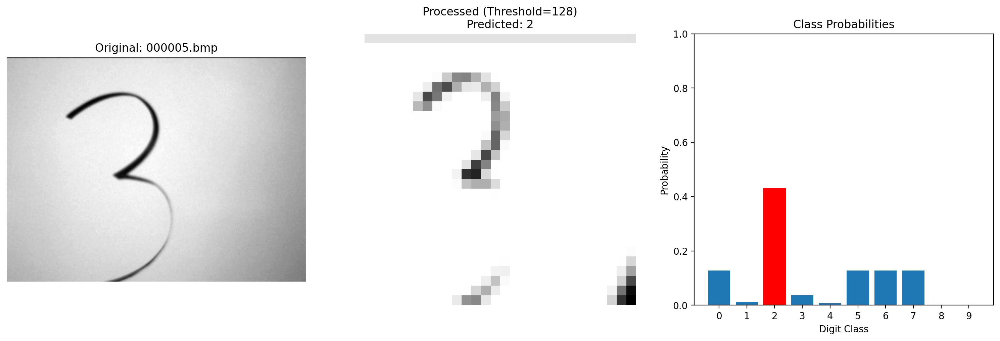


Results for 000005.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1276
  Class 1: 0.0112
  Class 2: 0.4303
  Class 3: 0.0378
  Class 4: 0.0075
  Class 5: 0.1276
  Class 6: 0.1276
  Class 7: 0.1276
  Class 8: 0.0015
  Class 9: 0.0015


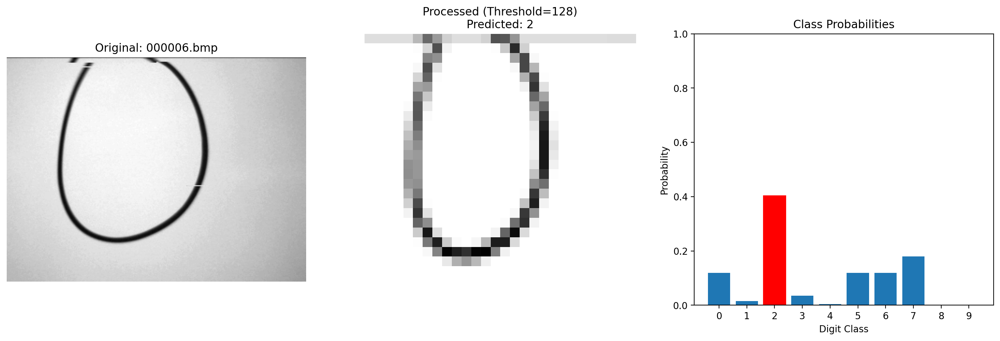


Results for 000006.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


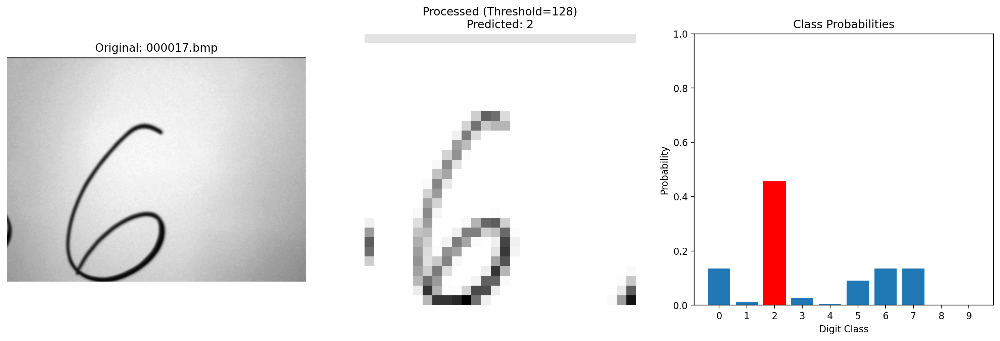


Results for 000017.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1354
  Class 1: 0.0119
  Class 2: 0.4565
  Class 3: 0.0268
  Class 4: 0.0053
  Class 5: 0.0903
  Class 6: 0.1354
  Class 7: 0.1354
  Class 8: 0.0016
  Class 9: 0.0016


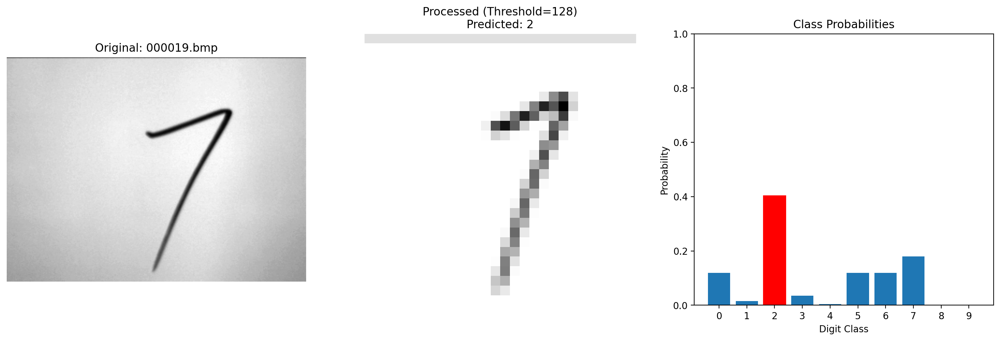


Results for 000019.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


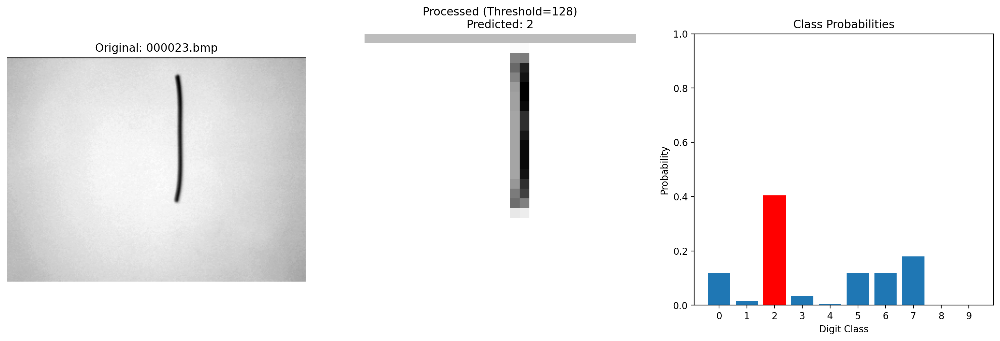


Results for 000023.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


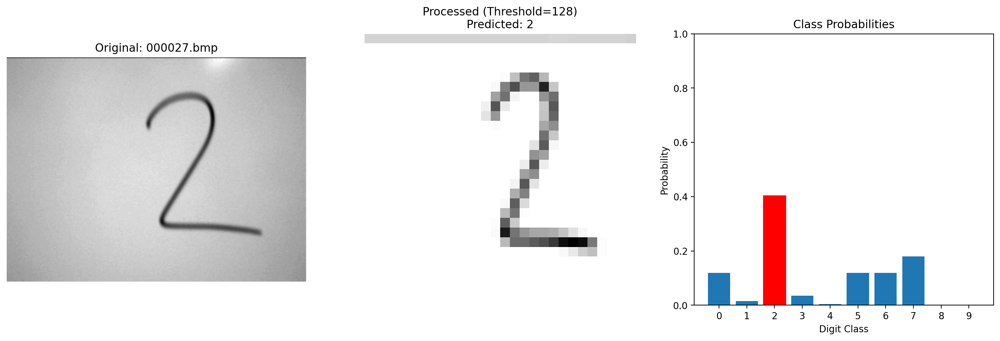


Results for 000027.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


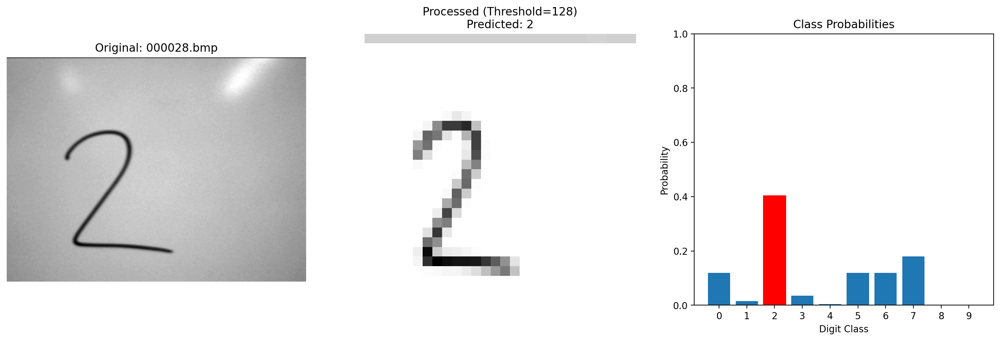


Results for 000028.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


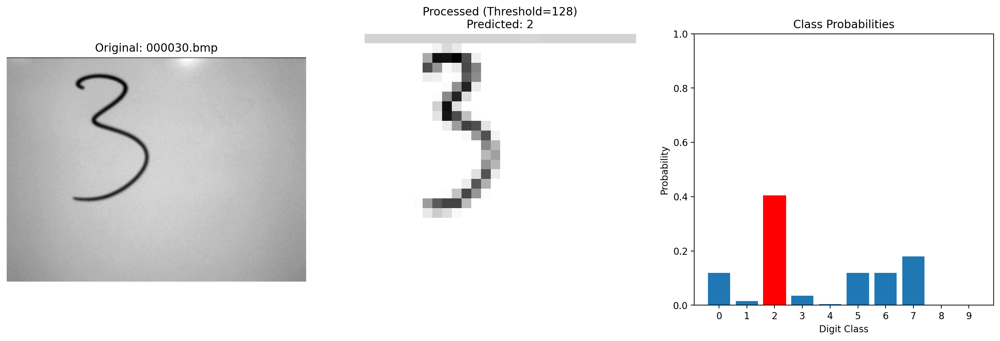


Results for 000030.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


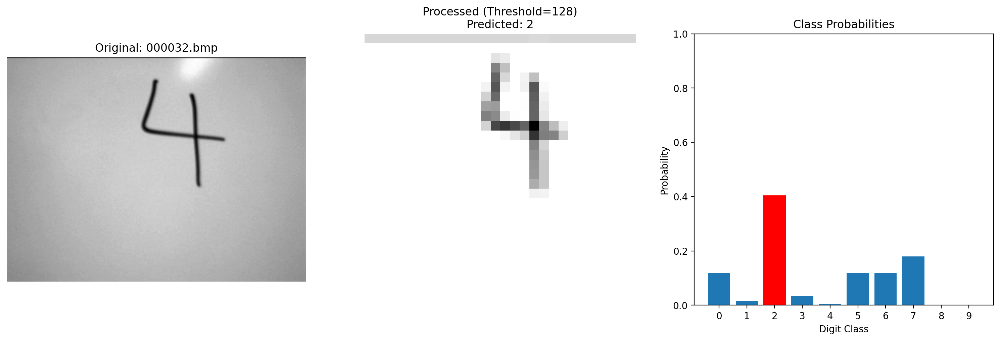


Results for 000032.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


In [43]:
# Cell to test quantized MLP on individual images with fixed path
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms
import torch

# Set the fixed path to your image folder
image_folder = "../../select_digits"

# Define threshold (0-255 scale for grayscale images)
THRESHOLD = 128  # Adjust this value to fine-tune the effect

# Define a border width for making the border all white
Bord

# Check if the path exists
if not os.path.exists(image_folder):
    print(f"Error: The path '{image_folder}' does not exist.")
else:
    # Get all image files from the folder
    try:
        image_files = [f for f in os.listdir(image_folder)
                      if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp'))]

        if not image_files:
            print(f"No image files found in {image_folder}")
        else:
            print(f"Found {len(image_files)} images to process")

            # Use the quantized model
            try:
                # Assuming your quantized model is stored in a variable called 'quantized_model'
                model = quantized_model  # Or use model.model if using MLP_extended instance

                # Ensure model is in evaluation mode
                model.eval()

                # Define a custom transformation function
                class ThresholdGrayscaleTransform:
                    def __init__(self, threshold=THRESHOLD):
                        self.threshold = threshold

                    def __call__(self, img):
                        """
                        Apply thresholding to make everything below the threshold white,
                        while keeping everything above it in grayscale.
                        """
                        img_np = np.array(img)  # Convert to NumPy array (0-255 grayscale)

                        # Apply threshold: set values below threshold to 255 (white)
                        img_np[img_np > self.threshold] = 255  # Make background pure white

                        # Convert back to PIL Image
                        img = Image.fromarray(img_np)

                        # Resize to 28x28 and normalize
                        transform = transforms.Compose([
                            transforms.Resize((28, 28)),
                            transforms.ToTensor(),
                            transforms.Normalize((0.5,), (0.5,))  # Normalize to [-1,1]
                        ])
                        return transform(img)

                # Define transformation pipeline
                transform = ThresholdGrayscaleTransform(threshold=THRESHOLD)

                # Process each image
                for img_file in image_files:
                    img_path = os.path.join(image_folder, img_file)

                    try:
                        # Load the original image
                        original_img = Image.open(img_path).convert('L')  # Convert to grayscale

                        # Apply thresholding transform
                        img_tensor = transform(original_img)
                        processed_img_np = img_tensor.squeeze().numpy()

                        # Add batch dimension for model input
                        input_tensor = img_tensor.unsqueeze(0)

                        # Run inference
                        with torch.no_grad():
                            outputs = model(input_tensor)
                            log_probs = outputs
                            probs = torch.exp(log_probs)
                            _, predicted_class = torch.max(probs, 1)

                        # Convert to numpy for visualization
                        probabilities = probs.squeeze().numpy()

                        # Display results
                        plt.figure(figsize=(15, 5))

                        # Display the original image
                        plt.subplot(1, 3, 1)
                        plt.imshow(np.array(original_img), cmap='gray')
                        plt.title(f"Original: {img_file}")
                        plt.axis('off')

                        # Display the processed image (Threshold Applied)
                        plt.subplot(1, 3, 2)
                        plt.imshow(processed_img_np, cmap='gray')
                        plt.title(f"Processed (Threshold={THRESHOLD})\nPredicted: {predicted_class.item()}")
                        plt.axis('off')

                        # Display probability distribution
                        plt.subplot(1, 3, 3)
                        bars = plt.bar(range(10), probabilities)
                        plt.title("Class Probabilities")
                        plt.xlabel("Digit Class")
                        plt.ylabel("Probability")
                        plt.xticks(range(10))
                        plt.ylim(0, 1.0)  # Set y-axis from 0 to 1 for probabilities

                        # Highlight the predicted class
                        bars[predicted_class.item()].set_color('red')

                        plt.tight_layout()
                        plt.show()

                        # Print probabilities
                        print(f"\nResults for {img_file}:")
                        print(f"Predicted class: {predicted_class.item()}")
                        print("Class probabilities:")
                        for i, prob in enumerate(probabilities):
                            print(f"  Class {i}: {prob:.4f}")

                    except Exception as e:
                        print(f"Error processing image {img_file}: {e}")
                        continue

            except NameError:
                print("Error: 'quantized_model' not found. Please ensure your model is available.")
                print("If your model has a different name, modify line 'model = quantized_model'")

    except Exception as e:
        print(f"Error accessing image folder: {e}")


Found 9 images to process


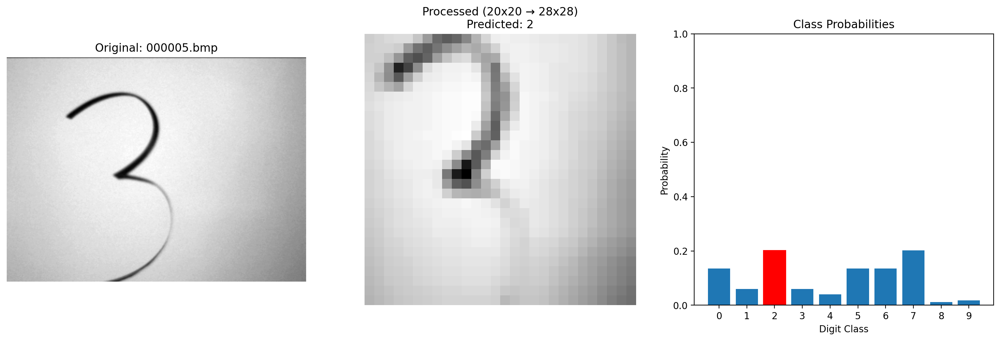


Results for 000005.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1350
  Class 1: 0.0600
  Class 2: 0.2025
  Class 3: 0.0600
  Class 4: 0.0400
  Class 5: 0.1350
  Class 6: 0.1350
  Class 7: 0.2025
  Class 8: 0.0119
  Class 9: 0.0178


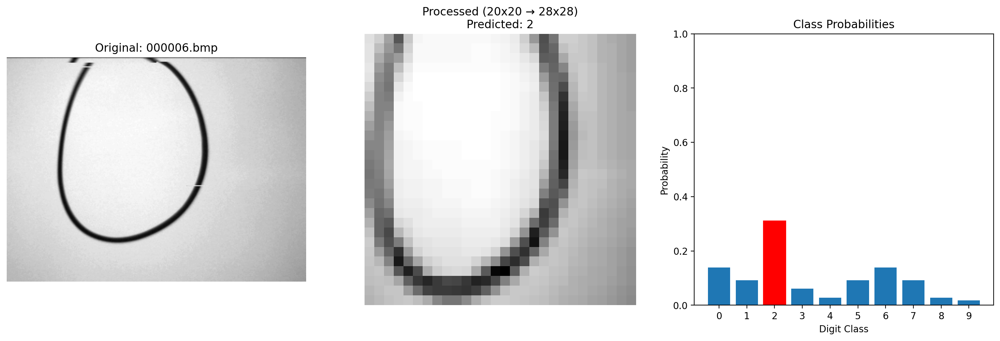


Results for 000006.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1385
  Class 1: 0.0923
  Class 2: 0.3114
  Class 3: 0.0616
  Class 4: 0.0274
  Class 5: 0.0923
  Class 6: 0.1385
  Class 7: 0.0923
  Class 8: 0.0274
  Class 9: 0.0183


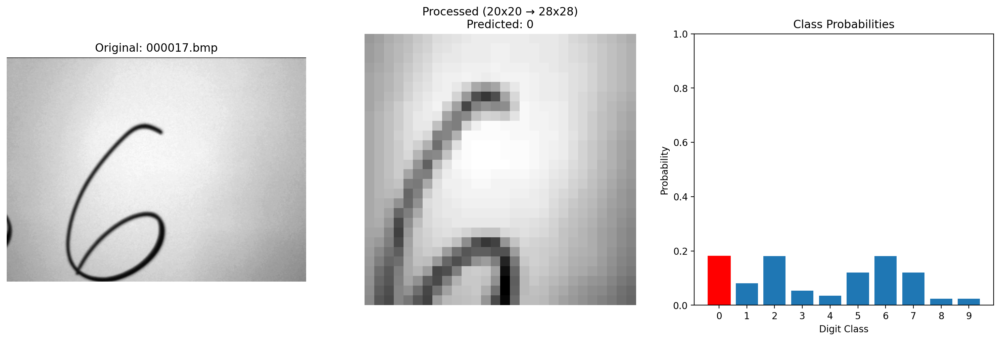


Results for 000017.bmp:
Predicted class: 0
Class probabilities:
  Class 0: 0.1806
  Class 1: 0.0803
  Class 2: 0.1806
  Class 3: 0.0536
  Class 4: 0.0357
  Class 5: 0.1204
  Class 6: 0.1806
  Class 7: 0.1204
  Class 8: 0.0238
  Class 9: 0.0238


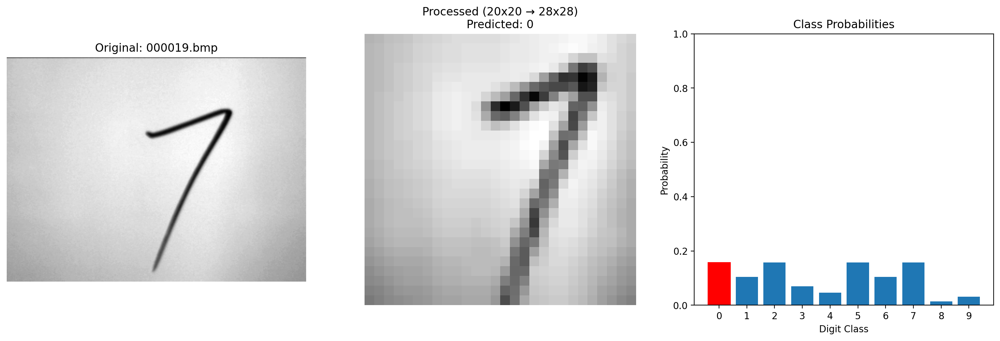


Results for 000019.bmp:
Predicted class: 0
Class probabilities:
  Class 0: 0.1572
  Class 1: 0.1048
  Class 2: 0.1572
  Class 3: 0.0699
  Class 4: 0.0466
  Class 5: 0.1572
  Class 6: 0.1048
  Class 7: 0.1572
  Class 8: 0.0138
  Class 9: 0.0311


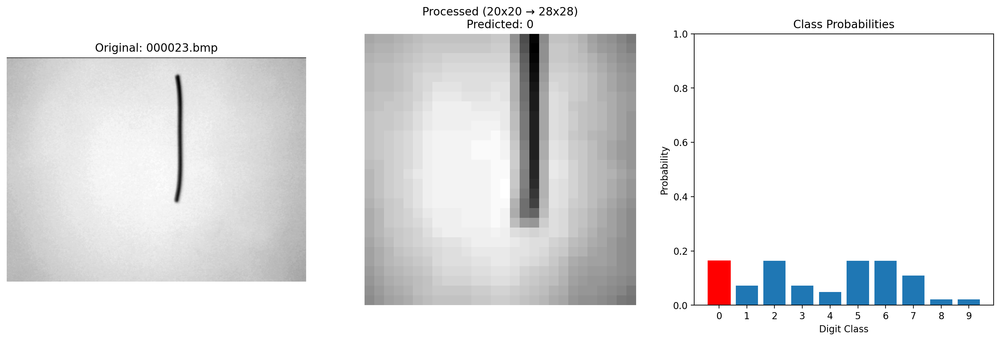


Results for 000023.bmp:
Predicted class: 0
Class probabilities:
  Class 0: 0.1635
  Class 1: 0.0727
  Class 2: 0.1635
  Class 3: 0.0727
  Class 4: 0.0485
  Class 5: 0.1635
  Class 6: 0.1635
  Class 7: 0.1090
  Class 8: 0.0216
  Class 9: 0.0216


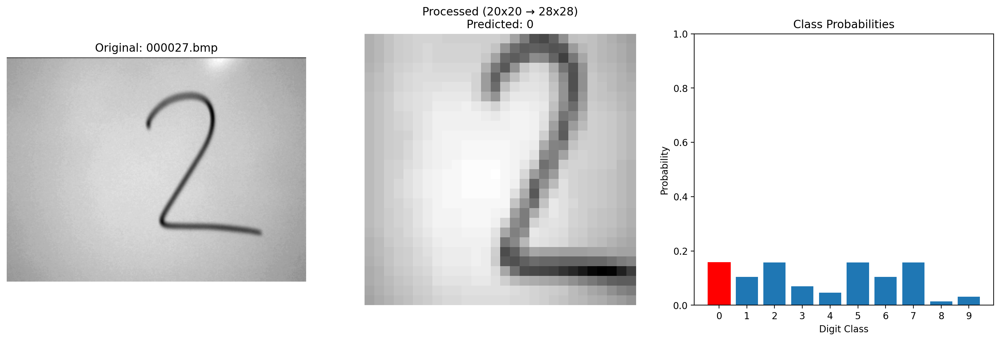


Results for 000027.bmp:
Predicted class: 0
Class probabilities:
  Class 0: 0.1572
  Class 1: 0.1048
  Class 2: 0.1572
  Class 3: 0.0699
  Class 4: 0.0466
  Class 5: 0.1572
  Class 6: 0.1048
  Class 7: 0.1572
  Class 8: 0.0138
  Class 9: 0.0311


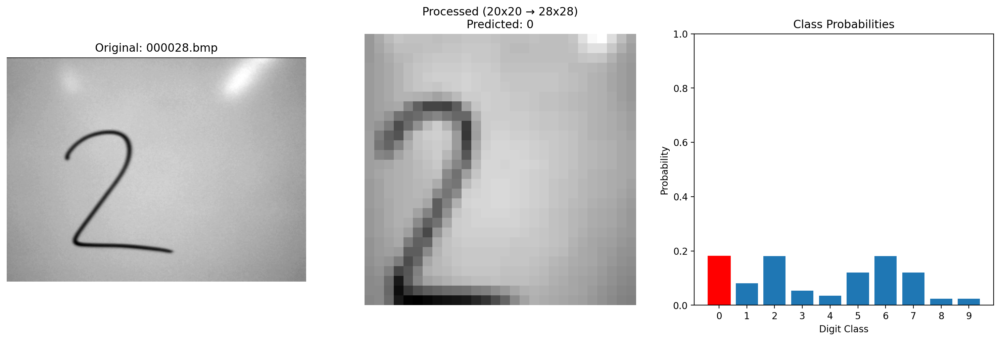


Results for 000028.bmp:
Predicted class: 0
Class probabilities:
  Class 0: 0.1806
  Class 1: 0.0803
  Class 2: 0.1806
  Class 3: 0.0536
  Class 4: 0.0357
  Class 5: 0.1204
  Class 6: 0.1806
  Class 7: 0.1204
  Class 8: 0.0238
  Class 9: 0.0238


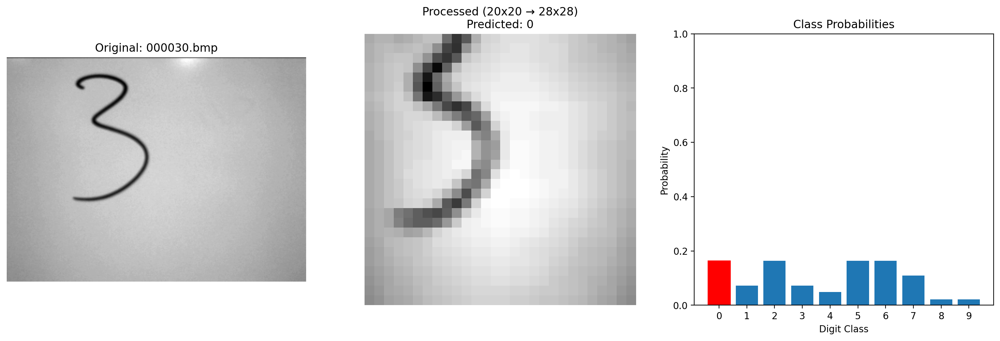


Results for 000030.bmp:
Predicted class: 0
Class probabilities:
  Class 0: 0.1635
  Class 1: 0.0727
  Class 2: 0.1635
  Class 3: 0.0727
  Class 4: 0.0485
  Class 5: 0.1635
  Class 6: 0.1635
  Class 7: 0.1090
  Class 8: 0.0216
  Class 9: 0.0216


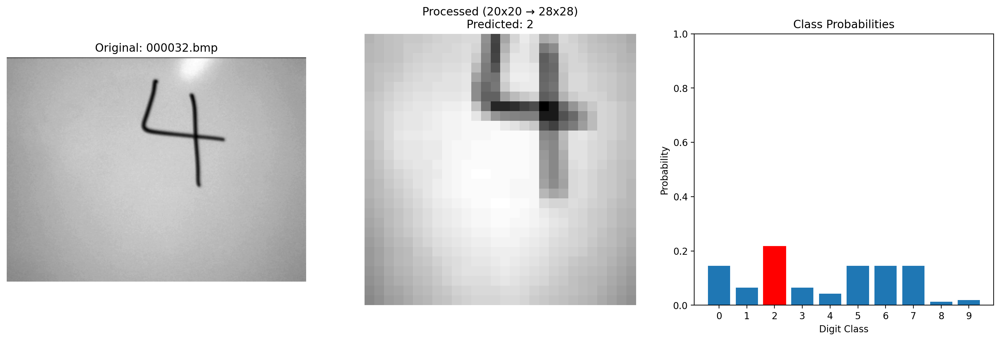


Results for 000032.bmp:
Predicted class: 2
Class probabilities:
  Class 0: 0.1448
  Class 1: 0.0644
  Class 2: 0.2172
  Class 3: 0.0644
  Class 4: 0.0429
  Class 5: 0.1448
  Class 6: 0.1448
  Class 7: 0.1448
  Class 8: 0.0127
  Class 9: 0.0191


In [38]:
# Cell to test quantized MLP on individual images with fixed path
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms
import torch

# Set the fixed path to your image folder
image_folder = "../../select_digits"

# Check if the path exists
if not os.path.exists(image_folder):
    print(f"Error: The path '{image_folder}' does not exist.")
else:
    # Get all image files from the folder
    try:
        image_files = [f for f in os.listdir(image_folder)
                      if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp'))]

        if not image_files:
            print(f"No image files found in {image_folder}")
        else:
            print(f"Found {len(image_files)} images to process")

            # Use the quantized model
            try:
                # Assuming your quantized model is stored in a variable called 'quantized_model'
                model = quantized_model  # Or use model.model if using MLP_extended instance

                # Ensure model is in evaluation mode
                model.eval()

                # Define image transformation - Crop 20x20 and resize back to 28x28
                transform = transforms.Compose([
                    transforms.Resize((28, 28)),  # Ensure uniform input size
                    transforms.CenterCrop(20),  # Crop center 20x20
                    transforms.Resize((28, 28)),  # Resize back to 28x28 for model
                    transforms.ToTensor(),
                    transforms.Normalize((0.5,), (0.5,))  # Normalize grayscale values
                ])

                # Process each image
                for img_file in image_files:
                    img_path = os.path.join(image_folder, img_file)

                    try:
                        # Load the original image
                        original_img = Image.open(img_path).convert('L')  # Convert to grayscale

                        # Apply transformations
                        img_tensor = transform(original_img)
                        processed_img_np = img_tensor.squeeze().numpy()

                        # Add batch dimension for model input
                        input_tensor = img_tensor.unsqueeze(0)

                        # Run inference
                        with torch.no_grad():
                            outputs = model(input_tensor)
                            log_probs = outputs
                            probs = torch.exp(log_probs)
                            _, predicted_class = torch.max(probs, 1)

                        # Convert to numpy for visualization
                        probabilities = probs.squeeze().numpy()

                        # Display results
                        plt.figure(figsize=(15, 5))

                        # Display the original image
                        plt.subplot(1, 3, 1)
                        plt.imshow(np.array(original_img), cmap='gray')
                        plt.title(f"Original: {img_file}")
                        plt.axis('off')

                        # Display the processed image (After Center Crop)
                        plt.subplot(1, 3, 2)
                        plt.imshow(processed_img_np, cmap='gray')
                        plt.title(f"Processed (20x20 → 28x28)\nPredicted: {predicted_class.item()}")
                        plt.axis('off')

                        # Display probability distribution
                        plt.subplot(1, 3, 3)
                        bars = plt.bar(range(10), probabilities)
                        plt.title("Class Probabilities")
                        plt.xlabel("Digit Class")
                        plt.ylabel("Probability")
                        plt.xticks(range(10))
                        plt.ylim(0, 1.0)  # Set y-axis from 0 to 1 for probabilities

                        # Highlight the predicted class
                        bars[predicted_class.item()].set_color('red')

                        plt.tight_layout()
                        plt.show()

                        # Print probabilities
                        print(f"\nResults for {img_file}:")
                        print(f"Predicted class: {predicted_class.item()}")
                        print("Class probabilities:")
                        for i, prob in enumerate(probabilities):
                            print(f"  Class {i}: {prob:.4f}")

                    except Exception as e:
                        print(f"Error processing image {img_file}: {e}")
                        continue

            except NameError:
                print("Error: 'quantized_model' not found. Please ensure your model is available.")
                print("If your model has a different name, modify line 'model = quantized_model'")

    except Exception as e:
        print(f"Error accessing image folder: {e}")


Found 9 images to process


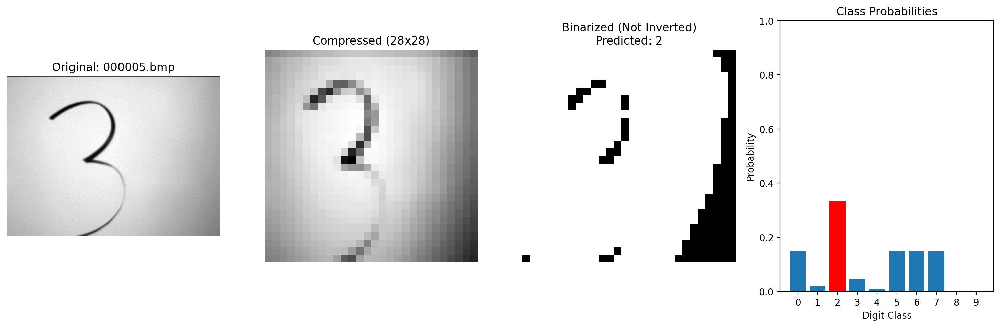


Results for 000005.bmp:
Predicted class: 2
Image processing: Binarized (threshold=155) and Not Inverted
Class probabilities:
  Class 0: 0.1478
  Class 1: 0.0195
  Class 2: 0.3324
  Class 3: 0.0438
  Class 4: 0.0087
  Class 5: 0.1478
  Class 6: 0.1478
  Class 7: 0.1478
  Class 8: 0.0017
  Class 9: 0.0026


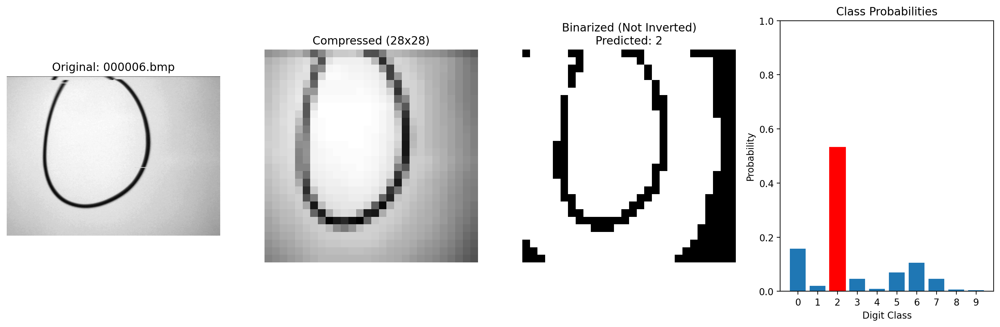


Results for 000006.bmp:
Predicted class: 2
Image processing: Binarized (threshold=155) and Not Inverted
Class probabilities:
  Class 0: 0.1579
  Class 1: 0.0208
  Class 2: 0.5326
  Class 3: 0.0468
  Class 4: 0.0093
  Class 5: 0.0702
  Class 6: 0.1053
  Class 7: 0.0468
  Class 8: 0.0062
  Class 9: 0.0041


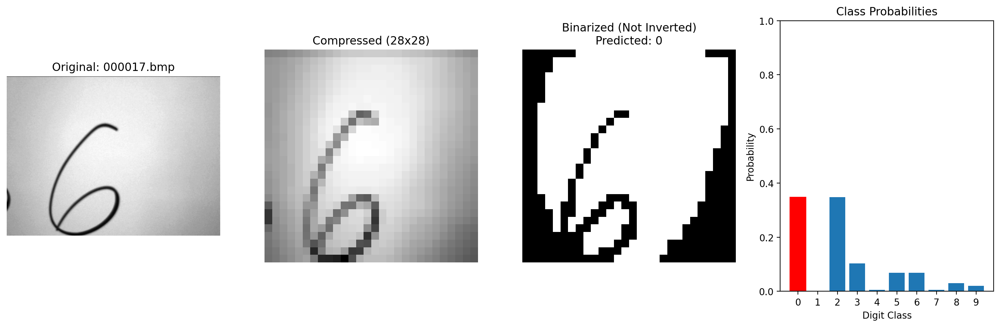


Results for 000017.bmp:
Predicted class: 0
Image processing: Binarized (threshold=155) and Not Inverted
Class probabilities:
  Class 0: 0.3474
  Class 1: 0.0018
  Class 2: 0.3474
  Class 3: 0.1030
  Class 4: 0.0060
  Class 5: 0.0687
  Class 6: 0.0687
  Class 7: 0.0060
  Class 8: 0.0305
  Class 9: 0.0204


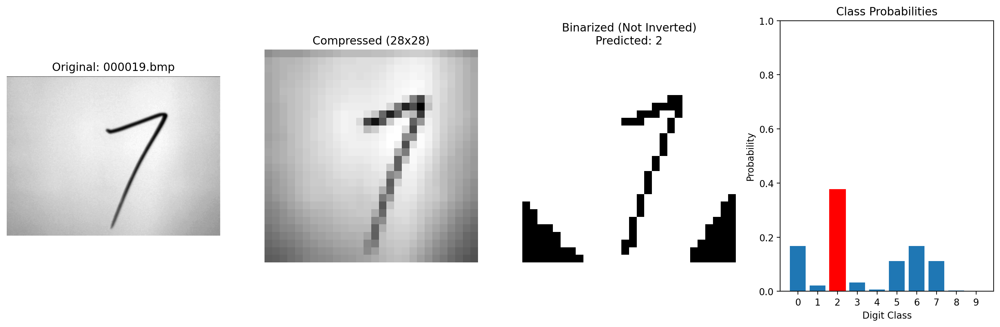


Results for 000019.bmp:
Predicted class: 2
Image processing: Binarized (threshold=155) and Not Inverted
Class probabilities:
  Class 0: 0.1672
  Class 1: 0.0220
  Class 2: 0.3761
  Class 3: 0.0331
  Class 4: 0.0065
  Class 5: 0.1115
  Class 6: 0.1672
  Class 7: 0.1115
  Class 8: 0.0029
  Class 9: 0.0019


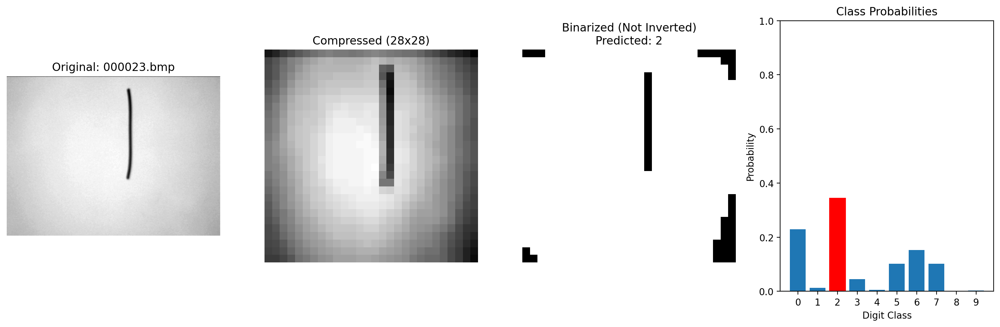


Results for 000023.bmp:
Predicted class: 2
Image processing: Binarized (threshold=155) and Not Inverted
Class probabilities:
  Class 0: 0.2295
  Class 1: 0.0135
  Class 2: 0.3442
  Class 3: 0.0454
  Class 4: 0.0060
  Class 5: 0.1020
  Class 6: 0.1530
  Class 7: 0.1020
  Class 8: 0.0018
  Class 9: 0.0027


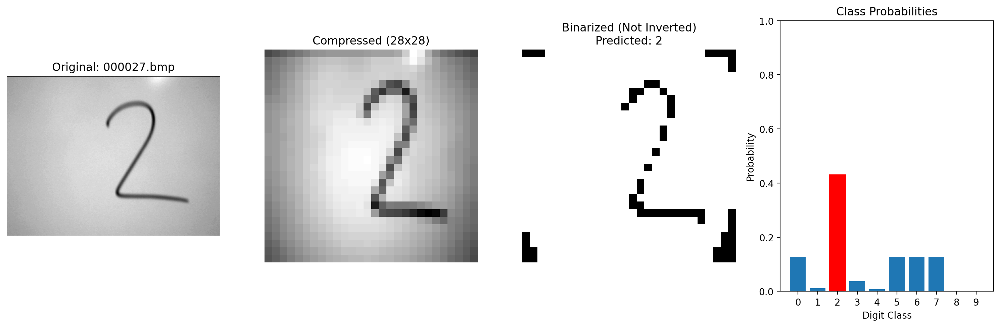


Results for 000027.bmp:
Predicted class: 2
Image processing: Binarized (threshold=155) and Not Inverted
Class probabilities:
  Class 0: 0.1276
  Class 1: 0.0112
  Class 2: 0.4303
  Class 3: 0.0378
  Class 4: 0.0075
  Class 5: 0.1276
  Class 6: 0.1276
  Class 7: 0.1276
  Class 8: 0.0015
  Class 9: 0.0015


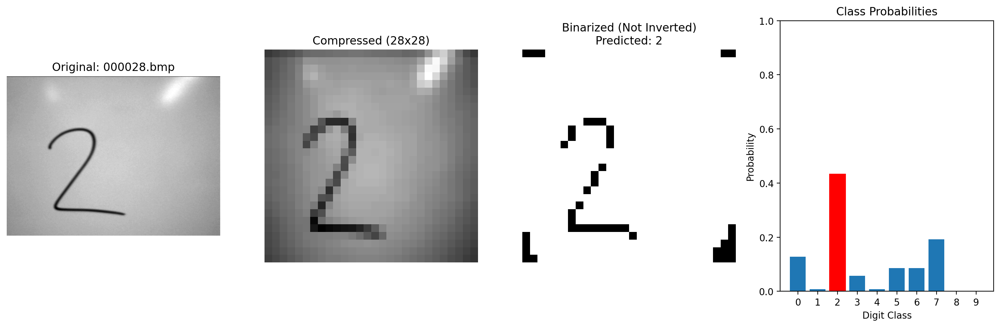


Results for 000028.bmp:
Predicted class: 2
Image processing: Binarized (threshold=155) and Not Inverted
Class probabilities:
  Class 0: 0.1283
  Class 1: 0.0075
  Class 2: 0.4328
  Class 3: 0.0571
  Class 4: 0.0075
  Class 5: 0.0856
  Class 6: 0.0856
  Class 7: 0.1924
  Class 8: 0.0010
  Class 9: 0.0022


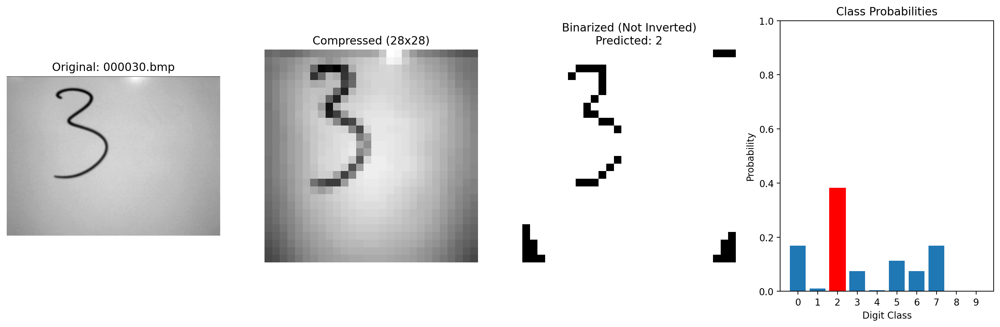


Results for 000030.bmp:
Predicted class: 2
Image processing: Binarized (threshold=155) and Not Inverted
Class probabilities:
  Class 0: 0.1693
  Class 1: 0.0099
  Class 2: 0.3808
  Class 3: 0.0753
  Class 4: 0.0044
  Class 5: 0.1129
  Class 6: 0.0753
  Class 7: 0.1693
  Class 8: 0.0009
  Class 9: 0.0020


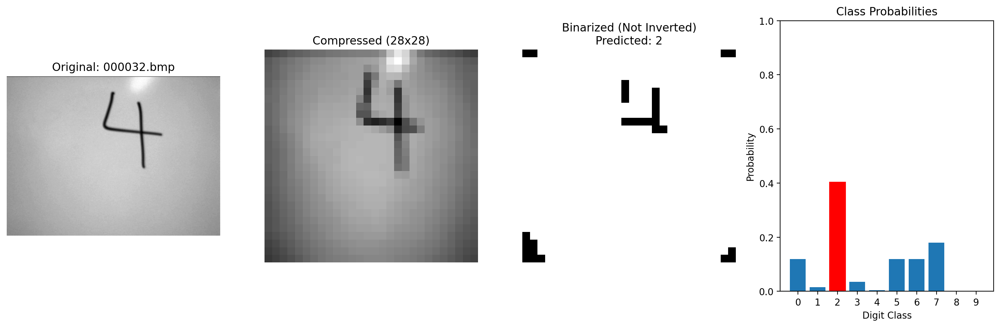


Results for 000032.bmp:
Predicted class: 2
Image processing: Binarized (threshold=155) and Not Inverted
Class probabilities:
  Class 0: 0.1196
  Class 1: 0.0158
  Class 2: 0.4035
  Class 3: 0.0355
  Class 4: 0.0047
  Class 5: 0.1196
  Class 6: 0.1196
  Class 7: 0.1794
  Class 8: 0.0009
  Class 9: 0.0014


In [37]:
# Cell to test quantized MLP on individual images with fixed path
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms
import torch

# Set the fixed path to your image folder
image_folder = "../../select_digits"

# Define threshold for binarization (0-255 for grayscale images)
# You can adjust this value as needed (128 is middle of the range)
THRESHOLD = 155

# Whether to invert colors (true = reverse black and white)
INVERT_COLORS = False

# Check if the path exists
if not os.path.exists(image_folder):
    print(f"Error: The path '{image_folder}' does not exist.")
else:
    # Get all image files from the folder
    try:
        image_files = [f for f in os.listdir(image_folder)
                      if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp'))]

        if not image_files:
            print(f"No image files found in {image_folder}")
        else:
            print(f"Found {len(image_files)} images to process")

            # Use the quantized model
            try:
                # Assuming your quantized model is stored in a variable called 'quantized_model'
                model = quantized_model  # Or use model.model if using MLP_extended instance

                # Ensure model is in evaluation mode
                model.eval()

                # Define image transformation - adjust size to match your model's input dimensions
                input_size = (28, 28)  # Change this to match your model's expected input size

                # Define custom binarization transform
                class Binarize(object):
                    def __init__(self, threshold=THRESHOLD/255.0, invert=INVERT_COLORS):
                        self.threshold = threshold
                        self.invert = invert

                    def __call__(self, tensor):
                        # Apply threshold - values below threshold become 0, above become 1
                        binary = (tensor > self.threshold).float()

                        # Invert colors if requested (1 becomes 0, 0 becomes 1)
                        if self.invert:
                            return 1.0 - binary
                        return binary

                # Define transforms for original tensor (before binarization)
                transform = transforms.Compose([
                    transforms.Resize(input_size),
                    transforms.ToTensor(),
                    # Add normalization if your model was trained with it
                    # transforms.Normalize((0.5,), (0.5,))
                ])

                # Define transforms with binarization
                binary_transform = transforms.Compose([
                    transforms.Resize(input_size),
                    transforms.ToTensor(),
                    Binarize(THRESHOLD/255.0, INVERT_COLORS)  # Apply binarization with inversion
                    # No normalization after binarization
                ])

                # Process each image
                for img_file in image_files:
                    img_path = os.path.join(image_folder, img_file)

                    try:
                        # Load the original image
                        original_img = Image.open(img_path).convert('L')  # Convert to grayscale

                        # Apply transformations to get the compressed version (without binarization)
                        img_tensor = transform(original_img)
                        compressed_img = img_tensor.squeeze().numpy()

                        # Apply binary transformation with color inversion
                        binary_tensor = binary_transform(original_img)
                        binary_img = binary_tensor.squeeze().numpy()

                        # Add batch dimension for model input (use binary image for inference)
                        input_tensor = binary_tensor.unsqueeze(0)

                        # Run inference
                        with torch.no_grad():
                            outputs = model(input_tensor)
                            log_probs = outputs
                            probs = torch.exp(log_probs)
                            _, predicted_class = torch.max(probs, 1)

                        # Convert to numpy for visualization
                        probabilities = probs.squeeze().numpy()

                        # Display results
                        plt.figure(figsize=(15, 5))

                        # Display the original image
                        plt.subplot(1, 4, 1)
                        plt.imshow(np.array(original_img), cmap='gray')
                        plt.title(f"Original: {img_file}")
                        plt.axis('off')

                        # Display the compressed image (without binarization)
                        plt.subplot(1, 4, 2)
                        plt.imshow(compressed_img, cmap='gray')
                        plt.title(f"Compressed ({input_size[0]}x{input_size[1]})")
                        plt.axis('off')

                        # Display the binary image
                        plt.subplot(1, 4, 3)
                        plt.imshow(binary_img, cmap='gray')
                        invert_status = "Inverted" if INVERT_COLORS else "Not Inverted"
                        plt.title(f"Binarized ({invert_status})\nPredicted: {predicted_class.item()}")
                        plt.axis('off')

                        # Display probability distribution
                        plt.subplot(1, 4, 4)
                        bars = plt.bar(range(10), probabilities)
                        plt.title("Class Probabilities")
                        plt.xlabel("Digit Class")
                        plt.ylabel("Probability")
                        plt.xticks(range(10))
                        plt.ylim(0, 1.0)  # Set y-axis from 0 to 1 for probabilities

                        # Highlight the predicted class
                        bars[predicted_class.item()].set_color('red')

                        plt.tight_layout()
                        plt.show()

                        # Print probabilities
                        print(f"\nResults for {img_file}:")
                        print(f"Predicted class: {predicted_class.item()}")
                        print(f"Image processing: Binarized (threshold={THRESHOLD}) and {invert_status}")
                        print("Class probabilities:")
                        for i, prob in enumerate(probabilities):
                            print(f"  Class {i}: {prob:.4f}")

                    except Exception as e:
                        print(f"Error processing image {img_file}: {e}")
                        continue

            except NameError:
                print("Error: 'quantized_model' not found. Please ensure your model is available.")
                print("If your model has a different name, modify line 'model = quantized_model'")

    except Exception as e:
        print(f"Error accessing image folder: {e}")

Found 9 images to process


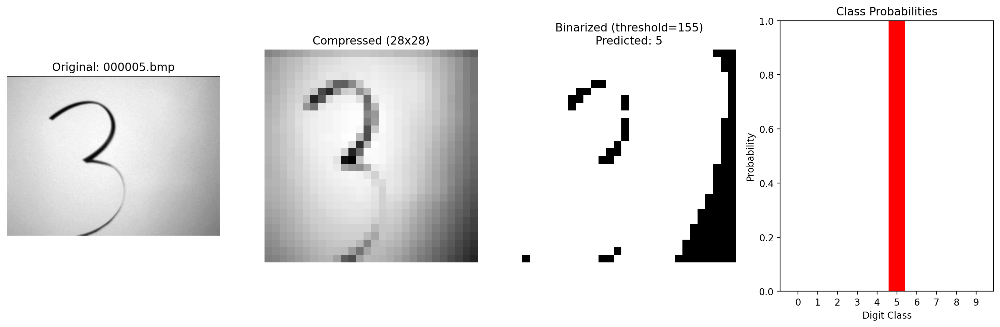


Results for 000005.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0000
  Class 4: 0.0000
  Class 5: 1.0000
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


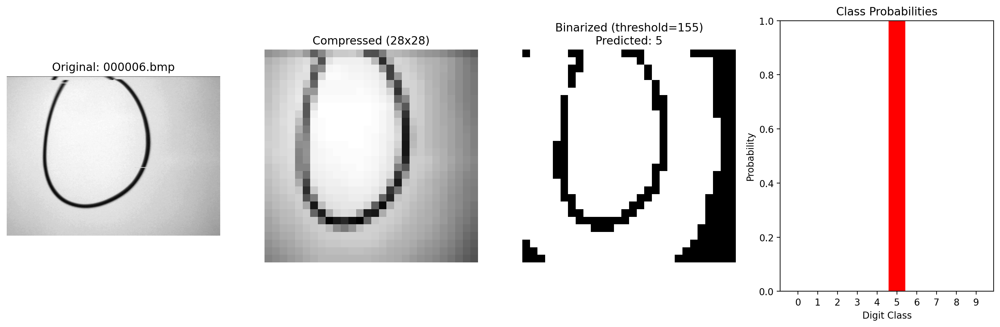


Results for 000006.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0000
  Class 4: 0.0000
  Class 5: 1.0000
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


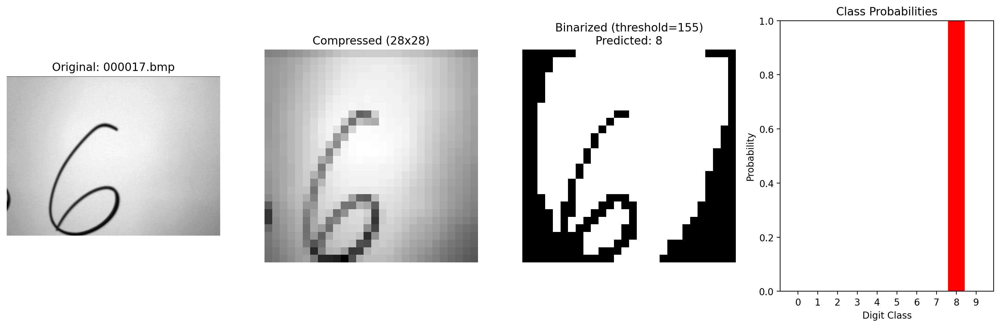


Results for 000017.bmp:
Predicted class: 8
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0000
  Class 4: 0.0000
  Class 5: 0.0001
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.9999
  Class 9: 0.0000


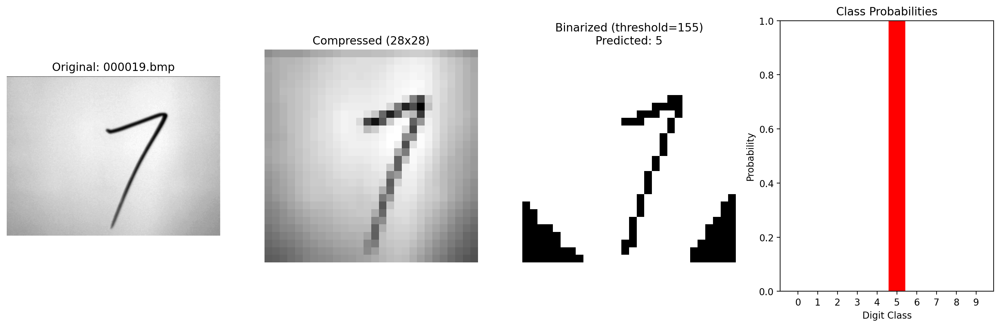


Results for 000019.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0000
  Class 4: 0.0000
  Class 5: 1.0000
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


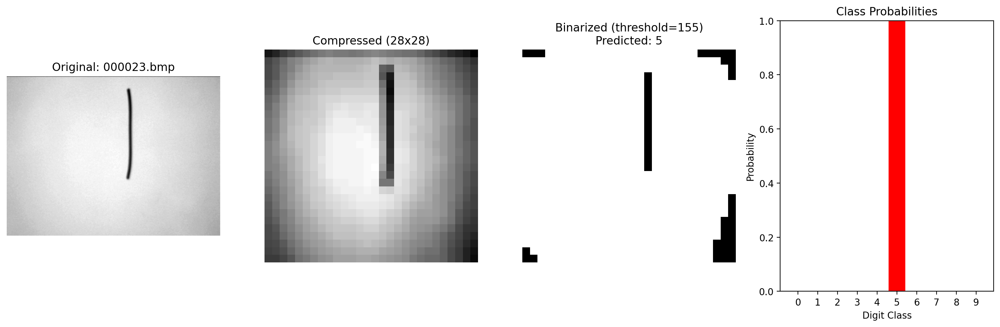


Results for 000023.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0000
  Class 4: 0.0000
  Class 5: 1.0000
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


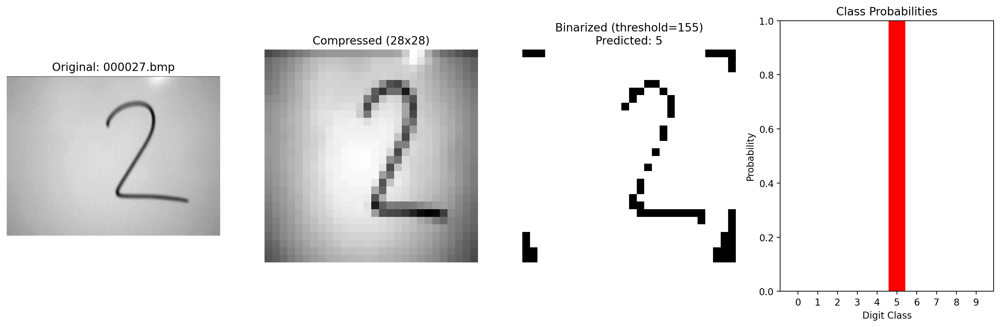


Results for 000027.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0011
  Class 4: 0.0000
  Class 5: 0.9989
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


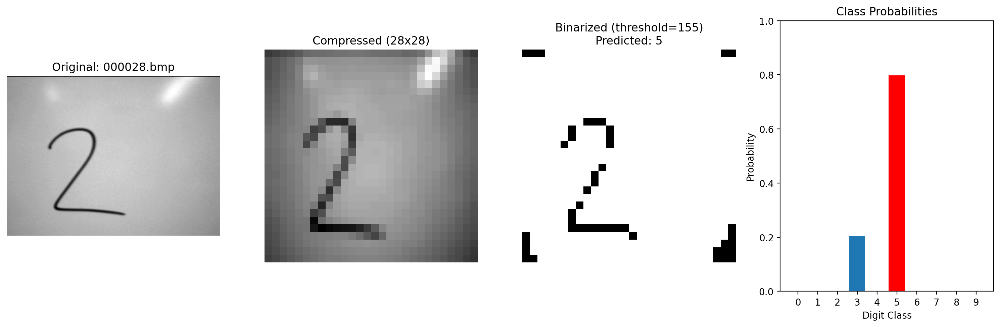


Results for 000028.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.2038
  Class 4: 0.0000
  Class 5: 0.7962
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


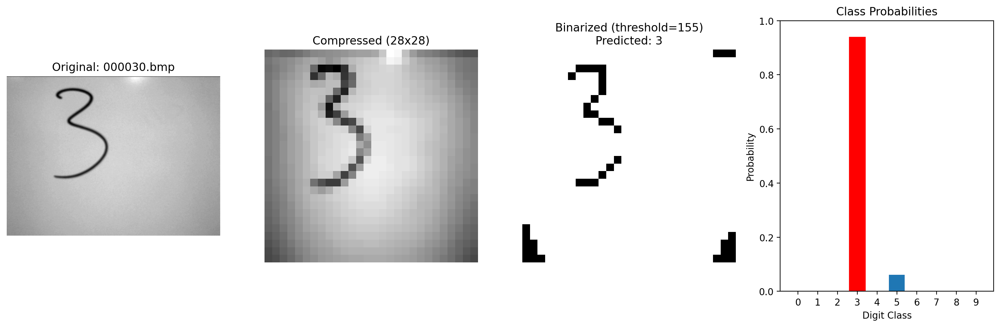


Results for 000030.bmp:
Predicted class: 3
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.9385
  Class 4: 0.0000
  Class 5: 0.0615
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


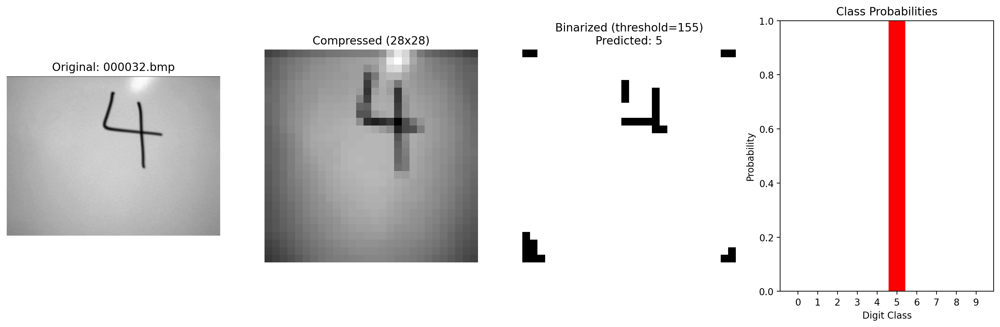


Results for 000032.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0000
  Class 4: 0.0000
  Class 5: 1.0000
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


In [ ]:
# Cell to test quantized MLP on individual images with fixed path
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms
import torch

# Set the fixed path to your image folder
image_folder = "../../select_digits"

# Define threshold for binarization (0-255 for grayscale images)
# You can adjust this value as needed (128 is middle of the range)
THRESHOLD = 155

# Check if the path exists
if not os.path.exists(image_folder):
    print(f"Error: The path '{image_folder}' does not exist.")
else:
    # Get all image files from the folder
    try:
        image_files = [f for f in os.listdir(image_folder)
                      if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp'))]

        if not image_files:
            print(f"No image files found in {image_folder}")
        else:
            print(f"Found {len(image_files)} images to process")

            # Use the quantized model
            try:
                # Assuming your quantized model is stored in a variable called 'quantized_model'
                model = quantized_model  # Or use model.model if using MLP_extended instance

                # Ensure model is in evaluation mode
                model.eval()

                # Define image transformation - adjust size to match your model's input dimensions
                input_size = (28, 28)  # Change this to match your model's expected input size

                # Define custom binarization transform
                class Binarize(object):
                    def __init__(self, threshold=THRESHOLD/255.0):  # Normalize threshold to 0-1 range
                        self.threshold = threshold

                    def __call__(self, tensor):
                        # Apply threshold - values below threshold become 0, above become 1
                        return (tensor > self.threshold).float()

                # Define transforms for original tensor (before binarization)
                transform = transforms.Compose([
                    transforms.Resize(input_size),
                    transforms.ToTensor(),
                    # Add normalization if your model was trained with it
                    # transforms.Normalize((0.5,), (0.5,))
                ])

                # Define transforms with binarization
                binary_transform = transforms.Compose([
                    transforms.Resize(input_size),
                    transforms.ToTensor(),
                    Binarize(THRESHOLD/255.0)  # Apply binarization
                    # No normalization after binarization
                ])

                # Process each image
                for img_file in image_files:
                    img_path = os.path.join(image_folder, img_file)

                    try:
                        # Load the original image
                        original_img = Image.open(img_path).convert('L')  # Convert to grayscale

                        # Apply transformations to get the compressed version (without binarization)
                        img_tensor = transform(original_img)
                        compressed_img = img_tensor.squeeze().numpy()

                        # Apply binary transformation
                        binary_tensor = binary_transform(original_img)
                        binary_img = binary_tensor.squeeze().numpy()

                        # Add batch dimension for model input (use binary image for inference)
                        input_tensor = binary_tensor.unsqueeze(0)

                        # Run inference
                        with torch.no_grad():
                            outputs = model(input_tensor)
                            log_probs = outputs
                            probs = torch.exp(log_probs)
                            _, predicted_class = torch.max(probs, 1)

                        # Convert to numpy for visualization
                        probabilities = probs.squeeze().numpy()

                        # Display results
                        plt.figure(figsize=(15, 5))

                        # Display the original image
                        plt.subplot(1, 4, 1)
                        plt.imshow(np.array(original_img), cmap='gray')
                        plt.title(f"Original: {img_file}")
                        plt.axis('off')

                        # Display the compressed image (without binarization)
                        plt.subplot(1, 4, 2)
                        plt.imshow(compressed_img, cmap='gray')
                        plt.title(f"Compressed ({input_size[0]}x{input_size[1]})")
                        plt.axis('off')

                        # Display the binary image
                        plt.subplot(1, 4, 3)
                        plt.imshow(binary_img, cmap='gray')
                        plt.title(f"Binarized (threshold={THRESHOLD})\nPredicted: {predicted_class.item()}")
                        plt.axis('off')

                        # Display probability distribution
                        plt.subplot(1, 4, 4)
                        bars = plt.bar(range(10), probabilities)
                        plt.title("Class Probabilities")
                        plt.xlabel("Digit Class")
                        plt.ylabel("Probability")
                        plt.xticks(range(10))
                        plt.ylim(0, 1.0)  # Set y-axis from 0 to 1 for probabilities

                        # Highlight the predicted class
                        bars[predicted_class.item()].set_color('red')

                        plt.tight_layout()
                        plt.show()

                        # Print probabilities
                        print(f"\nResults for {img_file}:")
                        print(f"Predicted class: {predicted_class.item()}")
                        print("Class probabilities:")
                        for i, prob in enumerate(probabilities):
                            print(f"  Class {i}: {prob:.4f}")

                    except Exception as e:
                        print(f"Error processing image {img_file}: {e}")
                        continue

            except NameError:
                print("Error: 'quantized_model' not found. Please ensure your model is available.")
                print("If your model has a different name, modify line 'model = quantized_model'")

    except Exception as e:
        print(f"Error accessing image folder: {e}")

Found 9 images to process


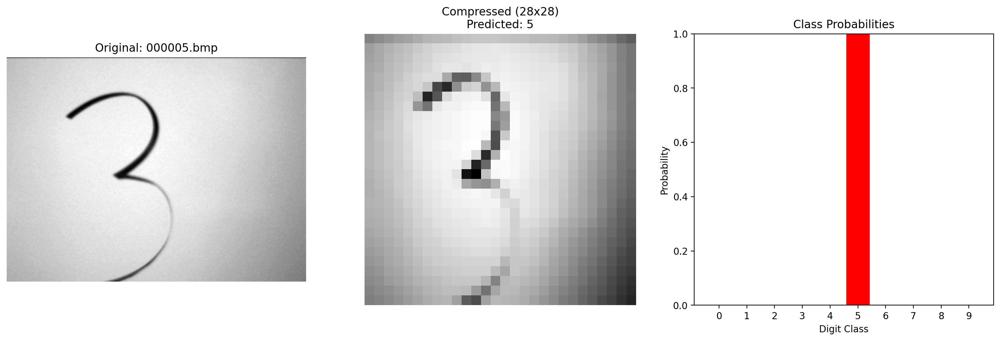


Results for 000005.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0001
  Class 4: 0.0000
  Class 5: 0.9999
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


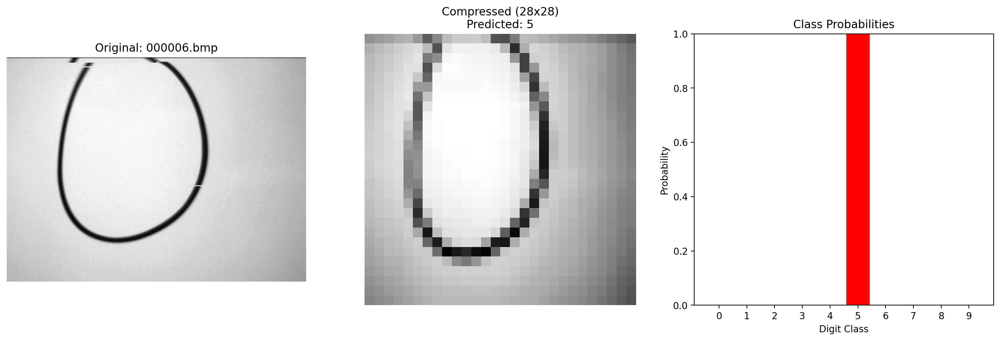


Results for 000006.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0022
  Class 4: 0.0000
  Class 5: 0.9978
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


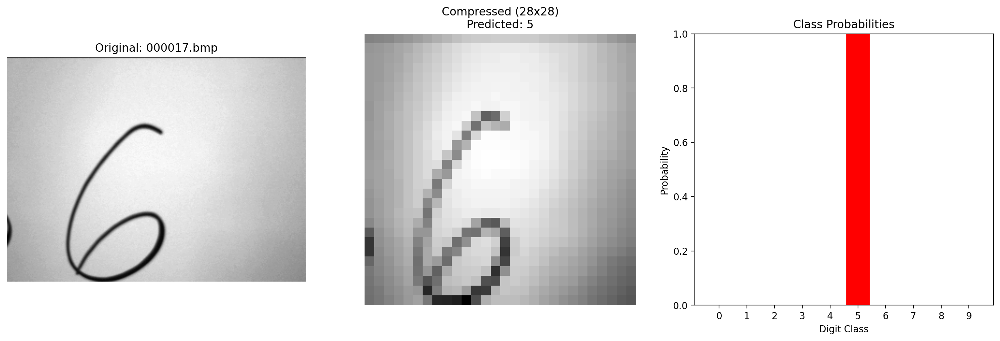


Results for 000017.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0006
  Class 4: 0.0000
  Class 5: 0.9994
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


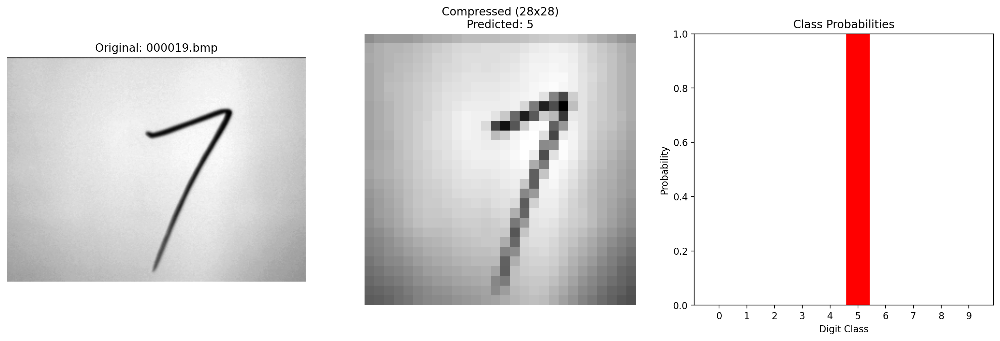


Results for 000019.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0000
  Class 4: 0.0000
  Class 5: 1.0000
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


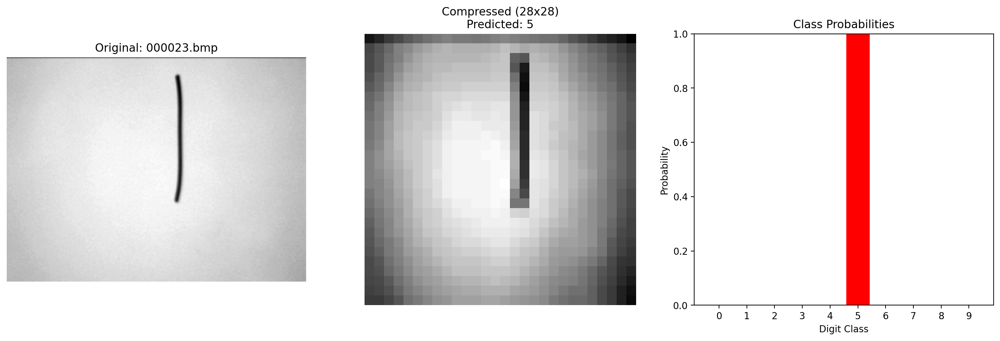


Results for 000023.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0022
  Class 4: 0.0000
  Class 5: 0.9978
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


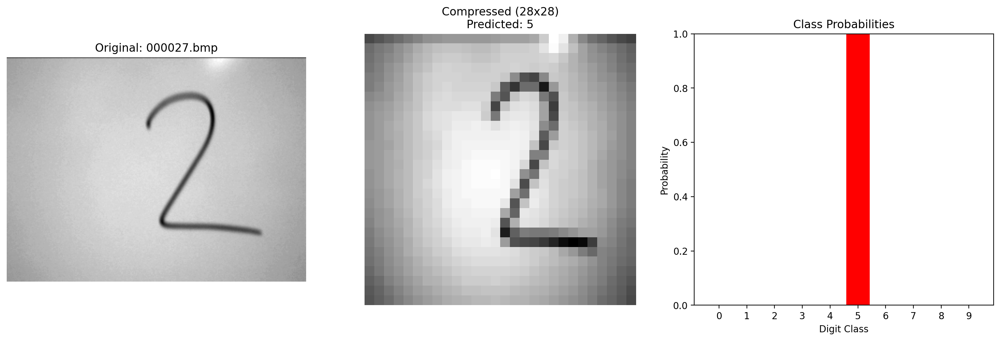


Results for 000027.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0022
  Class 4: 0.0000
  Class 5: 0.9978
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


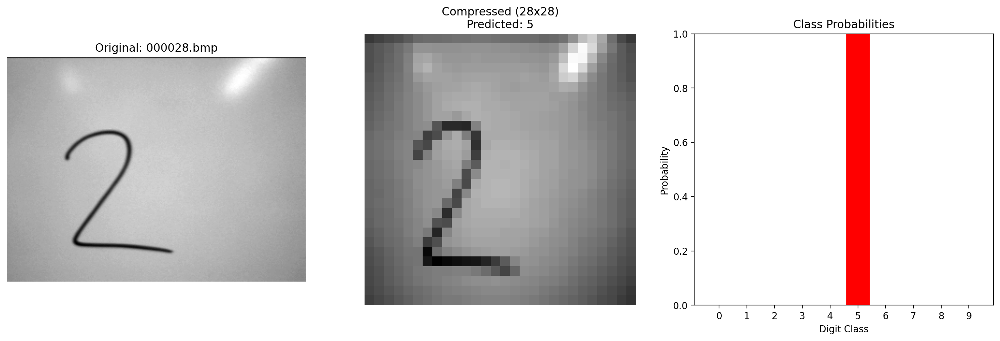


Results for 000028.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0003
  Class 4: 0.0000
  Class 5: 0.9997
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


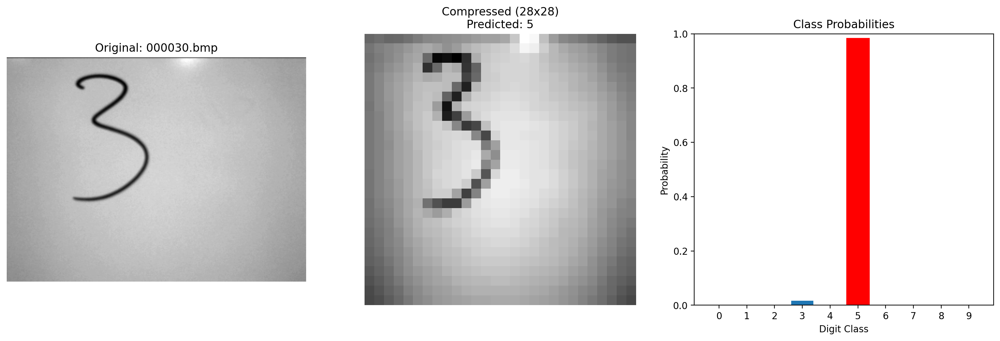


Results for 000030.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0165
  Class 4: 0.0000
  Class 5: 0.9835
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


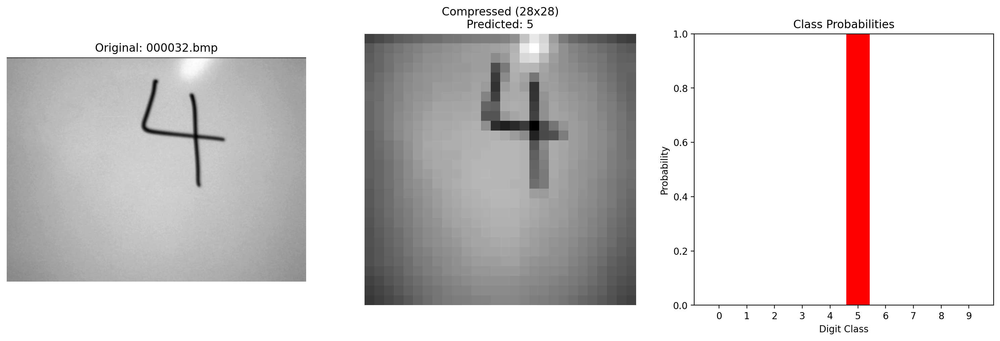


Results for 000032.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0001
  Class 4: 0.0000
  Class 5: 0.9999
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


In [61]:
# Cell to test quantized MLP on individual images with fixed path
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms
import torch

# Set the fixed path to your image folder
image_folder = "../../select_digits"

# Check if the path exists
if not os.path.exists(image_folder):
    print(f"Error: The path '{image_folder}' does not exist.")
else:
    # Get all image files from the folder
    try:
        image_files = [f for f in os.listdir(image_folder)
                      if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp'))]

        if not image_files:
            print(f"No image files found in {image_folder}")
        else:
            print(f"Found {len(image_files)} images to process")

            # Use the quantized model
            try:
                # Assuming your quantized model is stored in a variable called 'quantized_model'
                model = quantized_model  # Or use model.model if using MLP_extended instance

                # Ensure model is in evaluation mode
                model.eval()

                # Define image transformation - adjust size to match your model's input dimensions
                input_size = (28, 28)  # Change this to match your model's expected input size

                transform = transforms.Compose([
                    transforms.Resize(input_size),
                    transforms.ToTensor(),
                    # Add normalization if your model was trained with it
                    # transforms.Normalize((0.5,), (0.5,))
                ])

                # Process each image
                for img_file in image_files:
                    img_path = os.path.join(image_folder, img_file)

                    try:
                        # Load the original image
                        original_img = Image.open(img_path).convert('L')  # Convert to grayscale

                        # Apply transformations to get the compressed version
                        img_tensor = transform(original_img)

                        # Convert the tensor back to a numpy array for display
                        # This shows exactly what the model sees after compression/transformation
                        compressed_img = img_tensor.squeeze().numpy()

                        # Add batch dimension for model input
                        input_tensor = img_tensor.unsqueeze(0)

                        # Run inference
                        with torch.no_grad():
                            outputs = model(input_tensor)
                            log_probs = outputs
                            probs = torch.exp(log_probs)
                            _, predicted_class = torch.max(probs, 1)

                        # Convert to numpy for visualization
                        probabilities = probs.squeeze().numpy()

                        # Display results
                        plt.figure(figsize=(15, 5))

                        # Display the original image
                        plt.subplot(1, 3, 1)
                        plt.imshow(np.array(original_img), cmap='gray')
                        plt.title(f"Original: {img_file}")
                        plt.axis('off')

                        # Display the compressed image (what the model actually sees)
                        plt.subplot(1, 3, 2)
                        plt.imshow(compressed_img, cmap='gray')
                        plt.title(f"Compressed ({input_size[0]}x{input_size[1]})\nPredicted: {predicted_class.item()}")
                        plt.axis('off')

                        # Display probability distribution
                        plt.subplot(1, 3, 3)
                        bars = plt.bar(range(10), probabilities)
                        plt.title("Class Probabilities")
                        plt.xlabel("Digit Class")
                        plt.ylabel("Probability")
                        plt.xticks(range(10))
                        plt.ylim(0, 1.0)  # Set y-axis from 0 to 1 for probabilities

                        # Highlight the predicted class
                        bars[predicted_class.item()].set_color('red')

                        plt.tight_layout()
                        plt.show()

                        # Print probabilities
                        print(f"\nResults for {img_file}:")
                        print(f"Predicted class: {predicted_class.item()}")
                        print("Class probabilities:")
                        for i, prob in enumerate(probabilities):
                            print(f"  Class {i}: {prob:.4f}")

                    except Exception as e:
                        print(f"Error processing image {img_file}: {e}")
                        continue

            except NameError:
                print("Error: 'quantized_model' not found. Please ensure your model is available.")
                print("If your model has a different name, modify line 'model = quantized_model'")

    except Exception as e:
        print(f"Error accessing image folder: {e}")

Found 9 images to process


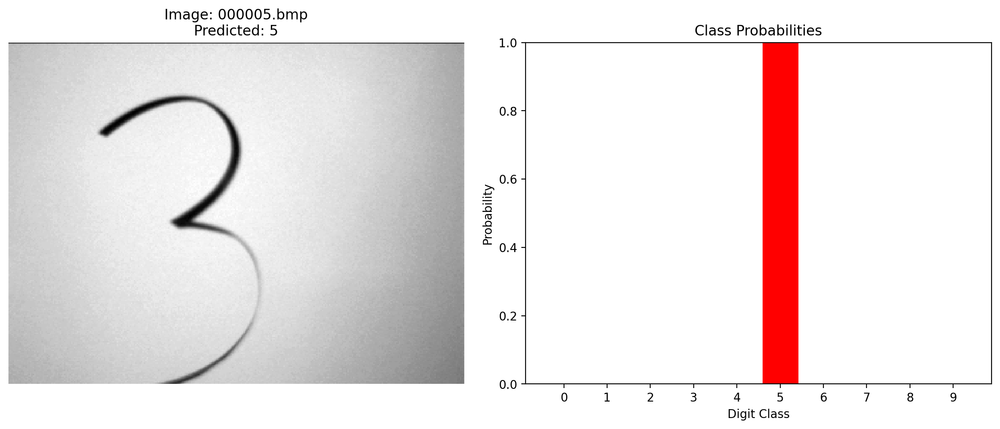


Results for 000005.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0001
  Class 4: 0.0000
  Class 5: 0.9999
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


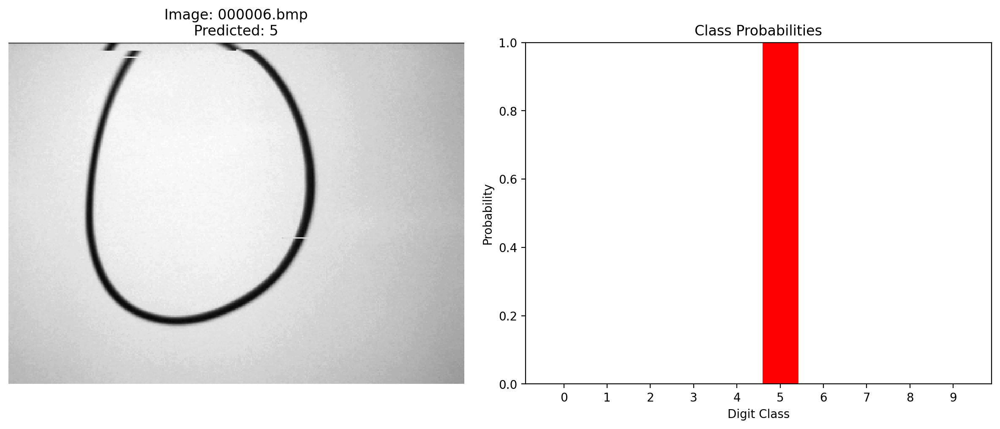


Results for 000006.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0022
  Class 4: 0.0000
  Class 5: 0.9978
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


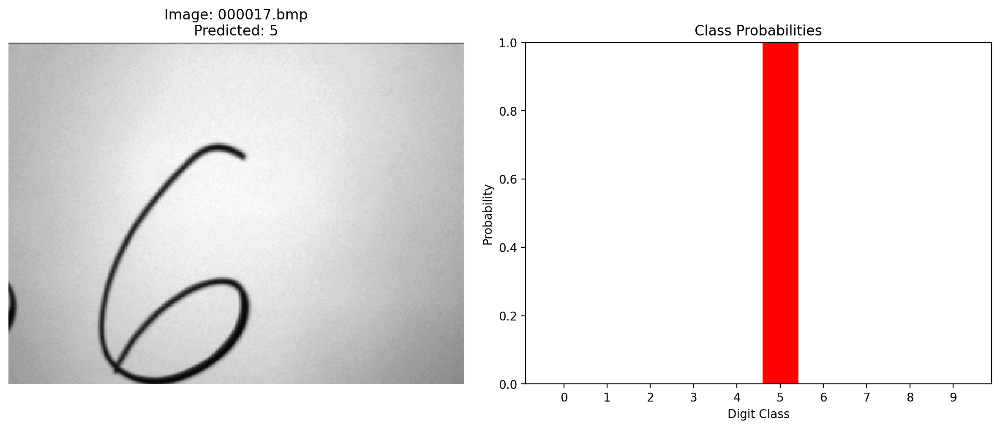


Results for 000017.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0006
  Class 4: 0.0000
  Class 5: 0.9994
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


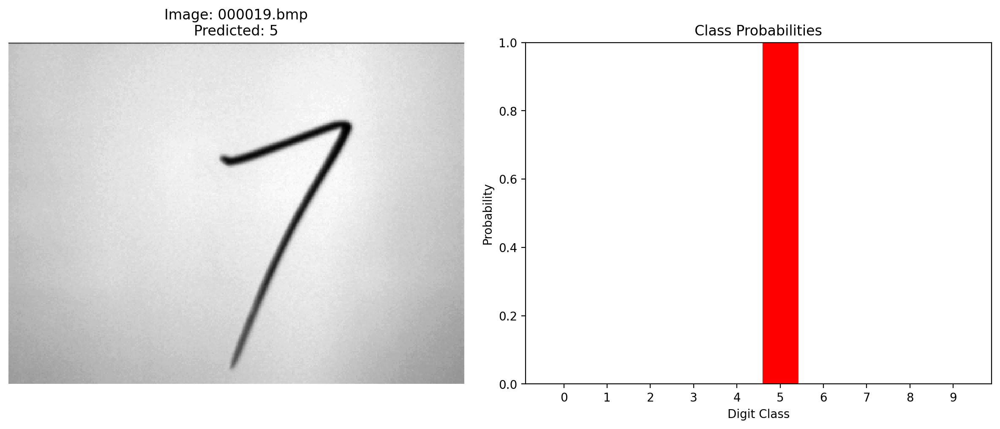


Results for 000019.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0000
  Class 4: 0.0000
  Class 5: 1.0000
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


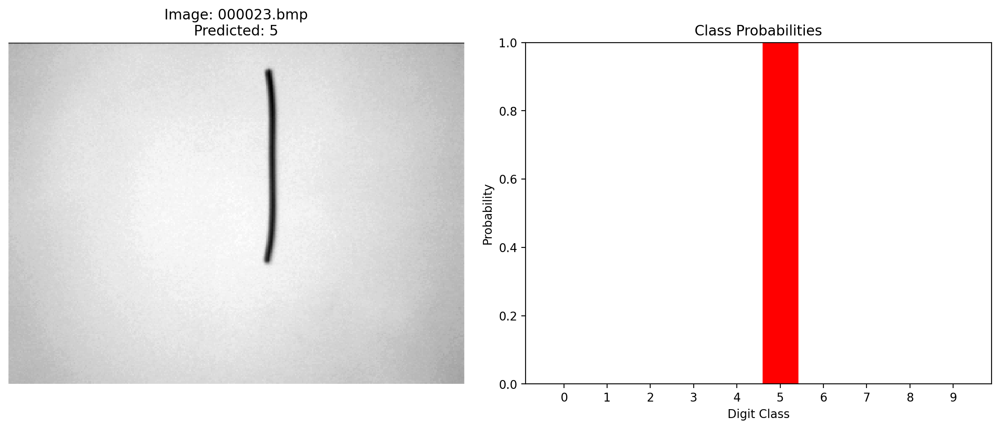


Results for 000023.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0022
  Class 4: 0.0000
  Class 5: 0.9978
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


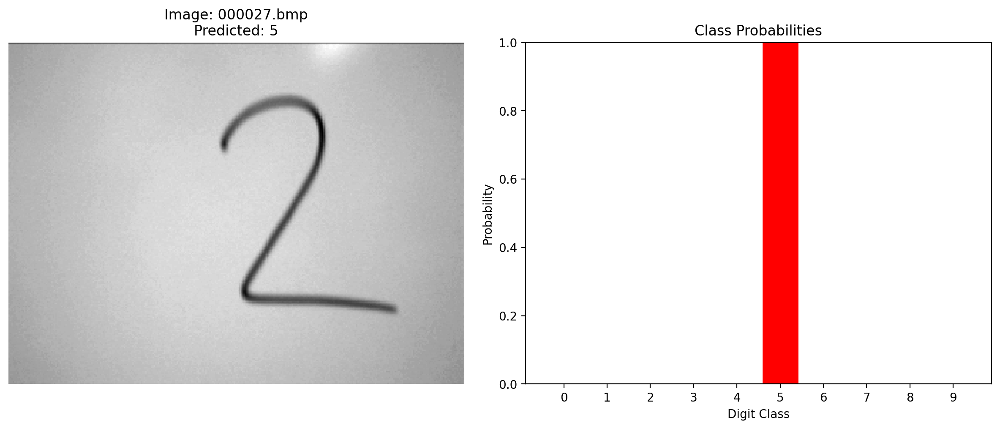


Results for 000027.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0022
  Class 4: 0.0000
  Class 5: 0.9978
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


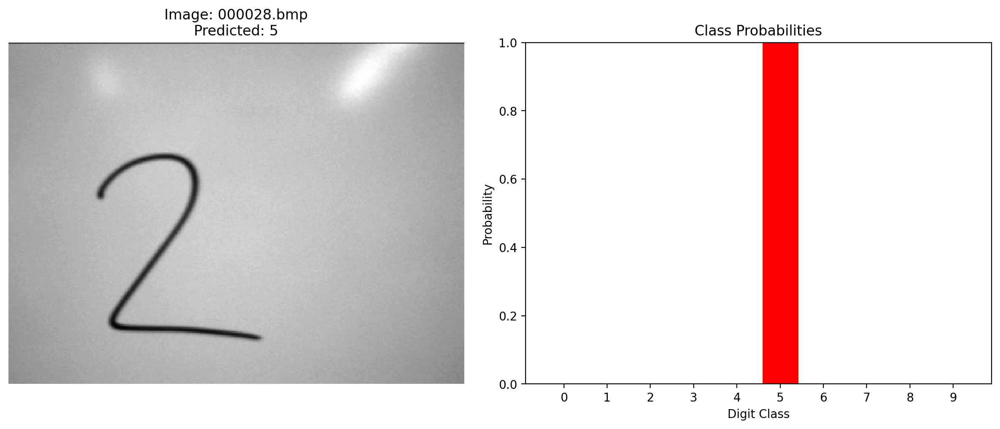


Results for 000028.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0003
  Class 4: 0.0000
  Class 5: 0.9997
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


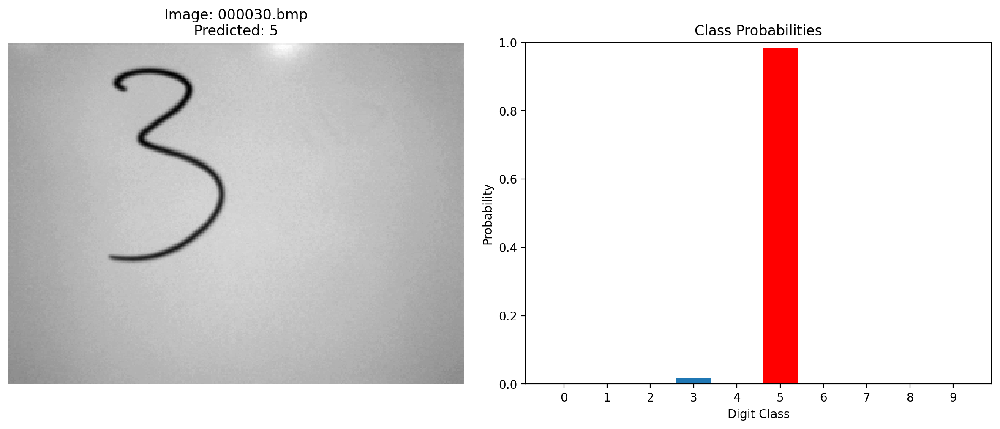


Results for 000030.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0165
  Class 4: 0.0000
  Class 5: 0.9835
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


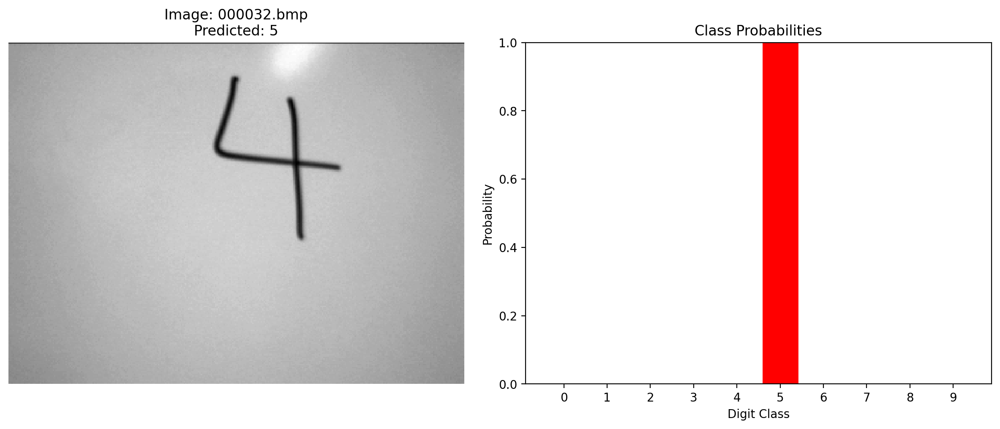


Results for 000032.bmp:
Predicted class: 5
Class probabilities:
  Class 0: 0.0000
  Class 1: 0.0000
  Class 2: 0.0000
  Class 3: 0.0001
  Class 4: 0.0000
  Class 5: 0.9999
  Class 6: 0.0000
  Class 7: 0.0000
  Class 8: 0.0000
  Class 9: 0.0000


In [59]:
# Cell to test quantized MLP on individual images

import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms
import torch

# Directory containing your test images
image_folder = "../../select_digits"

# Get all image files from the folder
image_files = [f for f in os.listdir(image_folder)
              if f.endswith(('.png', '.jpg', '.jpeg', '.bmp'))]

if not image_files:
    print(f"No image files found in {image_folder}")
else:
    print(f"Found {len(image_files)} images to process")

    # Assuming your quantized model is stored in a variable called 'quantized_model'
    # If it's not, replace this with your variable name
    model = quantized_model  # Or use model.model if you're working with the MLP_extended instance

    # Ensure model is in evaluation mode
    model.eval()

    # Define image transformation
    transform = transforms.Compose([
        transforms.Resize((28, 28)),  # Adjust to your model's expected input size
        transforms.ToTensor(),
        # Add normalization if your model was trained with it
        # transforms.Normalize((0.5,), (0.5,))
    ])

    # Process each image
    for img_file in image_files:
        img_path = os.path.join(image_folder, img_file)

        # Load and preprocess the image
        img = Image.open(img_path).convert('L')  # Convert to grayscale
        img_tensor = transform(img).unsqueeze(0)  # Add batch dimension

        # Run inference
        with torch.no_grad():
            outputs = model(img_tensor)
            log_probs = outputs
            probs = torch.exp(log_probs)
            _, predicted_class = torch.max(probs, 1)

        # Convert to numpy for visualization
        probabilities = probs.squeeze().numpy()

        # Display results
        plt.figure(figsize=(12, 5))

        # Display the image
        plt.subplot(1, 2, 1)
        plt.imshow(np.array(img), cmap='gray')
        plt.title(f"Image: {img_file}\nPredicted: {predicted_class.item()}")
        plt.axis('off')

        # Display probability distribution
        plt.subplot(1, 2, 2)
        bars = plt.bar(range(10), probabilities)
        plt.title("Class Probabilities")
        plt.xlabel("Digit Class")
        plt.ylabel("Probability")
        plt.xticks(range(10))
        plt.ylim(0, 1.0)  # Set y-axis from 0 to 1 for probabilities

        # Highlight the predicted class
        bars[predicted_class.item()].set_color('red')

        plt.tight_layout()
        plt.show()

        # Print probabilities
        print(f"\nResults for {img_file}:")
        print(f"Predicted class: {predicted_class.item()}")
        print("Class probabilities:")
        for i, prob in enumerate(probabilities):
            print(f"  Class {i}: {prob:.4f}")

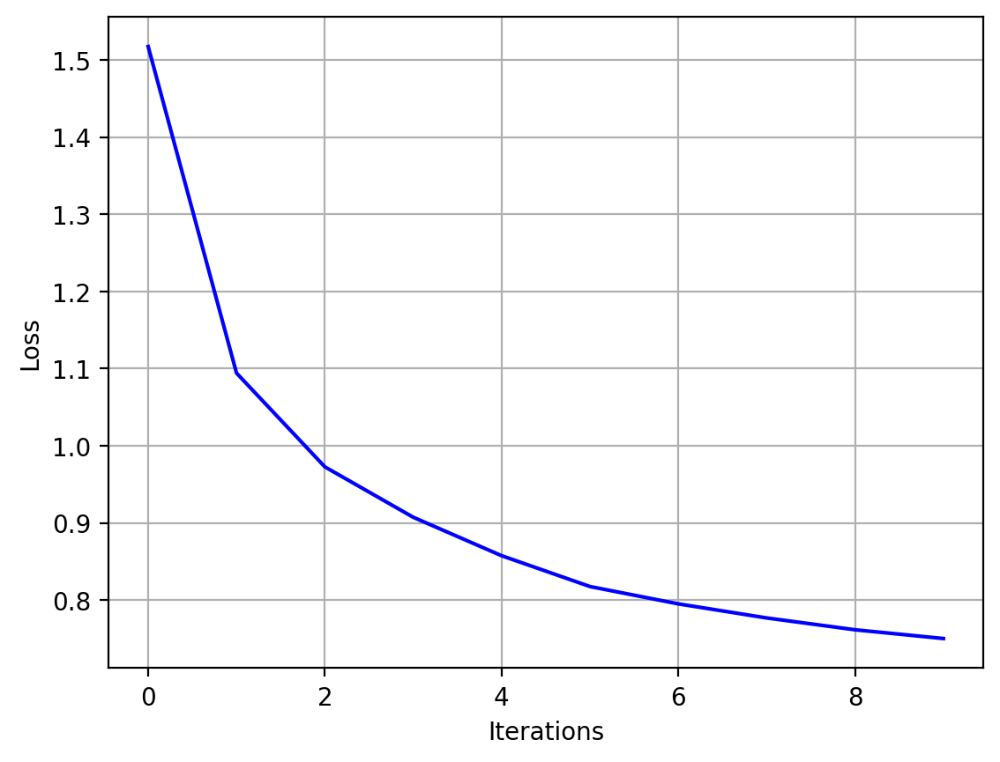

In [48]:
plt.plot(my_MLP.loss_during_training,'-b',label='Cross Entropy Loss')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.grid()

Wow! Performace is almost perfect with a naive Neural Network!!

> **Exercise:** Lets visualize the activations at the ouput of the first layer for a minibatch of test images. This will help to identify possible unused hidden units (always activated/deactivated) and correlated hidden units, e.g. redundant units. Complete the following code.

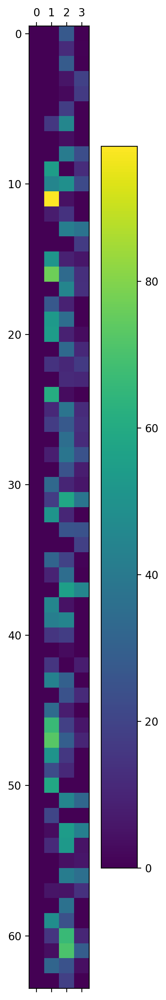

In [21]:
# First, we load a test minibatch

x_test,y_test = next(iter(testloader))

# Then, we evaluate the output of the first layer of the network for that mini-batch

activations = my_MLP.relu(my_MLP.output1(x_test.view([x_test.shape[0],-1]))).detach().numpy() # YOUR CODE HERE

# We plot the matrix using matplotlib

plt.matshow(activations)

plt.colorbar()


Based on the plot, do you think there are unsued hidden units in the hidden layer? They are characterized by units that are always active (very high values) or unactive (almost zero values). Plot the variance of the hidden units across the test mini-batch to better visualize these unactive hidden units.

There are 1 hidden units that are unactive


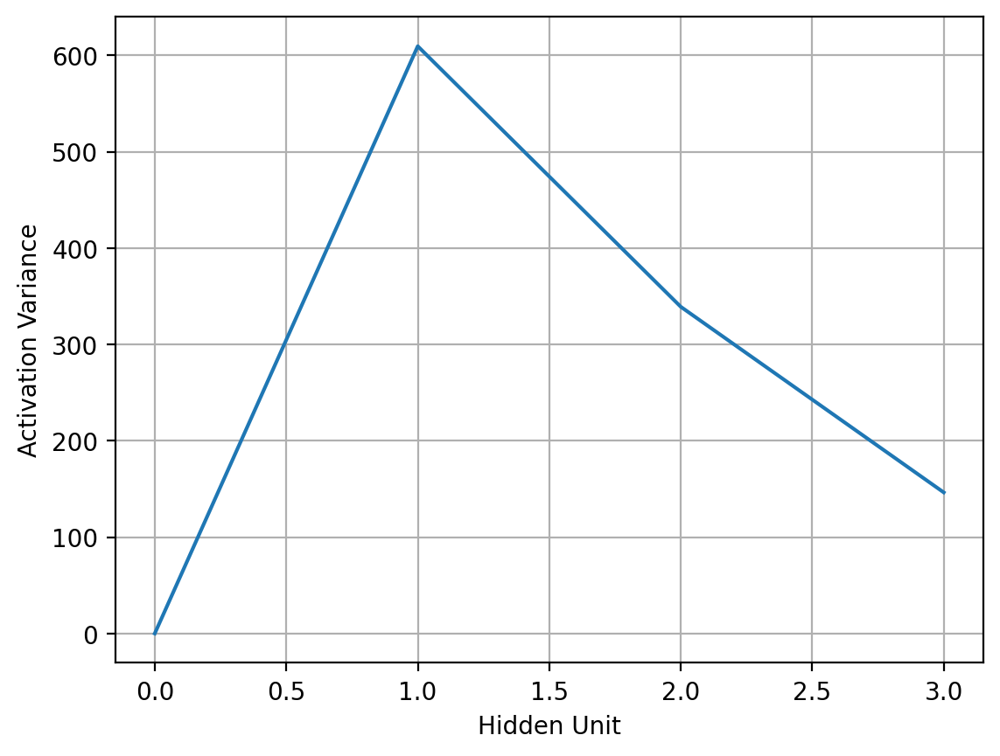

In [22]:
plt.plot(np.var(activations,0))
plt.grid()
plt.xlabel('Hidden Unit')
plt.ylabel('Activation Variance')

print("There are {0:d} hidden units that are unactive".format(np.sum(np.var(activations,0)<=0.1)))

> **Exercise**: Retrain the model reducing accordingly the dimension of the first hidden layer. For that model, repeat the analysis to the activations of both the first and the second layer.
>
>You will notice that in general, unsued activations are prominent in the first layer compared to the second one. This is in general the case for any NN, as the **loss function is more sensitive to parameter variations in the last layers**, and hence gradients are higher in magnitude. On the contrary, the **loss function is less senstive to parameter variations in the first layers** and hence only very relevant parameters are trained (they influence more in the loss function), while many others vary very little w.r.t. initialization.

In [56]:
my_MLP_red = MLP_extended(dimx=784,hidden1=75,hidden2=64,nlabels=10,epochs=10,lr=1e-3)

my_MLP_red.train(trainloader)

train_performance = my_MLP_red.eval_performance(trainloader)

test_performance = my_MLP_red.eval_performance(testloader)

print("Train Accuracy %f" %(train_performance))

print("Test Accuracy %f" %(test_performance))

ValueError: too many values to unpack (expected 2)

In the first layer, there are 32 hidden units that are unactive
In the second layer, there are 7 hidden units that are unactive


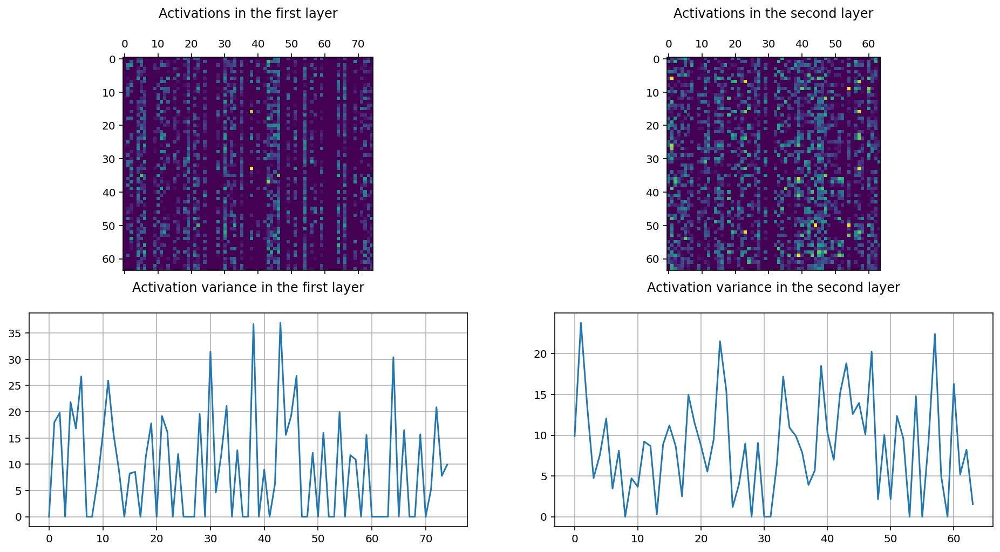

In [ ]:
activations_1 = my_MLP_red.relu(my_MLP_red.output1(x_test.view([x_test.shape[0],-1]))).detach().numpy() # YOUR CODE HERE

# Then, we evaluate the output of the first layer of the network for that mini-batch
activations_2 = my_MLP_red.relu(my_MLP_red.output2(my_MLP_red.relu(my_MLP_red.output1(x_test.view([x_test.shape[0],-1]))))).detach().numpy() # YOUR CODE HERE

fig, ax = plt.subplots(nrows=2, ncols=2,figsize=(16, 8))
im = ax[0,0].matshow(activations_1)
ax[0,0].set_title('Activations in the first layer\n')

ax[0,1].matshow(activations_2)
ax[0,1].set_title('Activations in the second layer\n')

ax[1,0].plot(np.var(activations_1,0))
ax[1,0].set_title('Activation variance in the first layer\n')
ax[1,0].grid()

ax[1,1].plot(np.var(activations_2,0))
ax[1,1].set_title('Activation variance in the second layer\n')
ax[1,1].grid()

print("In the first layer, there are {0:d} hidden units that are unactive".format(np.sum(np.var(activations_1,0)<=0.1)))

print("In the second layer, there are {0:d} hidden units that are unactive".format(np.sum(np.var(activations_2,0)<=0.1)))

> **Exercise**: Plot the histogram of the gradient of the loss function w.r.t. the parameters in the model for the first and the last layers and compare them.

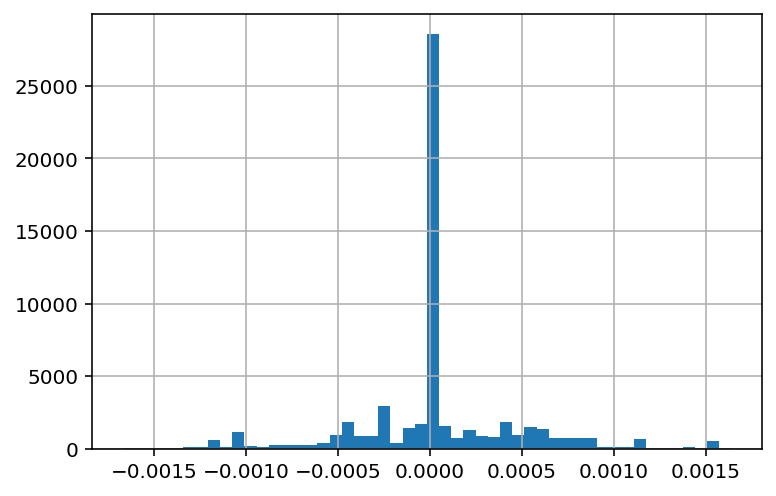

In [ ]:
# YOUR CODE HERE

plt.hist(my_MLP_red.output1.weight.grad.detach().numpy().reshape([-1,]),50)
plt.grid()



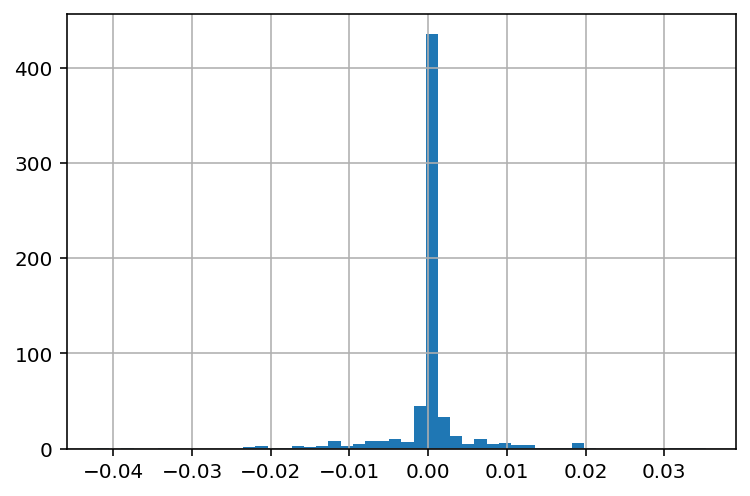

In [ ]:
plt.hist(my_MLP_red.output3.weight.grad.detach().numpy().reshape([-1,]),50)
plt.grid()

### Part IV. Saving and restoring the model

Finally, we will show you how to save and load models (i.e. values of the parameters) with PyTorch. This is important because you'll often want to load previously trained models to use in making predictions or to continue training on new data.

As you can imagine, it's impractical to train a network every time you need to use it. Instead, we can save trained networks then load them later to train more or use them for predictions.

The parameters for PyTorch networks are stored in a model's `state_dict`. We can see the state dict contains the weight and bias matrices for each of our layers.

In [ ]:
print("Our model: \n\n", my_MLP, '\n')
print("The state dict keys: \n\n", my_MLP.state_dict().keys())

Our model: 

 MLP_extended(
  (output1): Linear(in_features=784, out_features=128, bias=True)
  (output2): Linear(in_features=128, out_features=64, bias=True)
  (output3): Linear(in_features=64, out_features=10, bias=True)
  (relu): ReLU()
  (logsoftmax): LogSoftmax(dim=1)
  (criterion): NLLLoss()
) 

The state dict keys: 

 odict_keys(['output1.weight', 'output1.bias', 'output2.weight', 'output2.bias', 'output3.weight', 'output3.bias'])


The simplest thing to do is saving the state dict with `torch.save`. For example, we can save it to a file `'checkpoint.pth'`.

In [ ]:
torch.save(my_MLP.state_dict(), 'checkpoint.pth')

Then we can load the state dict with `torch.load`.

In [ ]:
state_dict = torch.load('checkpoint.pth')
print(state_dict.keys())

odict_keys(['output1.weight', 'output1.bias', 'output2.weight', 'output2.bias', 'output3.weight', 'output3.bias'])


And to load the state dict in to the network, you do `my_MLP.load_state_dict(state_dict)`.

In [ ]:
my_MLP.load_state_dict(state_dict)

<All keys matched successfully>

**Important:** `load_state_dict` will raise an error if the architecture of the network is different from the one saved in the pth file. For example, if we define the following model.

In [ ]:
my_MLP2 = MLP_extended(dimx=784,hidden1=256,hidden2=128,nlabels=10,epochs=10,lr=1e-3)

which differs from `my_MLP` in the dimension of the hidden layers, we will get an error if we call the method  `load_state_dict(state_dict)`.

> **Exercise:** Check that you get an error when trying to initialize my_MLP2 from `state_dict` using the method `load_state_dict`

In [ ]:
my_MLP2.load_state_dict(state_dict)

RuntimeError: Error(s) in loading state_dict for MLP_extended:
	size mismatch for output1.weight: copying a param with shape torch.Size([128, 784]) from checkpoint, the shape in current model is torch.Size([256, 784]).
	size mismatch for output1.bias: copying a param with shape torch.Size([128]) from checkpoint, the shape in current model is torch.Size([256]).
	size mismatch for output2.weight: copying a param with shape torch.Size([64, 128]) from checkpoint, the shape in current model is torch.Size([128, 256]).
	size mismatch for output2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([128]).
	size mismatch for output3.weight: copying a param with shape torch.Size([10, 64]) from checkpoint, the shape in current model is torch.Size([10, 128]).